In [1]:
import numpy as np
import tensorflow as tf
import os
import cv2 as cv
import cv2
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from tensorflow.keras import layers
import randaugment

In [2]:
IMAGE_PATH = 'train/train'
MASK_PATH = 'train_gt/train_gt/'

In [3]:
def load_data():
    images = [os.path.join(IMAGE_PATH, f'{x}') for x in os.listdir(IMAGE_PATH)]
    masks = [MASK_PATH+x.split("/")[-1] for x in images]
    return images, masks

In [4]:
images, masks = load_data()
#print(images)
print( masks)
print(f'Amount of images: {len(images)}')

['train_gt/train_gt/cdda5cc8a788edaeb6aa460a22abd004.jpeg', 'train_gt/train_gt/d81526eb91e2da9e6afaef7fdb2d45b2.jpeg', 'train_gt/train_gt/076135d76d0bbd4ce2a1405f7d507592.jpeg', 'train_gt/train_gt/fc01019eec999fd84e679b05f9a5e1ac.jpeg', 'train_gt/train_gt/7f23de79be0dba1f3cf29dff2864e2d8.jpeg', 'train_gt/train_gt/565c5d4340aa5f7804c34a359bbb4023.jpeg', 'train_gt/train_gt/f95b204727fdcfa030228a69b99df088.jpeg', 'train_gt/train_gt/606cb09d1fc6869d7b4193425b976973.jpeg', 'train_gt/train_gt/caf386f6e366943c17f87cf12b41e5e9.jpeg', 'train_gt/train_gt/7b8bcf15050fb9af0ef92846b60b1a38.jpeg', 'train_gt/train_gt/3a7b24423d5c7edd718176ef3065837c.jpeg', 'train_gt/train_gt/6c487ffa651b4774229fe1bce59ddf92.jpeg', 'train_gt/train_gt/6239c86a73f97dd5277dd17ba487d487.jpeg', 'train_gt/train_gt/4fc58bdb26679bff55177a34fc01019e.jpeg', 'train_gt/train_gt/abead1ae730831caf386f6e366943c17.jpeg', 'train_gt/train_gt/f93e952886d1697f8af9b550c1bce23b.jpeg', 'train_gt/train_gt/cc564cdc70626ab4ec3d46e602b296cc.jpe

In [5]:
WIDTH = 512
HEIGHT = 512

In [6]:
def read_image(image_path):
    image = cv.imread(image_path, cv.IMREAD_COLOR)
    image = cv.resize(image, (WIDTH, HEIGHT))
    image = image/255.0
    image = image.astype(np.float32)
    return image

In [7]:
def read_mask(mask_path):
    image = cv.imread(mask_path)
    
    image = cv.resize(image, (WIDTH, HEIGHT))
    """
    mask = np.zeros((HEIGHT,WIDTH))
    mask[image[:,:,1]>10]=1
    mask[image[:,:,2]>10]=2
    """
    image = cv.cvtColor(image, cv.COLOR_BGR2HSV)
    # lower boundary RED color range values; Hue (0 - 10)
    lower1 = np.array([0, 100, 20])
    upper1 = np.array([10, 255, 255])
    # upper boundary RED color range values; Hue (160 - 180)
    lower2 = np.array([160,100,20])
    upper2 = np.array([179,255,255])
    lower_mask = cv.inRange(image, lower1, upper1)
    upper_mask = cv.inRange(image, lower2, upper2)

    red_mask = lower_mask + upper_mask;
    red_mask[red_mask != 0] = 2
    
    # boundary RED color range values; Hue (36 - 70)
    green_mask = cv.inRange(image, (36, 25, 25), (70, 255,255))
    green_mask[green_mask != 0] = 1
    
    full_mask = cv.bitwise_or(red_mask, green_mask)
    full_mask = full_mask.astype(np.uint8)
    full_mask= cv2.dilate(full_mask, np.ones((5,5)), iterations=1)
    full_mask = cv2.erode(full_mask, np.ones((5,5)), iterations=1)  
    return full_mask.astype(np.uint8)

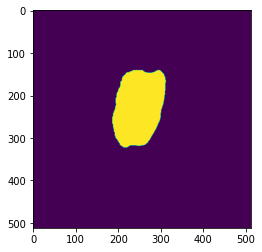

In [8]:
import time

mask=read_mask(masks[23])
time.sleep(0.3)
plt.imshow(mask*126)
plt.show()

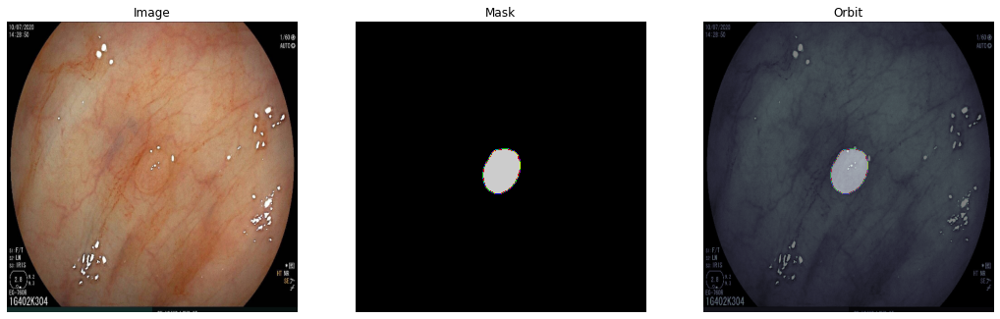

In [20]:
# Show example
import matplotlib.pyplot as plt
def show_example(image, mask):
    image = image*255 # Get back image pixels
    plt.figure(figsize=(18,15))
    plt.subplot(1,3,1)
    plt.imshow(image.astype(np.uint8)[:,:,::-1])
    plt.axis('off')
    plt.title('Image')

    plt.subplot(1,3,2)
    plt.imshow(mask, cmap='nipy_spectral')
    plt.axis('off')
    plt.title('Mask')

    plt.subplot(1,3,3)
    plt.imshow(image[...,1], cmap='bone')
    plt.imshow(mask, alpha=0.5, cmap='nipy_spectral')
    plt.axis('off')
    plt.title('Orbit')

    plt.show()
    
image, mask = read_image(images[55]), read_mask(masks[55])
show_example(image, mask)

In [10]:
# Separate image paths into training_set, validdation_set
train_x, valid_x, train_y, valid_y = train_test_split(images, masks, test_size=0.001, random_state=42)

In [11]:
train_x=images
train_y = masks

In [12]:
np.unique(mask)

array([0, 1], dtype=uint8)

In [21]:
# Convert numpy data to tensorflow data
'''
We need segent 3 classes:
    + 0 if the pixel is part of the image background (denoted by black color);
    + 1 if the pixel is part of a non-neoplastic polyp (denoted by green color);
    + 2 if the pixel is part of a neoplastic polyp (denoted by red color).
'''
import random
from imgaug import augmenters as iaa
from keras.preprocessing.image import ImageDataGenerator
sometimes = lambda aug: iaa.Sometimes(.5, aug)   
aug_pipe = iaa.Sequential(
            [      


                iaa.SomeOf((0, 3),
                    [
                       # sometimes(iaa.Superpixels(p_replace=(0, 1.0), n_segments=(20, 200))), # convert images into their superpixel representation
                        #iaa.OneOf([
                        #    iaa.GaussianBlur((0, 1.5)), # blur images with a sigma between 0 and 3.0
                        #    iaa.AverageBlur(k=(2,5)), # blur image using local means with kernel sizes between 2 and 7
                        #    iaa.MedianBlur(k=(3, 5)), # blur image using local medians with kernel sizes between 2 and 7
                        #]),
                        iaa.Sharpen(alpha=(0, 0.02), lightness=(0.95, 1.05)), # sharpen images
                        
                       iaa.AdditiveGaussianNoise(loc=0, scale=(0.0, 0.02*255), per_channel=0.5), # add gaussian noise to images
                       
                        
                        iaa.Add((-10, 10), per_channel=0.5), 
                        iaa.Multiply((0.95, 1.05), per_channel=0.5), 
                        iaa.ContrastNormalization((0.95, 1.05), per_channel=0.5), # improve or worsen the contrast
                    ],
                    random_order=True
                )
            ],
            random_order=True
        )
image_datagen_args = {
		'shear_range': 0.0,
		'zoom_range': 0.3,
		'width_shift_range': 0.25,
		'height_shift_range': 0.25,
		'rotation_range': 25,
		'horizontal_flip': True,
		'vertical_flip': True,
        'fill_mode':'constant'
	}
image_datagen = ImageDataGenerator(**image_datagen_args)
def augment(image,mask):
    image *= 255
    image = image.astype(np.uint8)
    if random.random()<0.5:
        seed = random.randint(0,100000)
        params = image_datagen.get_random_transform(image.shape,seed = seed)
        image = image_datagen.apply_transform(image, params)
        params = image_datagen.get_random_transform(mask.shape,seed = seed)
        mask = image_datagen.apply_transform(np.expand_dims(mask,-1), params)[:,:,0]
    if random.random()<0.5:
        image = aug_pipe.augment_image(np.array(image).astype(np.uint8)) 
    image = image/255.
    return image.astype(np.float32),mask
def randaug(image,mask):
    image *= 255
    image = image.astype(np.uint8)
    if random.random() < 0.5:
        n= random.randint(3,5)
        m= 10
        
        image,mask = randaugment.randaugment(image,mask, n, m)
    image=image/255.
     
    return image.astype(np.float32)    ,mask
    
        
def convert2TfDataset(x, y, batch_size=8,phase="val"):
    def preprocess(image_path, mask_path,phase=phase):
        def f(image_path, mask_path,phase=phase):
            image_path = image_path.decode()
            mask_path = mask_path.decode()
            image = read_image(image_path)
            mask = np.expand_dims(read_mask(masks[i]),-1)#read_mask(mask_path)#
            if phase == "train" :
              image,mask = randaug(image,np.concatenate([mask,mask,mask],axis=-1))#
              #image,mask = augment(image,mask)
            return image, mask[:,:,0]

        image, mask = tf.numpy_function(f, [image_path, mask_path], [tf.float32, tf.uint8])
        mask = tf.one_hot(mask, 3, dtype=tf.uint8)
        image.set_shape([HEIGHT, WIDTH, 3])
        mask.set_shape([HEIGHT, WIDTH, 3])
        return image, mask

    dataset = tf.data.Dataset.from_tensor_slices((x, y))
    dataset = dataset.shuffle(buffer_size=1000)
    dataset = dataset.map(preprocess)
    dataset = dataset.batch(batch_size)
    dataset = dataset.repeat()
    dataset = dataset.prefetch(2)
    return dataset

train/train/2d95e6c487ffa651b4774229fe1bce59.jpeg
(512, 512, 3)


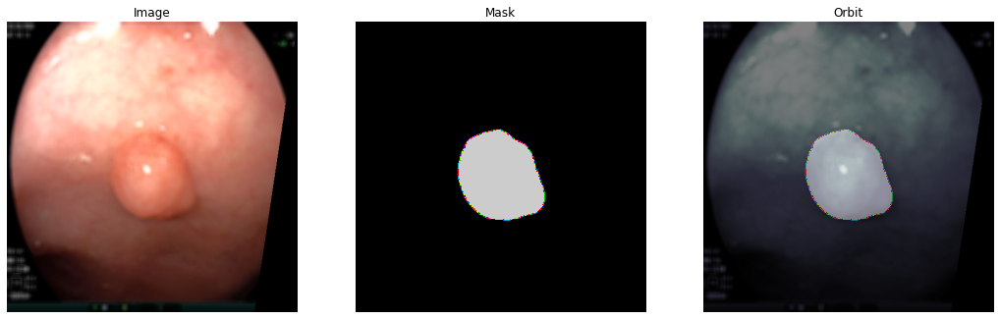

In [43]:
i = random.randint(0,999)
print(images[i])
image = read_image(images[i])
mask = np.expand_dims(read_mask(masks[i]),-1)
print(image.shape)
image,mask = randaug(image,np.concatenate([mask,mask,mask],axis=-1))#augment(image,mask )
show_example(image, mask[...,0])

In [44]:
print(f'Training: {len(train_x)} ')#- Validation: {len(valid_x)}')

Training: 1000 


In [45]:
train_dataset = convert2TfDataset(train_x, train_y, 16)
train_dataset

2021-12-24 17:21:44.857034: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-12-24 17:21:44.861335: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-12-24 17:21:44.861686: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-12-24 17:21:44.862476: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags

<PrefetchDataset shapes: ((None, 512, 512, 3), (None, 512, 512, 3)), types: (tf.float32, tf.uint8)>

# U-Net Pre-train MobinetV2

In [46]:
import os
import tensorflow as tf
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
from tensorflow.keras.layers import Input,Dropout,UpSampling2D, Conv2D, Conv2DTranspose, BatchNormalization, Activation, MaxPool2D, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.applications import MobileNetV2, efficientnet
"""
model=efficientnet.EfficientNetB0(
    include_top=False, weights='imagenet', input_tensor=None,
    input_shape=(512,512,3),)
model.summary()

"""
#from tfkeras import EfficientNetB0, EfficientNetB1, EfficientNetB2

"\nmodel=efficientnet.EfficientNetB0(\n    include_top=False, weights='imagenet', input_tensor=None,\n    input_shape=(512,512,3),)\nmodel.summary()\n\n"

In [47]:
def conv_block(input, num_filters):
    x = Conv2D(filters=num_filters, kernel_size=3, padding='same')(input)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    """
    x = Conv2D(filters=num_filters, kernel_size=3, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    """
    return x

def contracting_block(input, num_filters):
    x = conv_block(input, num_filters)
    p = MaxPool2D(pool_size=(2,2), strides=2)(x)
    return x, p

def expansive_block(input, skip_features, num_filters):
    x = UpSampling2D(2)(input)#Conv2DTranspose(num_filters, (2,2), strides=2, padding='same')(input)
    x = Concatenate()([x, skip_features])
    x = conv_block(x, num_filters)
    return x

In [48]:

MOMENTUM = 0.997
EPSILON = 1e-4
from functools import reduce
from tensorflow import keras
def SeparableConvBlock(num_channels, kernel_size, strides, name, freeze_bn=False):
    f1 = layers.SeparableConv2D(num_channels, kernel_size=kernel_size, strides=strides, padding='same',
                                use_bias=True, name=f'{name}/conv')
    f2 = layers.BatchNormalization(momentum=MOMENTUM, epsilon=EPSILON, name=f'{name}/bn')
    # f2 = BatchNormalization(freeze=freeze_bn, name=f'{name}/bn')
    return reduce(lambda f, g: lambda *args, **kwargs: g(f(*args, **kwargs)), (f1, f2))


def ConvBlock(num_channels, kernel_size, strides, name, freeze_bn=False):
    f1 = layers.Conv2D(num_channels, kernel_size=kernel_size, strides=strides, padding='same',
                       use_bias=True, name='{}_conv'.format(name))
    f2 = layers.BatchNormalization(momentum=MOMENTUM, epsilon=EPSILON, name='{}_bn'.format(name))
    # f2 = BatchNormalization(freeze=freeze_bn, name='{}_bn'.format(name))
    f3 = layers.ReLU(name='{}_relu'.format(name))
    return reduce(lambda f, g: lambda *args, **kwargs: g(f(*args, **kwargs)), (f1, f2, f3))
def build_wBiFPN(features, num_channels, id, freeze_bn=False):
    if id == 0:
        _, _, C3, C4, C5 = features
        P3_in = C3
        P4_in = C4
        P5_in = C5
        P6_in = layers.Conv2D(num_channels, kernel_size=1, padding='same', name='resample_p6/conv2d')(C5)
        P6_in = layers.BatchNormalization(momentum=MOMENTUM, epsilon=EPSILON, name='resample_p6/bn')(P6_in)
        # P6_in = BatchNormalization(freeze=freeze_bn, name='resample_p6/bn')(P6_in)
        P6_in = layers.MaxPooling2D(pool_size=3, strides=2, padding='same', name='resample_p6/maxpool')(P6_in)
        P7_in = layers.MaxPooling2D(pool_size=3, strides=2, padding='same', name='resample_p7/maxpool')(P6_in)
        P7_U = layers.UpSampling2D()(P7_in)
        P6_td = wBiFPNAdd(name=f'fpn_cells/cell_{id}/fnode0/add')([P6_in, P7_U])
        P6_td = layers.Activation(lambda x: tf.nn.swish(x))(P6_td)
        P6_td = SeparableConvBlock(num_channels=num_channels, kernel_size=3, strides=1,
                                   name=f'fpn_cells/cell_{id}/fnode0/op_after_combine5')(P6_td)
        P5_in_1 = layers.Conv2D(num_channels, kernel_size=1, padding='same',
                                name=f'fpn_cells/cell_{id}/fnode1/resample_0_2_6/conv2d')(P5_in)
        P5_in_1 = layers.BatchNormalization(momentum=MOMENTUM, epsilon=EPSILON,
                                            name=f'fpn_cells/cell_{id}/fnode1/resample_0_2_6/bn')(P5_in_1)
        # P5_in_1 = BatchNormalization(freeze=freeze_bn, name=f'fpn_cells/cell_{id}/fnode1/resample_0_2_6/bn')(P5_in_1)
        P6_U = layers.UpSampling2D()(P6_td)
        P5_td = wBiFPNAdd(name=f'fpn_cells/cell_{id}/fnode1/add')([P5_in_1, P6_U])
        P5_td = layers.Activation(lambda x: tf.nn.swish(x))(P5_td)
        P5_td = SeparableConvBlock(num_channels=num_channels, kernel_size=3, strides=1,
                                   name=f'fpn_cells/cell_{id}/fnode1/op_after_combine6')(P5_td)
        P4_in_1 = layers.Conv2D(num_channels, kernel_size=1, padding='same',
                                name=f'fpn_cells/cell_{id}/fnode2/resample_0_1_7/conv2d')(P4_in)
        P4_in_1 = layers.BatchNormalization(momentum=MOMENTUM, epsilon=EPSILON,
                                            name=f'fpn_cells/cell_{id}/fnode2/resample_0_1_7/bn')(P4_in_1)
        # P4_in_1 = BatchNormalization(freeze=freeze_bn, name=f'fpn_cells/cell_{id}/fnode2/resample_0_1_7/bn')(P4_in_1)
        P5_U = layers.UpSampling2D()(P5_td)
        P4_td = wBiFPNAdd(name=f'fpn_cells/cell_{id}/fnode2/add')([P4_in_1, P5_U])
        P4_td = layers.Activation(lambda x: tf.nn.swish(x))(P4_td)
        P4_td = SeparableConvBlock(num_channels=num_channels, kernel_size=3, strides=1,
                                   name=f'fpn_cells/cell_{id}/fnode2/op_after_combine7')(P4_td)
        P3_in = layers.Conv2D(num_channels, kernel_size=1, padding='same',
                              name=f'fpn_cells/cell_{id}/fnode3/resample_0_0_8/conv2d')(P3_in)
        P3_in = layers.BatchNormalization(momentum=MOMENTUM, epsilon=EPSILON,
                                          name=f'fpn_cells/cell_{id}/fnode3/resample_0_0_8/bn')(P3_in)
        # P3_in = BatchNormalization(freeze=freeze_bn, name=f'fpn_cells/cell_{id}/fnode3/resample_0_0_8/bn')(P3_in)
        P4_U = layers.UpSampling2D()(P4_td)
        P3_out = wBiFPNAdd(name=f'fpn_cells/cell_{id}/fnode3/add')([P3_in, P4_U])
        P3_out = layers.Activation(lambda x: tf.nn.swish(x))(P3_out)
        P3_out = SeparableConvBlock(num_channels=num_channels, kernel_size=3, strides=1,
                                    name=f'fpn_cells/cell_{id}/fnode3/op_after_combine8')(P3_out)
        P4_in_2 = layers.Conv2D(num_channels, kernel_size=1, padding='same',
                                name=f'fpn_cells/cell_{id}/fnode4/resample_0_1_9/conv2d')(P4_in)
        P4_in_2 = layers.BatchNormalization(momentum=MOMENTUM, epsilon=EPSILON,
                                            name=f'fpn_cells/cell_{id}/fnode4/resample_0_1_9/bn')(P4_in_2)
        # P4_in_2 = BatchNormalization(freeze=freeze_bn, name=f'fpn_cells/cell_{id}/fnode4/resample_0_1_9/bn')(P4_in_2)
        P3_D = layers.MaxPooling2D(pool_size=3, strides=2, padding='same')(P3_out)
        P4_out = wBiFPNAdd(name=f'fpn_cells/cell_{id}/fnode4/add')([P4_in_2, P4_td, P3_D])
        P4_out = layers.Activation(lambda x: tf.nn.swish(x))(P4_out)
        P4_out = SeparableConvBlock(num_channels=num_channels, kernel_size=3, strides=1,
                                    name=f'fpn_cells/cell_{id}/fnode4/op_after_combine9')(P4_out)

        P5_in_2 = layers.Conv2D(num_channels, kernel_size=1, padding='same',
                                name=f'fpn_cells/cell_{id}/fnode5/resample_0_2_10/conv2d')(P5_in)
        P5_in_2 = layers.BatchNormalization(momentum=MOMENTUM, epsilon=EPSILON,
                                            name=f'fpn_cells/cell_{id}/fnode5/resample_0_2_10/bn')(P5_in_2)
        # P5_in_2 = BatchNormalization(freeze=freeze_bn, name=f'fpn_cells/cell_{id}/fnode5/resample_0_2_10/bn')(P5_in_2)
        P4_D = layers.MaxPooling2D(pool_size=3, strides=2, padding='same')(P4_out)
        P5_out = wBiFPNAdd(name=f'fpn_cells/cell_{id}/fnode5/add')([P5_in_2, P5_td, P4_D])
        P5_out = layers.Activation(lambda x: tf.nn.swish(x))(P5_out)
        P5_out = SeparableConvBlock(num_channels=num_channels, kernel_size=3, strides=1,
                                    name=f'fpn_cells/cell_{id}/fnode5/op_after_combine10')(P5_out)

        P5_D = layers.MaxPooling2D(pool_size=3, strides=2, padding='same')(P5_out)
        P6_out = wBiFPNAdd(name=f'fpn_cells/cell_{id}/fnode6/add')([P6_in, P6_td, P5_D])
        P6_out = layers.Activation(lambda x: tf.nn.swish(x))(P6_out)
        P6_out = SeparableConvBlock(num_channels=num_channels, kernel_size=3, strides=1,
                                    name=f'fpn_cells/cell_{id}/fnode6/op_after_combine11')(P6_out)

        P6_D = layers.MaxPooling2D(pool_size=3, strides=2, padding='same')(P6_out)
        P7_out = wBiFPNAdd(name=f'fpn_cells/cell_{id}/fnode7/add')([P7_in, P6_D])
        P7_out = layers.Activation(lambda x: tf.nn.swish(x))(P7_out)
        P7_out = SeparableConvBlock(num_channels=num_channels, kernel_size=3, strides=1,
                                    name=f'fpn_cells/cell_{id}/fnode7/op_after_combine12')(P7_out)

    else:
        P3_in, P4_in, P5_in, P6_in, P7_in = features
        P7_U = layers.UpSampling2D()(P7_in)
        P6_td = wBiFPNAdd(name=f'fpn_cells/cell_{id}/fnode0/add')([P6_in, P7_U])
        P6_td = layers.Activation(lambda x: tf.nn.swish(x))(P6_td)
        P6_td = SeparableConvBlock(num_channels=num_channels, kernel_size=3, strides=1,
                                   name=f'fpn_cells/cell_{id}/fnode0/op_after_combine5')(P6_td)
        P6_U = layers.UpSampling2D()(P6_td)
        P5_td = wBiFPNAdd(name=f'fpn_cells/cell_{id}/fnode1/add')([P5_in, P6_U])
        P5_td = layers.Activation(lambda x: tf.nn.swish(x))(P5_td)
        P5_td = SeparableConvBlock(num_channels=num_channels, kernel_size=3, strides=1,
                                   name=f'fpn_cells/cell_{id}/fnode1/op_after_combine6')(P5_td)
        P5_U = layers.UpSampling2D()(P5_td)
        P4_td = wBiFPNAdd(name=f'fpn_cells/cell_{id}/fnode2/add')([P4_in, P5_U])
        P4_td = layers.Activation(lambda x: tf.nn.swish(x))(P4_td)
        P4_td = SeparableConvBlock(num_channels=num_channels, kernel_size=3, strides=1,
                                   name=f'fpn_cells/cell_{id}/fnode2/op_after_combine7')(P4_td)
        P4_U = layers.UpSampling2D()(P4_td)
        P3_out = wBiFPNAdd(name=f'fpn_cells/cell_{id}/fnode3/add')([P3_in, P4_U])
        P3_out = layers.Activation(lambda x: tf.nn.swish(x))(P3_out)
        P3_out = SeparableConvBlock(num_channels=num_channels, kernel_size=3, strides=1,
                                    name=f'fpn_cells/cell_{id}/fnode3/op_after_combine8')(P3_out)
        P3_D = layers.MaxPooling2D(pool_size=3, strides=2, padding='same')(P3_out)
        P4_out = wBiFPNAdd(name=f'fpn_cells/cell_{id}/fnode4/add')([P4_in, P4_td, P3_D])
        P4_out = layers.Activation(lambda x: tf.nn.swish(x))(P4_out)
        P4_out = SeparableConvBlock(num_channels=num_channels, kernel_size=3, strides=1,
                                    name=f'fpn_cells/cell_{id}/fnode4/op_after_combine9')(P4_out)

        P4_D = layers.MaxPooling2D(pool_size=3, strides=2, padding='same')(P4_out)
        P5_out = wBiFPNAdd(name=f'fpn_cells/cell_{id}/fnode5/add')([P5_in, P5_td, P4_D])
        P5_out = layers.Activation(lambda x: tf.nn.swish(x))(P5_out)
        P5_out = SeparableConvBlock(num_channels=num_channels, kernel_size=3, strides=1,
                                    name=f'fpn_cells/cell_{id}/fnode5/op_after_combine10')(P5_out)

        P5_D = layers.MaxPooling2D(pool_size=3, strides=2, padding='same')(P5_out)
        P6_out = wBiFPNAdd(name=f'fpn_cells/cell_{id}/fnode6/add')([P6_in, P6_td, P5_D])
        P6_out = layers.Activation(lambda x: tf.nn.swish(x))(P6_out)
        P6_out = SeparableConvBlock(num_channels=num_channels, kernel_size=3, strides=1,
                                    name=f'fpn_cells/cell_{id}/fnode6/op_after_combine11')(P6_out)

        P6_D = layers.MaxPooling2D(pool_size=3, strides=2, padding='same')(P6_out)
        P7_out = wBiFPNAdd(name=f'fpn_cells/cell_{id}/fnode7/add')([P7_in, P6_D])
        P7_out = layers.Activation(lambda x: tf.nn.swish(x))(P7_out)
        P7_out = SeparableConvBlock(num_channels=num_channels, kernel_size=3, strides=1,
                                    name=f'fpn_cells/cell_{id}/fnode7/op_after_combine12')(P7_out)
    return P3_out, P4_td, P5_td, P6_td, P7_out
class wBiFPNAdd(keras.layers.Layer):
    def __init__(self, epsilon=1e-4, **kwargs):
        super(wBiFPNAdd, self).__init__(**kwargs)
        self.epsilon = epsilon

    def build(self, input_shape):
        num_in = len(input_shape)
        self.w = self.add_weight(name=self.name,
                                 shape=(num_in,),
                                 initializer=keras.initializers.constant(1 / num_in),
                                 trainable=True,
                                 dtype=tf.float32)

    def call(self, inputs, **kwargs):
        w = keras.activations.relu(self.w)
        x = tf.reduce_sum([w[i] * inputs[i] for i in range(len(inputs))], axis=0)
        x = x / (tf.reduce_sum(w) + self.epsilon)
        return x

    def compute_output_shape(self, input_shape):
        return input_shape[0]

    def get_config(self):
        config = super(wBiFPNAdd, self).get_config()
        config.update({
            'epsilon': self.epsilon
        })
        return config

In [49]:
def build_model(shape=(HEIGHT,WIDTH,3)):
    """ INPUT """
    inputs = Input(shape=shape, name='input')

    """ BACKBONE MobileNetV2 """
    encoder = efficientnet.EfficientNetB4(include_top=False, weights='imagenet', input_tensor=inputs)

    """ Encoder """
    s1 = encoder.get_layer('input').output 
    s2 = encoder.get_layer('block1b_add').output
    s3 = encoder.get_layer('block2c_add').output        
    s4 = encoder.get_layer('block3c_add').output
    s5 = encoder.get_layer('block5d_add').output
    s6 = encoder.get_layer('top_activation').output
    features = [s2,s3,s4,s5,s6]
    w_bifpns = [64, 88, 112, 160, 224, 288, 384]
    for i in range(6): #b2 b3 b4 b5 old 6
        features = build_wBiFPN(features, 160, i, freeze_bn=False)
    d1 = features[0]    
    d2 = expansive_block(d1, s3, 256)
    d3 = expansive_block(d2, s2, 128)
        
    d2_ = Conv2DTranspose(strides=2,padding="same",filters=128,kernel_size=1)(d3)
    d2_ = BatchNormalization()(d2_)
    d4 = Activation('relu')(d2_)
  #  d4 = expansive_block(d3, d2_, 64)
    d4 = Conv2D(strides=1,padding="same",filters=64,kernel_size=3)(d4)
    d4 = BatchNormalization()(d4)
    d4 = Activation('relu')(d4)
    d4 = Dropout(0.2)(d4)
    """ Output """
    outputs = Conv2D(3, (1,1), 1, 'same', activation='softmax')(d4)

   
    return Model(inputs, outputs, name='MobilenetV2_Unet')

In [50]:
mobilenetv2_unet = build_model()

In [51]:
mobilenetv2_unet.summary()

Model: "MobilenetV2_Unet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input (InputLayer)              [(None, 512, 512, 3) 0                                            
__________________________________________________________________________________________________
rescaling (Rescaling)           (None, 512, 512, 3)  0           input[0][0]                      
__________________________________________________________________________________________________
normalization (Normalization)   (None, 512, 512, 3)  7           rescaling[0][0]                  
__________________________________________________________________________________________________
stem_conv_pad (ZeroPadding2D)   (None, 513, 513, 3)  0           normalization[0][0]              
___________________________________________________________________________________

In [52]:

def dice_coeff(y_true, y_pred, smooth=1):
    intersection = tf.reduce_sum(tf.abs(y_true * y_pred), axis=-1)
    return (2. * intersection + smooth) / (tf.reduce_sum(y_true,-1) + tf.reduce_sum(y_pred,-1) + smooth)


def dice_loss(y_true, y_pred):
    y_true = tf.cast(y_true,tf.float32)
    y_pred = tf.cast(y_pred,tf.float32)                                    
    return 1-dice_coeff(y_true, y_pred)
import focal_loss
def focalloss(y_true, y_pred):
    y_true = tf.argmax(y_true,axis=-1)
    loss = focal_loss.sparse_categorical_focal_loss(y_true, y_pred,gamma=1 ,from_logits =False)
    return loss

def hybrid(y_true, y_pred):
    cce = tf.keras.losses.CategoricalCrossentropy()
    return cce(y_true, y_pred)+dice_loss(y_true, y_pred)
def acc(y_true, y_pred):
    y_true = tf.cast(y_true,tf.float32)[...,1:]
    total = tf.reduce_sum(y_true)
    y_pred = tf.cast(y_pred,tf.float32)[...,1:]
    y_true = tf.argmax(y_true,axis = -1)
    y_pred = tf.argmax(y_pred,axis = -1)
    return tf.reduce_sum( tf.cast(y_true==y_pred,tf.float32))/total

In [53]:
cosine = tf.keras.optimizers.schedules.CosineDecay(
     initial_learning_rate=1e-4, decay_steps=15000, alpha=1e-7
)
mobilenetv2_unet.compile(loss="categorical_crossentropy",#hybrid,#focalloss,#
             optimizer=tf.keras.optimizers.Adam(learning_rate = cosine,),
                         
             metrics=[
                 tf.keras.metrics.Precision(),
                 tf.keras.metrics.Recall(),
                 acc,
                 tf.keras.metrics.MeanIoU(num_classes=3)
             ])

In [54]:
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping

callbacks = [
    ModelCheckpoint('mobinetv2_unet.h5', verbose=1,)# save_best_model=True,monitor="val_acc",mode  = "max"),

   # EarlyStopping(monitor='val_loss', patience=5, verbose=1)
]

In [55]:
train_dataset = convert2TfDataset(train_x, train_y, 3,"train")
valid_dataset = convert2TfDataset(valid_x, valid_y, 3)

train_step = len(train_x)//3
if len(train_x) % 3 != 0:
    train_step += 1

valid_step = len(valid_x)//3
if len(valid_x) % 3 != 0:
    valid_step += 1
##train_step = 100 
print(f'{train_step} - {valid_step}')

334 - 1


In [56]:
H = mobilenetv2_unet.fit(train_dataset,
             validation_data=None,
             steps_per_epoch=train_step,
             validation_steps=valid_step,
             epochs=50,
             callbacks=callbacks)

2021-12-24 17:21:54.248472: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


Epoch 1/50


2021-12-24 17:22:12.558309: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8201


334/334 [==============================] - 139s 350ms/step - loss: 0.2529 - precision: 0.9722 - recall: 0.9192 - acc: 3.7034 - mean_io_u: 0.3340

Epoch 00001: saving model to mobinetv2_unet.h5


/home/s/anaconda3/envs/tf2.6/lib/python3.8/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


Epoch 2/50
334/334 [==============================] - 116s 348ms/step - loss: 0.0767 - precision: 0.9918 - recall: 0.9906 - acc: 3.8801 - mean_io_u: 0.3348

Epoch 00002: saving model to mobinetv2_unet.h5
Epoch 3/50
334/334 [==============================] - 115s 345ms/step - loss: 0.0484 - precision: 0.9929 - recall: 0.9923 - acc: 3.9863 - mean_io_u: 0.3355

Epoch 00003: saving model to mobinetv2_unet.h5
Epoch 4/50
334/334 [==============================] - 117s 349ms/step - loss: 0.0362 - precision: 0.9934 - recall: 0.9928 - acc: 4.2300 - mean_io_u: 0.3359

Epoch 00004: saving model to mobinetv2_unet.h5
Epoch 5/50
334/334 [==============================] - 117s 349ms/step - loss: 0.0295 - precision: 0.9935 - recall: 0.9931 - acc: 4.4797 - mean_io_u: 0.3358

Epoch 00005: saving model to mobinetv2_unet.h5
Epoch 6/50
308/334 [==========================>...] - ETA: 9s - loss: 0.0224 - precision: 0.9948 - recall: 0.9945 - acc: 4.7344 - mean_io_u: 0.3362

2021-12-24 17:33:55.553254: W tensorflow/core/common_runtime/bfc_allocator.cc:272] Allocator (GPU_0_bfc) ran out of memory trying to allocate 1.27GiB with freed_by_count=0. The caller indicates that this is not a failure, but may mean that there could be performance gains if more memory were available.


334/334 [==============================] - 116s 348ms/step - loss: 0.0220 - precision: 0.9949 - recall: 0.9946 - acc: 4.7346 - mean_io_u: 0.3362

Epoch 00006: saving model to mobinetv2_unet.h5
Epoch 7/50
334/334 [==============================] - 116s 348ms/step - loss: 0.0206 - precision: 0.9945 - recall: 0.9943 - acc: 4.7683 - mean_io_u: 0.3364

Epoch 00007: saving model to mobinetv2_unet.h5
Epoch 8/50
334/334 [==============================] - 117s 349ms/step - loss: 0.0159 - precision: 0.9957 - recall: 0.9954 - acc: 4.6123 - mean_io_u: 0.3366

Epoch 00008: saving model to mobinetv2_unet.h5
Epoch 9/50
334/334 [==============================] - 115s 345ms/step - loss: 0.0149 - precision: 0.9957 - recall: 0.9955 - acc: 4.5211 - mean_io_u: 0.3368

Epoch 00009: saving model to mobinetv2_unet.h5
Epoch 10/50
334/334 [==============================] - 115s 345ms/step - loss: 0.0139 - precision: 0.9959 - recall: 0.9957 - acc: 4.4333 - mean_io_u: 0.3371

Epoch 00010: saving model to mobinetv

334/334 [==============================] - 115s 346ms/step - loss: 0.0041 - precision: 0.9986 - recall: 0.9984 - acc: 3.2351 - mean_io_u: 0.3460

Epoch 00046: saving model to mobinetv2_unet.h5
Epoch 47/50
334/334 [==============================] - 115s 345ms/step - loss: 0.0043 - precision: 0.9986 - recall: 0.9984 - acc: 3.2326 - mean_io_u: 0.3461

Epoch 00047: saving model to mobinetv2_unet.h5
Epoch 48/50
334/334 [==============================] - 116s 346ms/step - loss: 0.0037 - precision: 0.9988 - recall: 0.9986 - acc: 3.2354 - mean_io_u: 0.3460

Epoch 00048: saving model to mobinetv2_unet.h5
Epoch 49/50
334/334 [==============================] - 115s 345ms/step - loss: 0.0039 - precision: 0.9987 - recall: 0.9985 - acc: 3.2335 - mean_io_u: 0.3461

Epoch 00049: saving model to mobinetv2_unet.h5
Epoch 50/50
334/334 [==============================] - 116s 346ms/step - loss: 0.0035 - precision: 0.9988 - recall: 0.9987 - acc: 3.2338 - mean_io_u: 0.3461

Epoch 00050: saving model to mobin

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


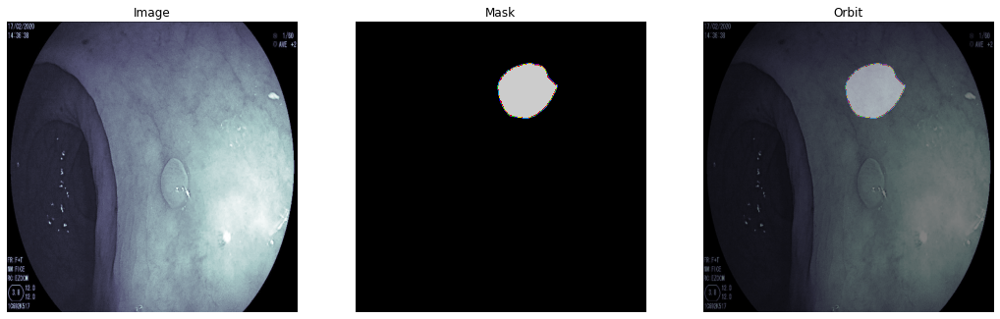

In [69]:
test_img = read_image('test/test/02fa602bb3c7abacdbd7e6afd56ea7bc.jpeg')
p = mobilenetv2_unet.predict(np.expand_dims(test_img, axis=0))[0]
p = np.argmax(p, axis=-1)

print(p)
show_example(test_img, p)

In [136]:
import glob
import cv2
kernel = np.ones((71,71), np.uint8)
files = glob.glob("test/test/*.jp*")
#mobilenetv2_unet.load_weights("b4-wbifpn-81.11.h5")
for file in files:
  img = cv2.imread(file)
  h,w,_ = img.shape
  test_img = read_image(file)
  p = mobilenetv2_unet.predict(np.expand_dims(test_img, axis=0))[0]
  #print(p.shape)
  p = np.argmax(p, axis=-1)
 # print(p)
  p = to_categorical(p, num_classes=3).astype(np.uint8)
  #print(print(p.shape))
  res = p.copy().astype(np.uint8)*255
  res = cv2.resize(res,(w,h),interpolation=cv2.INTER_NEAREST)
  #res[:,:,0]=0
  res[:,:,0] = 0 #cv2.dilate(res[:,:,0], kernel, iterations=1)
  res[:,:,1] = cv2.dilate(res[:,:,1], kernel, iterations=1)
  res[:,:,1] = cv2.erode(res[:,:,1], kernel, iterations=1)  
  res[:,:,2] = cv2.dilate(res[:,:,2], kernel, iterations=1)
  res[:,:,2] = cv2.erode(res[:,:,2], kernel, iterations=1)    
  #print(np.max(res),np.min(res))
  #res = res[:,:,[1,0,2]]
  #res[p==1]=2
  #res[p==2]=1
  cv2.imwrite("result/"+file.split("/")[-1].split(".")[0]+".png",(res/255).astype(np.uint8))

NameError: name 'to_categorical' is not defined

In [51]:
## produce result for fusion
import glob
import cv2
kernel = np.ones((7,7), np.uint8)
files = glob.glob("test/test/*.jp*")
#mobilenetv2_unet.load_weights("77.4.h5")
for file in files:
  img = cv2.imread(file)
  h,w,_ = img.shape
  test_img = read_image(file)
  p = mobilenetv2_unet.predict(np.expand_dims(test_img, axis=0))[0]
  #print(p.shape)
 # p = np.argmax(p, axis=-1)
  #p[...,0][p[...,0]<0.6]=0  
 # p = to_categorical(p, num_classes=3).astype(np.uint8)
  #print(print(p.shape))
  res = (p.copy()*255).astype(np.uint8)
  #res = cv2.resize(res,(w,h),interpolation=cv2.INTER_NEAREST)
  #res[:,:,0]=0
   
  #print(np.max(res),np.min(res))
  #res = res[:,:,[1,0,2]]
  #res[p==1]=2
  #res[p==2]=1
  cv2.imwrite("result_b4_wfpn/"+file.split("/")[-1].split(".")[0]+".png",(res).astype(np.uint8))

In [134]:
a = np.array([[[0,0,1],[0,0,0],[0,0,0]],[[0,0,0],[0,1,0],[0,0,0]],[[0,0,0],[0,0,0],[1,0,0]]])
b=np.argmax(a,axis=-1)
from keras.utils.np_utils import to_categorical   

b = to_categorical(b, num_classes=3)
b

array([[[0., 0., 1.],
        [1., 0., 0.],
        [1., 0., 0.]],

       [[1., 0., 0.],
        [0., 1., 0.],
        [1., 0., 0.]],

       [[1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.]]], dtype=float32)

In [235]:
import numpy as np
import pandas as pd
import cv2
import os

def rle_to_string(runs):
    return ' '.join(str(x) for x in runs)

def rle_encode_one_mask(mask):
    pixels = mask.flatten()
    pixels[pixels > 0] = 255
    use_padding = False
    if pixels[0] or pixels[-1]:
        use_padding = True
        pixel_padded = np.zeros([len(pixels) + 2], dtype=pixels.dtype)
        pixel_padded[1:-1] = pixels
        pixels = pixel_padded
    
    rle = np.where(pixels[1:] != pixels[:-1])[0] + 2
    if use_padding:
        rle = rle - 1
    rle[1::2] = rle[1::2] - rle[:-1:2]
    return rle_to_string(rle)

def rle2mask(mask_rle, shape=(3,3)):
    '''
    mask_rle: run-length as string formated (start length)
    shape: (width,height) of array to return 
    Returns numpy array, 1 - mask, 0 - background
    '''
    s = mask_rle.split()
    starts, lengths = [np.asarray(x, dtype=int) for x in (s[0:][::2], s[1:][::2])]
    starts -= 1
    ends = starts + lengths
    img = np.zeros(shape[0]*shape[1], dtype=np.uint8)
    for lo, hi in zip(starts, ends):
        img[lo:hi] = 1
    return img.reshape(shape).T

def mask2string(dir):
    ## mask --> string
    strings = []
    ids = []
    ws, hs = [[] for i in range(2)]
    for image_id in os.listdir(dir):
        id = image_id.split('.')[0]
        path = os.path.join(dir, image_id)
        print(path)
        img = cv2.imread(path)[:,:,::-1]
        h, w = img.shape[0], img.shape[1]
        for channel in range(2):
            ws.append(w)
            hs.append(h)
            print(ws,hs)
            ids.append(f'{id}_{channel}')
            string = rle_encode_one_mask(img[:,:,channel])
            strings.append(string)
    r = {
        'ids': ids,
        'strings': strings,
    }
    return r


MASK_DIR_PATH = 'result/' # change this to the path to your output mask folder
dir = MASK_DIR_PATH
res = mask2string(dir)
df = pd.DataFrame(columns=['Id', 'Expected'])
df['Id'] = res['ids']
df['Expected'] = res['strings']

df.to_csv(r'output.csv', index=False)


result/80c643782707d7c359e27888daefee82.png
[1280] [959]
[1280, 1280] [959, 959]
result/e4a17af18f72c8e6166a915669c99390.png
[1280, 1280, 1280] [959, 959, 995]
[1280, 1280, 1280, 1280] [959, 959, 995, 995]
result/0fca6a4248a41e8db8b4ed633b456aaa.png
[1280, 1280, 1280, 1280, 1280] [959, 959, 995, 995, 959]
[1280, 1280, 1280, 1280, 1280, 1280] [959, 959, 995, 995, 959, 959]
result/0398846f67b5df7cdf3f33c3ca4d5060.png
[1280, 1280, 1280, 1280, 1280, 1280, 1280] [959, 959, 995, 995, 959, 959, 959]
[1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280] [959, 959, 995, 995, 959, 959, 959, 959]
result/85a04faeeb2b535797395305af926a6f.png
[1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280] [959, 959, 995, 995, 959, 959, 959, 959, 995]
[1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280] [959, 959, 995, 995, 959, 959, 959, 959, 995, 995]
result/7330398846f67b5df7cdf3f33c3ca4d5.png
[1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280] [959, 959, 995, 995, 959, 959, 959, 959, 995

[1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280] [959, 959, 995, 995, 959, 959, 959, 959, 995, 995, 959, 959, 995, 995, 959, 959, 995, 995, 959, 959, 995, 995, 959, 959, 977, 977, 995, 995, 995, 995, 959, 959, 959, 959, 995, 995, 959, 959, 995, 995, 995, 995, 959]
[1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280] [959, 959, 995, 995, 959, 959, 959, 959, 995, 995, 959, 959, 995, 995, 959, 959, 995, 995, 959, 959, 995, 995, 959, 959, 977, 977, 995, 995, 995, 995, 959, 959, 959, 959, 995, 995, 959, 959, 995, 995, 995, 995, 959, 959]
result/d6240619ebebe9e9c9d00a4262b4fe4a

[1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280] [959, 959, 995, 995, 959, 959, 959, 959, 995, 995, 959, 959, 995, 995, 959, 959, 995, 995, 959, 959, 995, 995, 959, 959, 977, 977, 995, 995, 995, 995, 959, 959, 959, 959, 995, 995, 959, 959, 995, 995, 995, 995, 959, 959, 995, 995, 959, 959, 959, 959, 959, 959, 995, 995, 995, 995, 995, 995, 995, 995, 977, 977, 995, 995, 995, 995, 959, 959, 995, 995, 995, 995, 995, 995, 995, 995, 995, 995, 995, 995, 995, 995, 995, 995, 995, 995, 959]
[1280, 1280, 1280, 1280, 1280, 1280, 1280

[1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280] [959, 959, 995, 995, 959, 959, 959, 959, 995, 995, 959, 959, 995, 995, 959, 959, 995, 995, 959, 959, 995, 995, 959, 959, 977, 977, 995, 995, 995, 995, 959, 959, 959, 959, 995, 995, 959, 959, 995, 995, 995, 995, 95

[1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 128

result/c695325ded465efde988dfb96d081533.png
[1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1

[1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 128

[1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 128

[1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 128

[1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 1280, 128

  0%|                                                   | 0/200 [00:00<?, ?it/s]

2 0


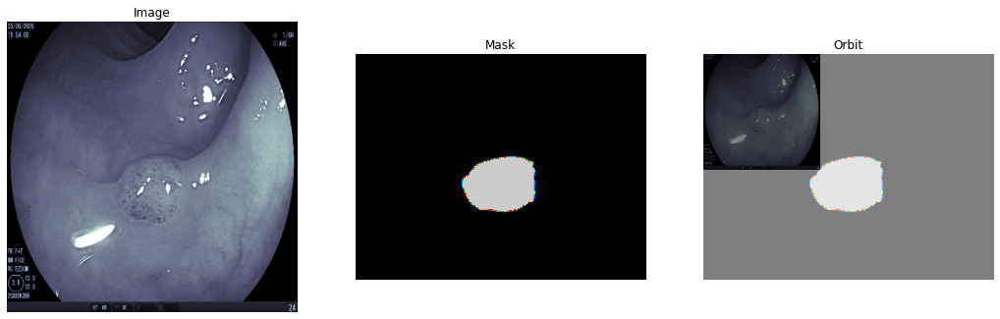

  0%|▏                                          | 1/200 [00:00<01:23,  2.38it/s]

2 0


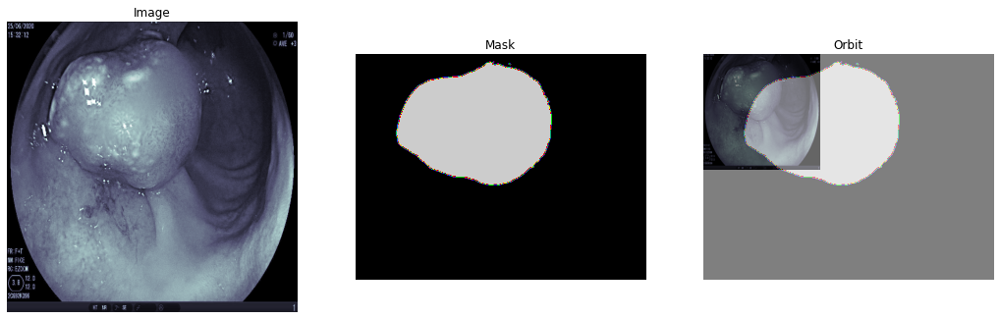

  1%|▍                                          | 2/200 [00:00<01:21,  2.43it/s]

1 0


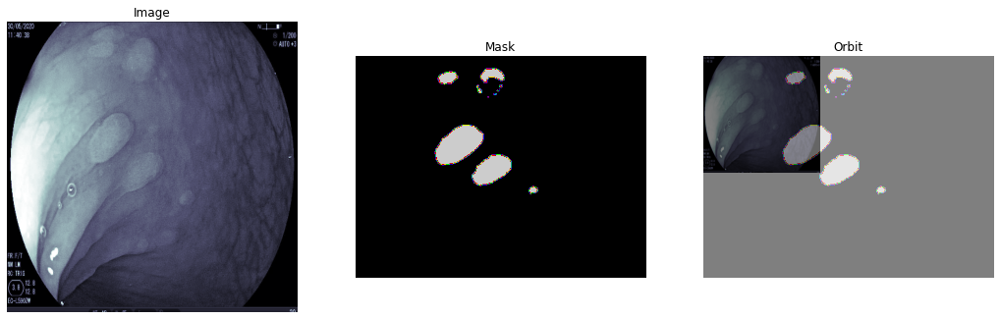

  2%|▋                                          | 3/200 [00:01<01:20,  2.46it/s]

2 0


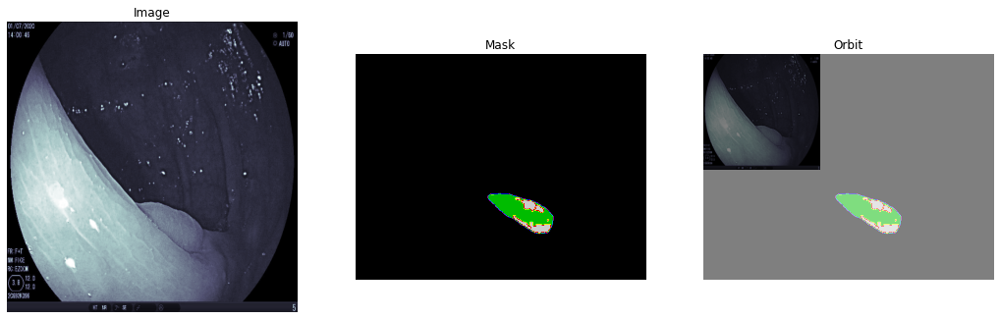

  2%|▊                                          | 4/200 [00:01<01:19,  2.48it/s]

2 0


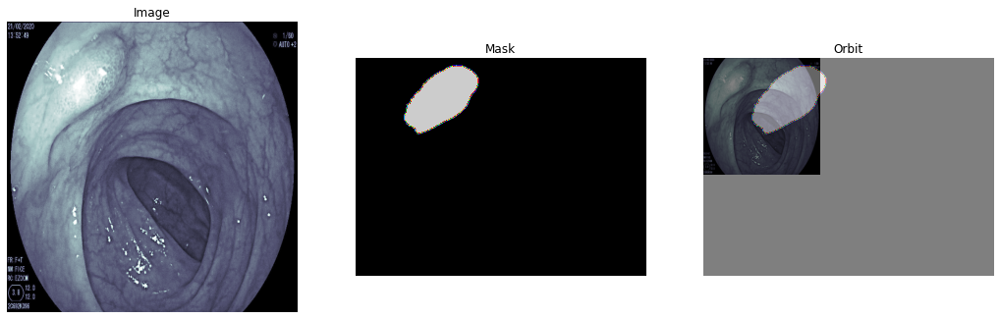

  2%|█                                          | 5/200 [00:02<01:18,  2.49it/s]

1 0


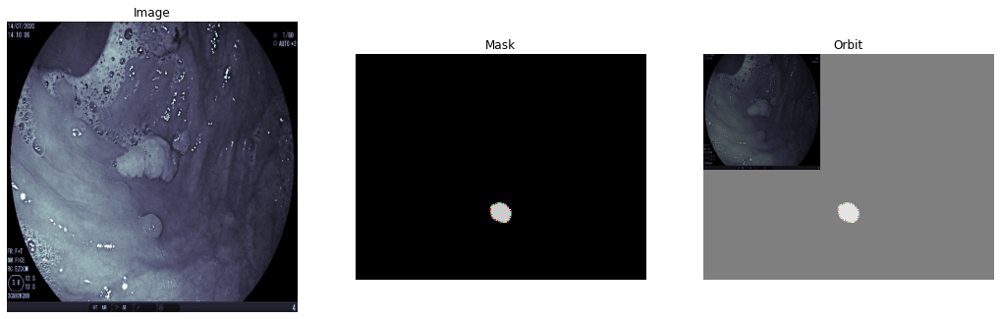

  3%|█▎                                         | 6/200 [00:02<01:17,  2.50it/s]

2 0


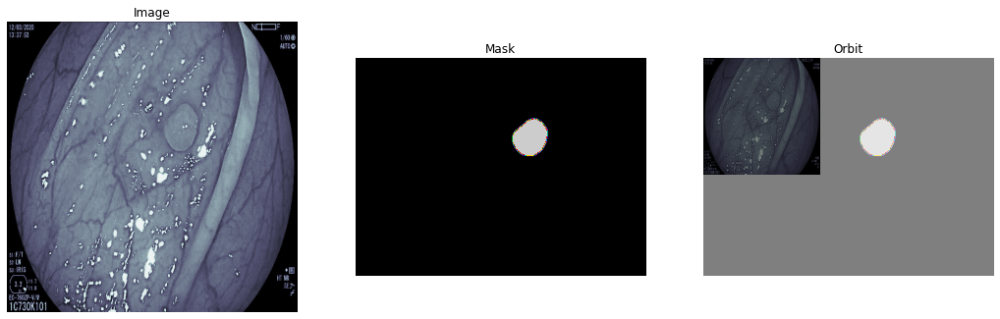

  4%|█▌                                         | 7/200 [00:02<01:16,  2.52it/s]

2 0


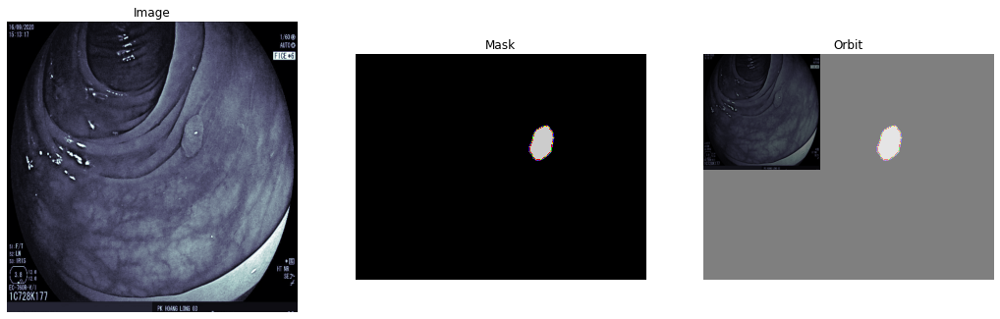

  4%|█▋                                         | 8/200 [00:03<01:17,  2.49it/s]

2 0


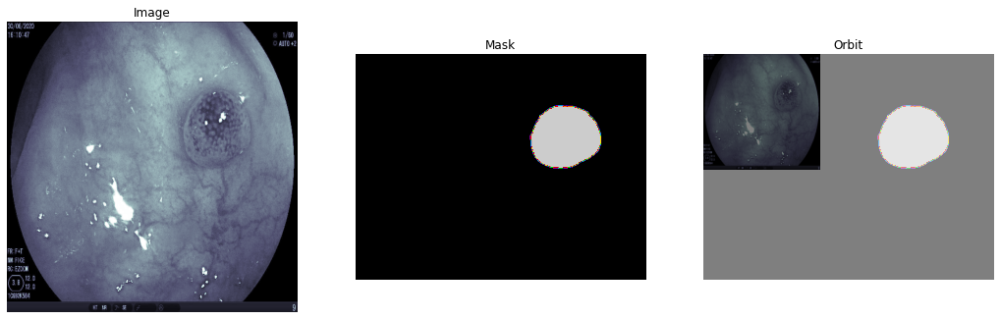

  4%|█▉                                         | 9/200 [00:03<01:16,  2.51it/s]

2 0


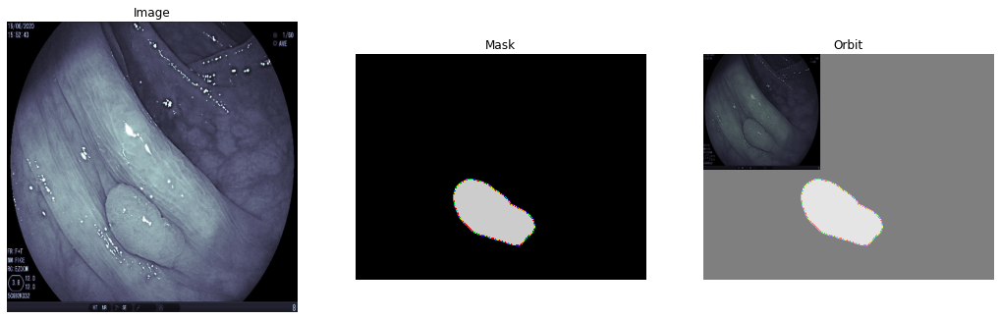

  5%|██                                        | 10/200 [00:04<01:15,  2.52it/s]

2 0


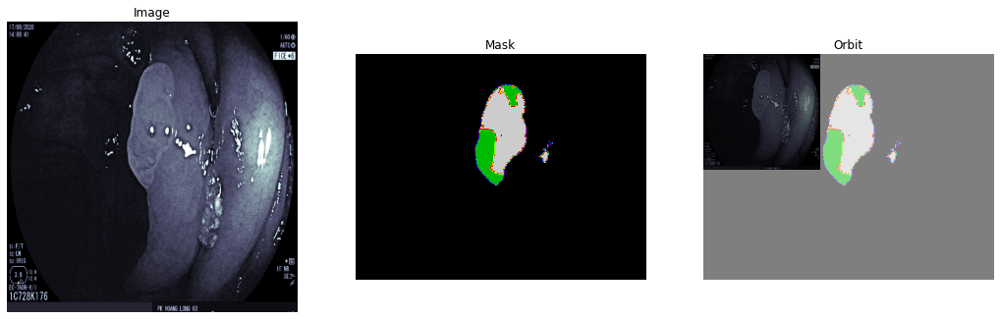

  6%|██▎                                       | 11/200 [00:04<01:14,  2.53it/s]

1 0


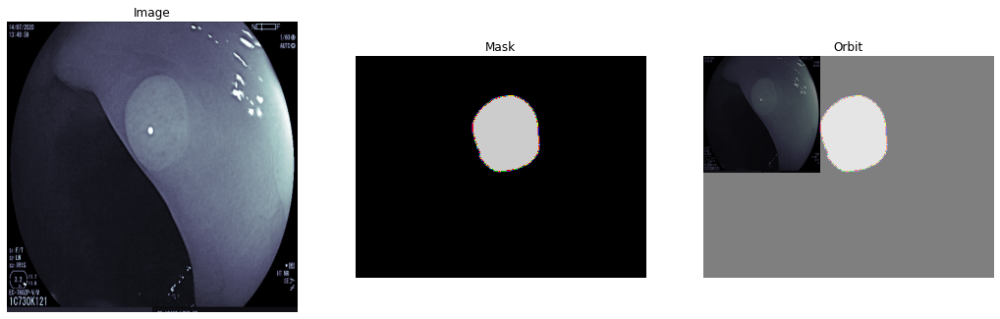

  6%|██▌                                       | 12/200 [00:04<01:14,  2.51it/s]

2 0


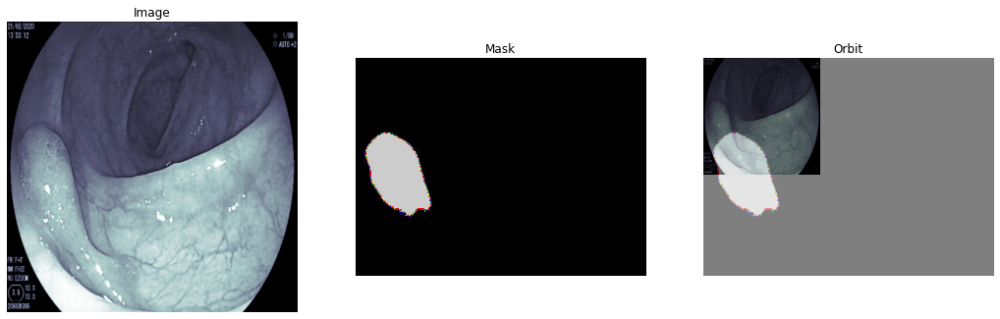

  6%|██▋                                       | 13/200 [00:05<01:14,  2.52it/s]

2 0


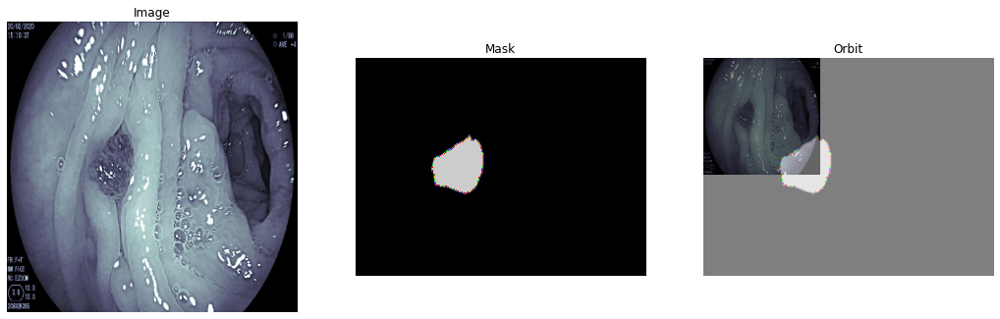

  7%|██▉                                       | 14/200 [00:05<01:13,  2.54it/s]

2 0


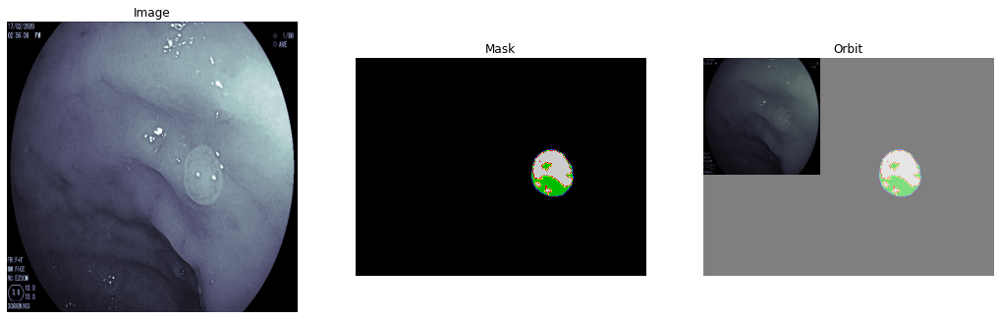

  8%|███▏                                      | 15/200 [00:05<01:12,  2.55it/s]

2 0


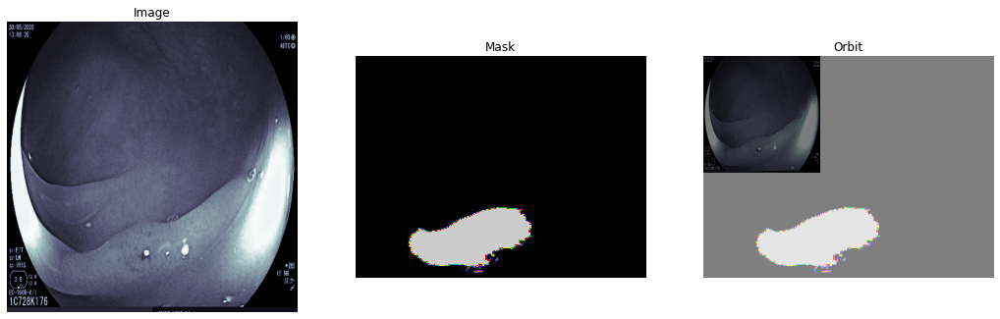

  8%|███▎                                      | 16/200 [00:06<01:26,  2.12it/s]

1 0


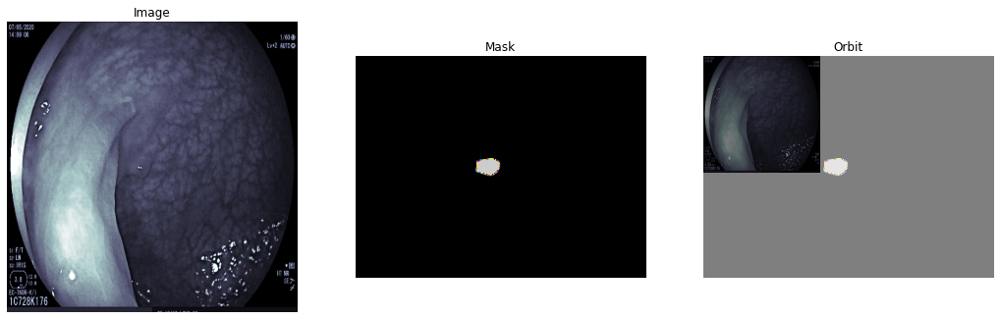

  8%|███▌                                      | 17/200 [00:07<01:22,  2.23it/s]

1 0


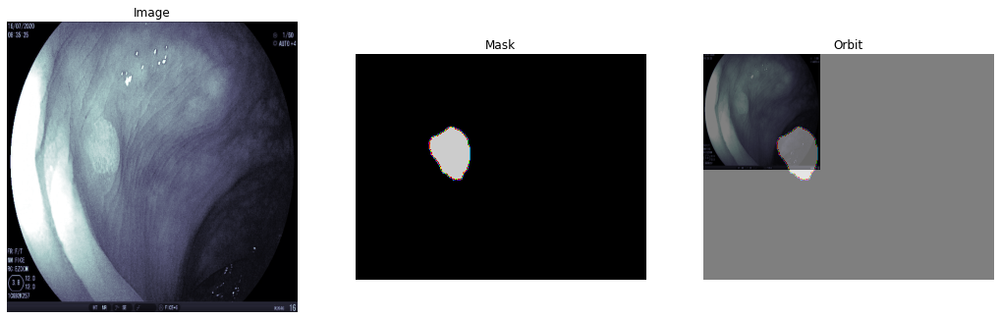

  9%|███▊                                      | 18/200 [00:07<01:20,  2.25it/s]

2 0


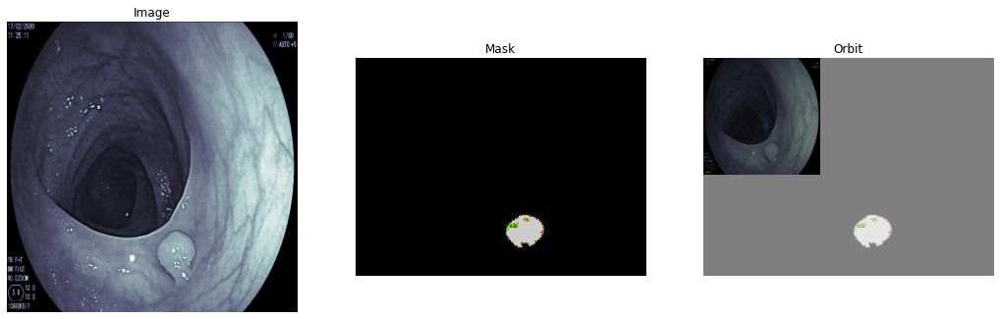

 10%|███▉                                      | 19/200 [00:07<01:17,  2.34it/s]

2 0


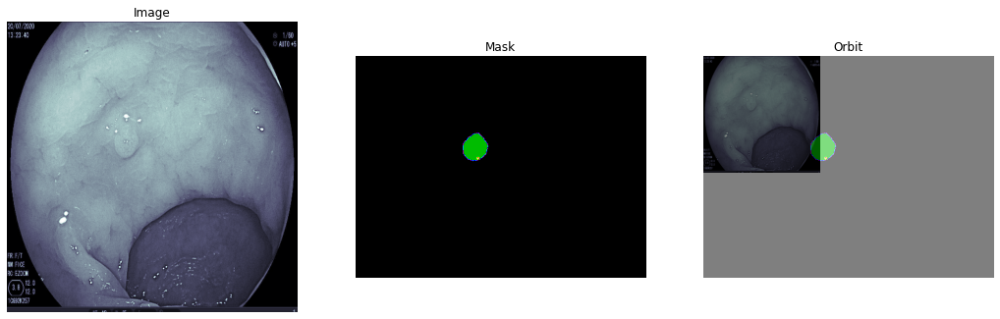

 10%|████▏                                     | 20/200 [00:08<01:15,  2.38it/s]

2 0


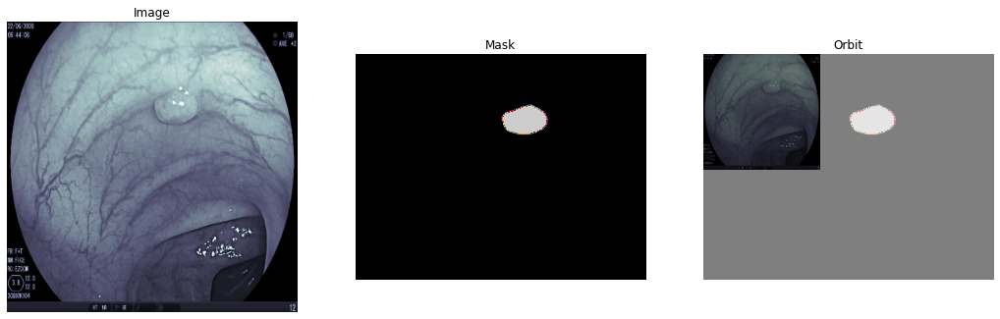

 10%|████▍                                     | 21/200 [00:08<01:14,  2.42it/s]

2 0


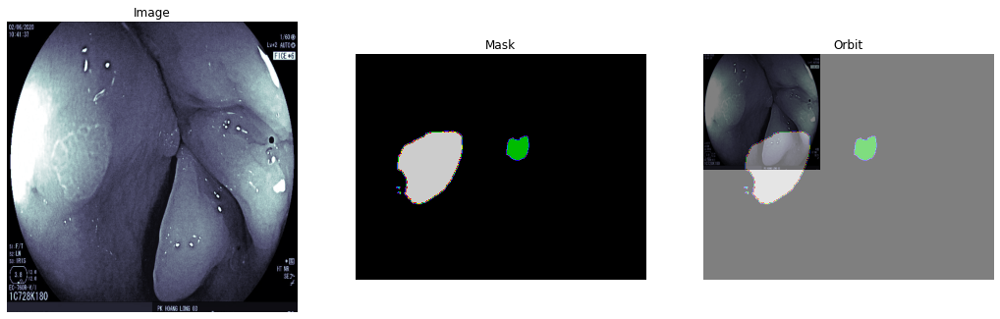

 11%|████▌                                     | 22/200 [00:09<01:12,  2.45it/s]

2 0


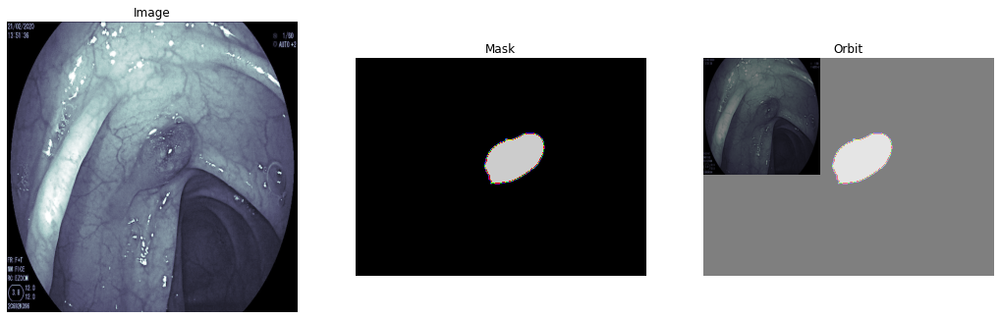

 12%|████▊                                     | 23/200 [00:09<01:11,  2.49it/s]

2 0


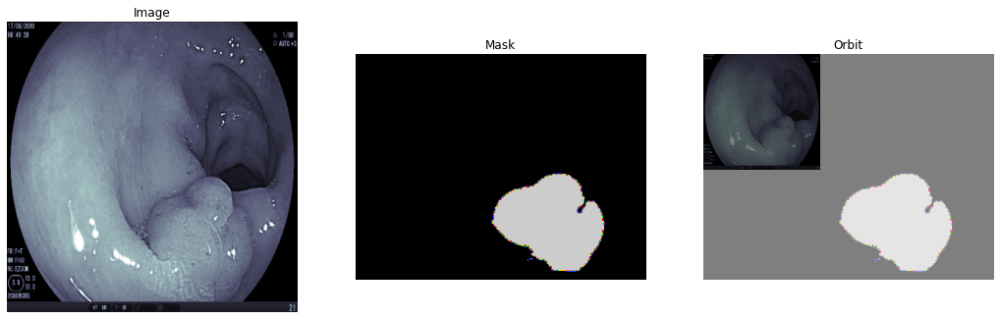

 12%|█████                                     | 24/200 [00:09<01:11,  2.47it/s]

2 0


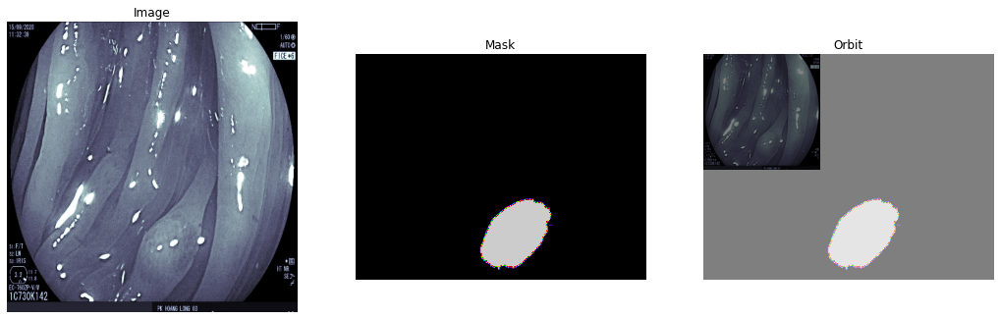

 12%|█████▎                                    | 25/200 [00:10<01:10,  2.47it/s]

2 0


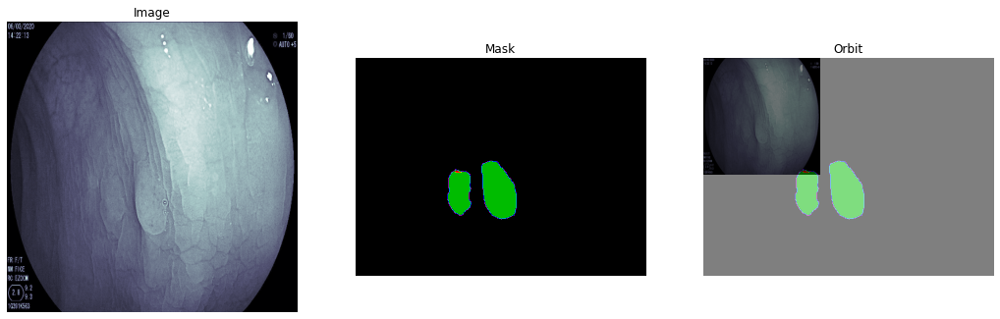

 13%|█████▍                                    | 26/200 [00:10<01:09,  2.49it/s]

1 0


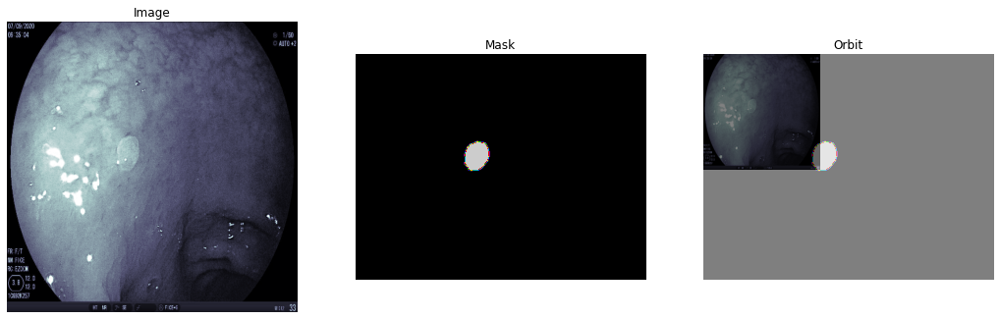

 14%|█████▋                                    | 27/200 [00:11<01:09,  2.49it/s]

2 0


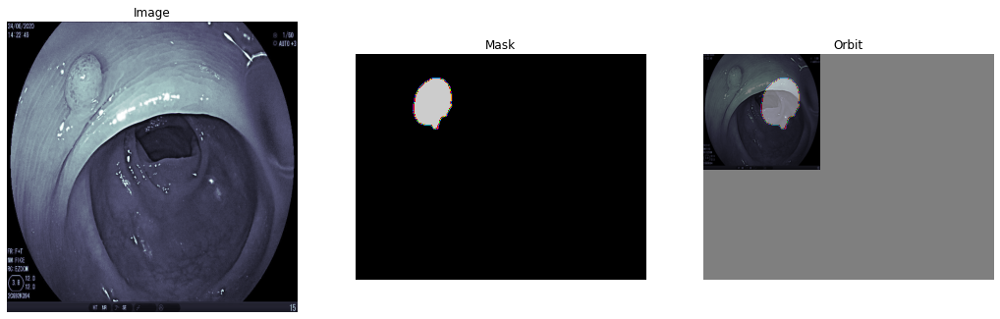

 14%|█████▉                                    | 28/200 [00:11<01:09,  2.47it/s]

2 0


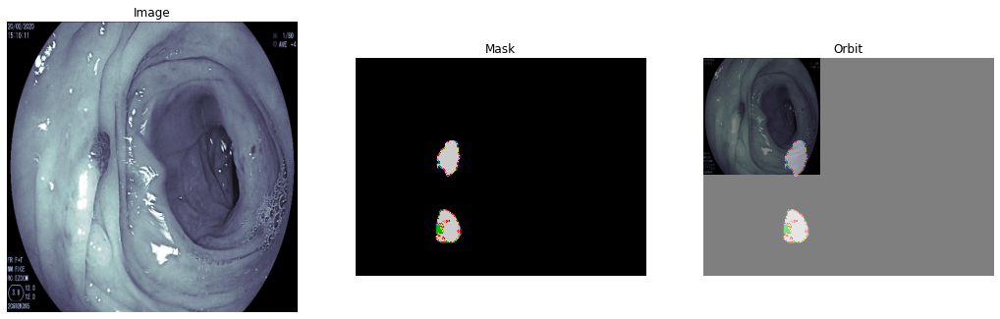

 14%|██████                                    | 29/200 [00:11<01:09,  2.47it/s]

2 0


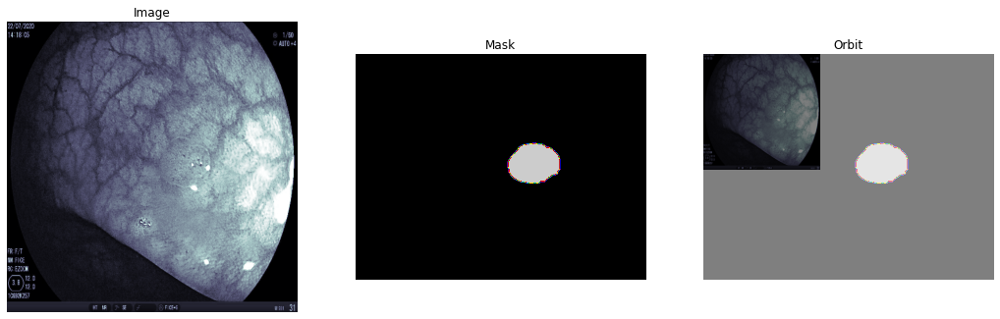

 15%|██████▎                                   | 30/200 [00:12<01:08,  2.48it/s]

2 0


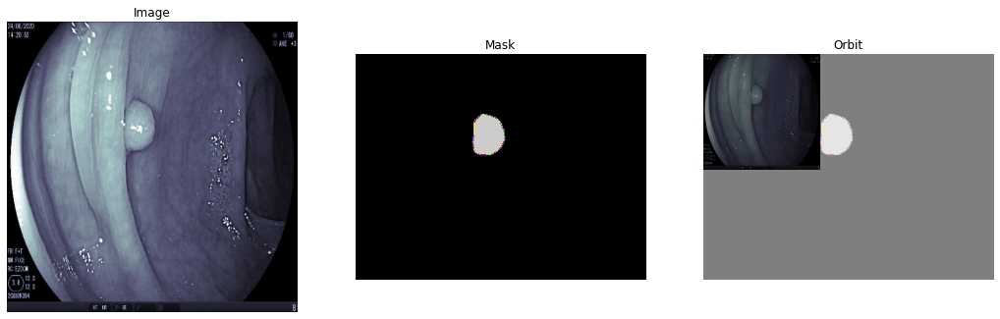

 16%|██████▌                                   | 31/200 [00:12<01:07,  2.49it/s]

2 0


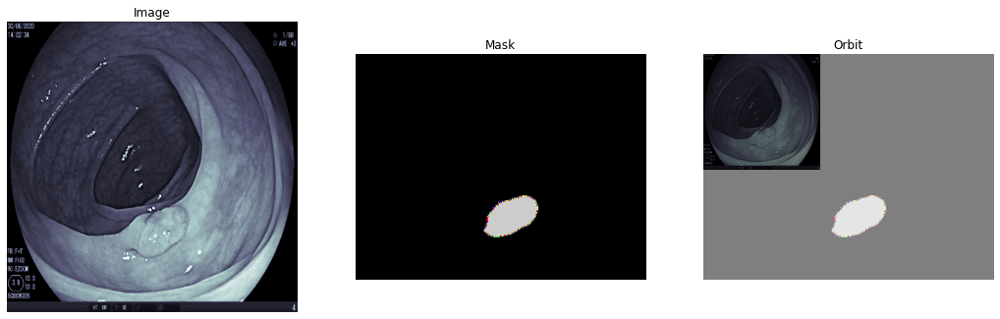

 16%|██████▋                                   | 32/200 [00:13<01:07,  2.49it/s]

2 0


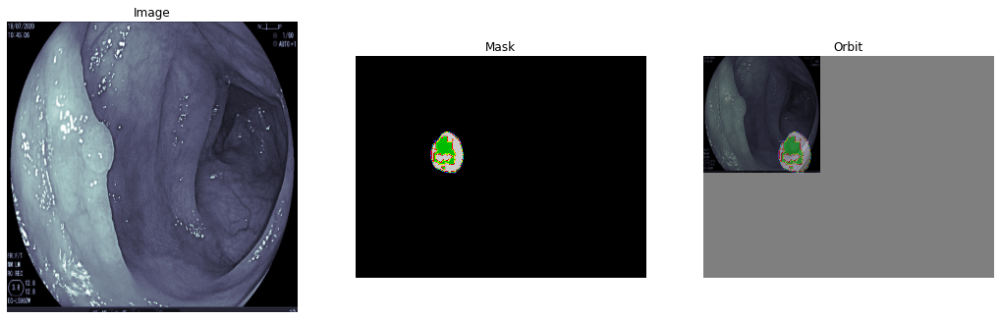

 16%|██████▉                                   | 33/200 [00:13<01:06,  2.51it/s]

1 0


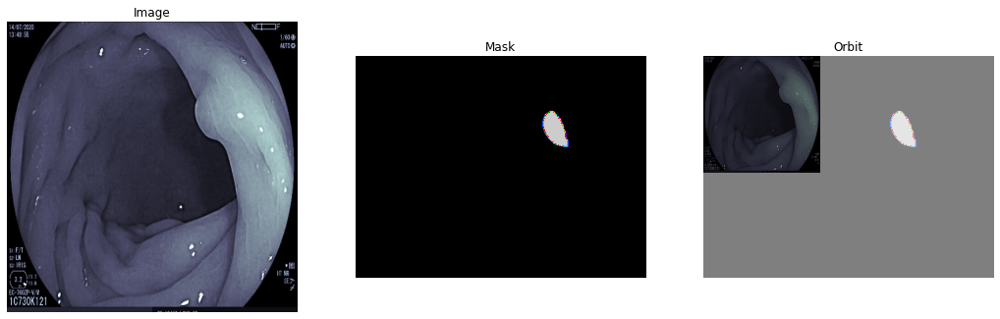

 17%|███████▏                                  | 34/200 [00:13<01:05,  2.52it/s]

2 0


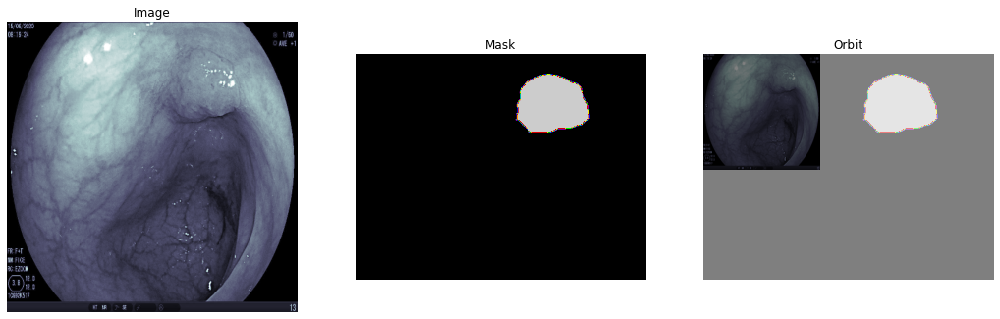

 18%|███████▎                                  | 35/200 [00:14<01:05,  2.51it/s]

1 0


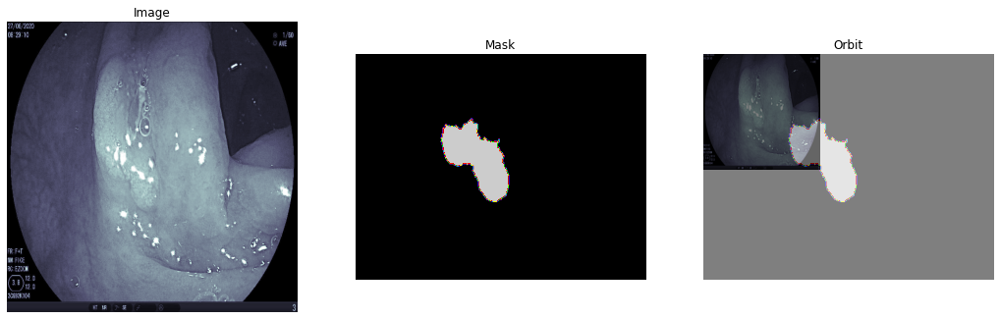

 18%|███████▌                                  | 36/200 [00:14<01:05,  2.50it/s]

1 0


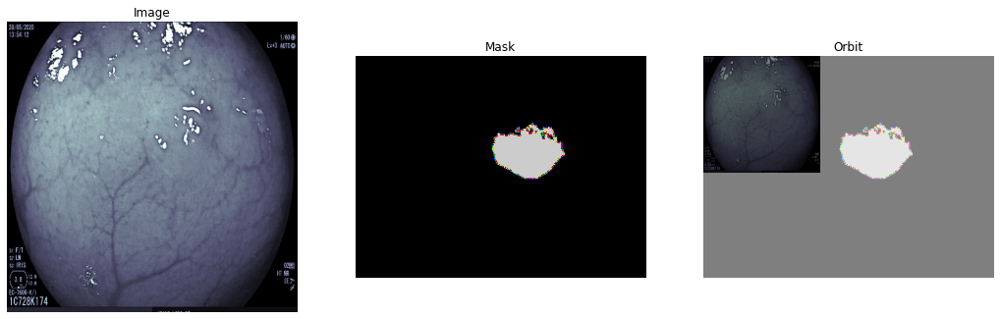

 18%|███████▊                                  | 37/200 [00:15<01:05,  2.50it/s]

1 0


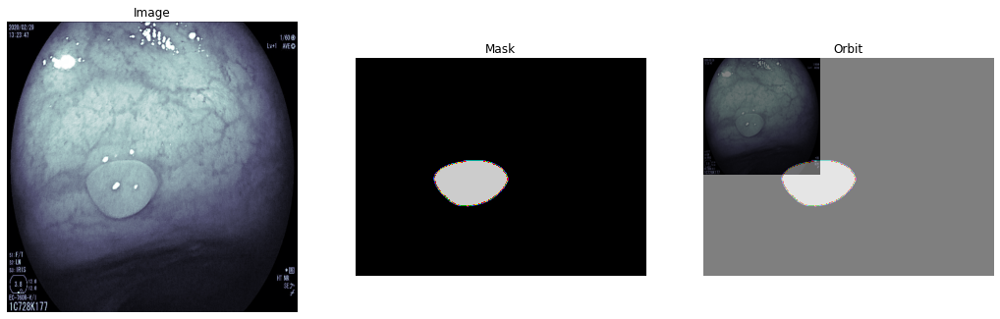

 19%|███████▉                                  | 38/200 [00:15<01:16,  2.13it/s]

2 0


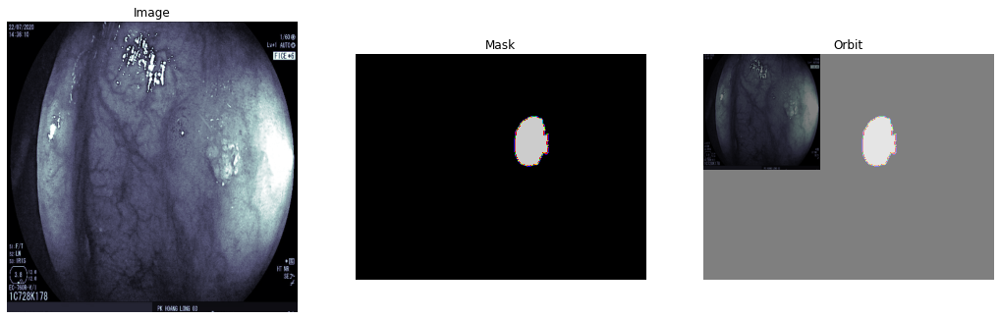

 20%|████████▏                                 | 39/200 [00:16<01:12,  2.23it/s]

2 0


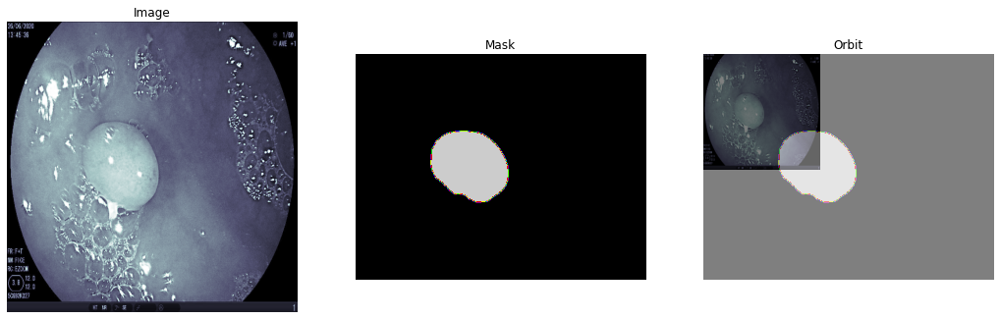

 20%|████████▍                                 | 40/200 [00:16<01:09,  2.31it/s]

2 0


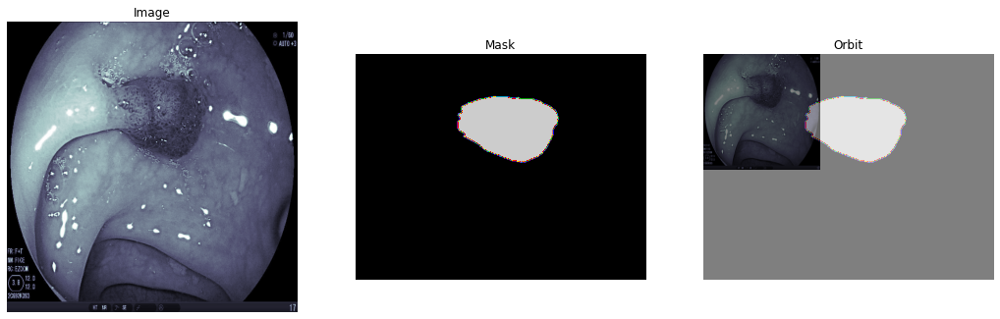

 20%|████████▌                                 | 41/200 [00:16<01:07,  2.36it/s]

2 0


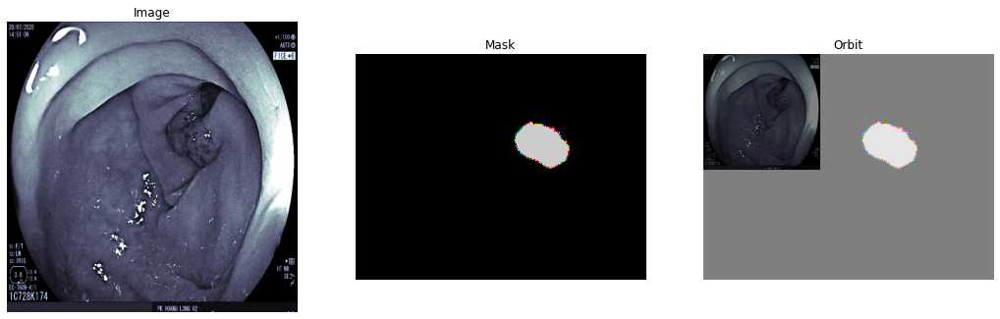

 21%|████████▊                                 | 42/200 [00:17<01:06,  2.39it/s]

2 0


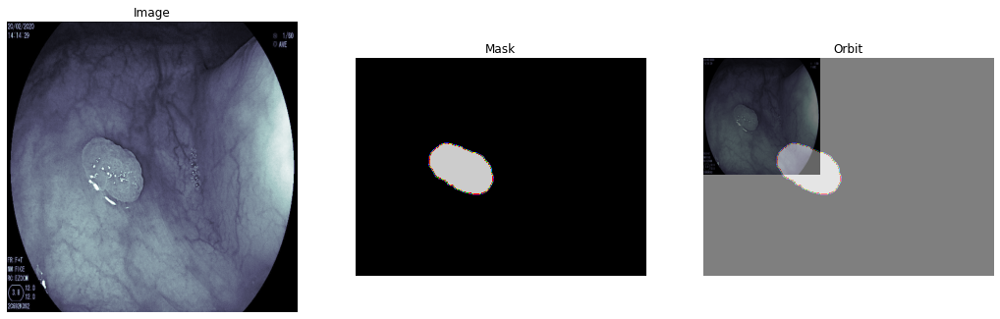

 22%|█████████                                 | 43/200 [00:17<01:04,  2.43it/s]

2 0


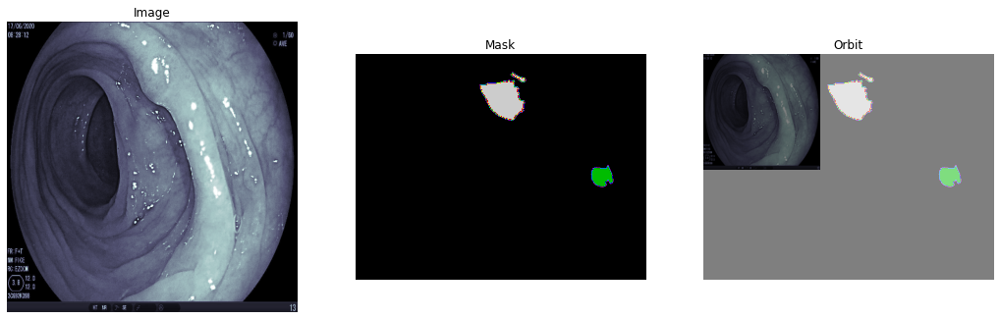

 22%|█████████▏                                | 44/200 [00:18<01:03,  2.45it/s]

2 0


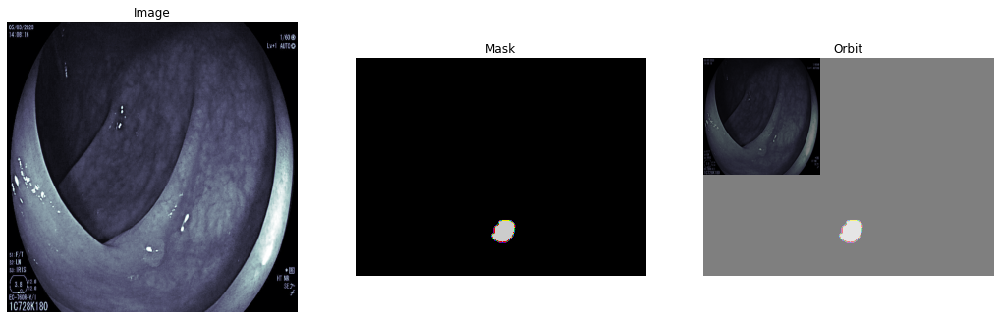

 22%|█████████▍                                | 45/200 [00:18<01:02,  2.49it/s]

2 0


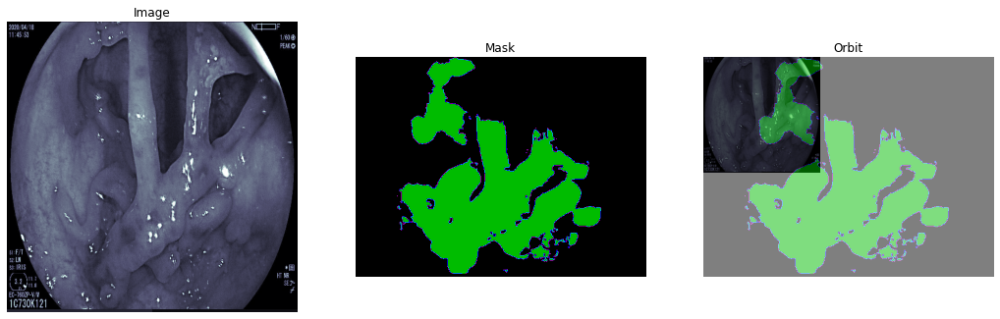

 23%|█████████▋                                | 46/200 [00:18<01:01,  2.50it/s]

2 0


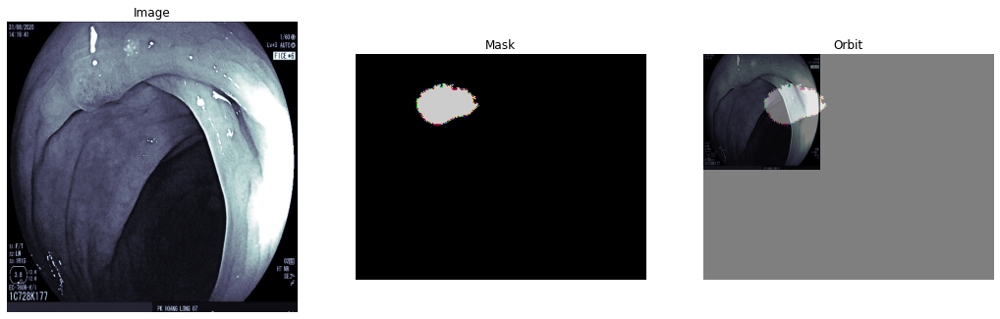

 24%|█████████▊                                | 47/200 [00:19<01:00,  2.52it/s]

2 0


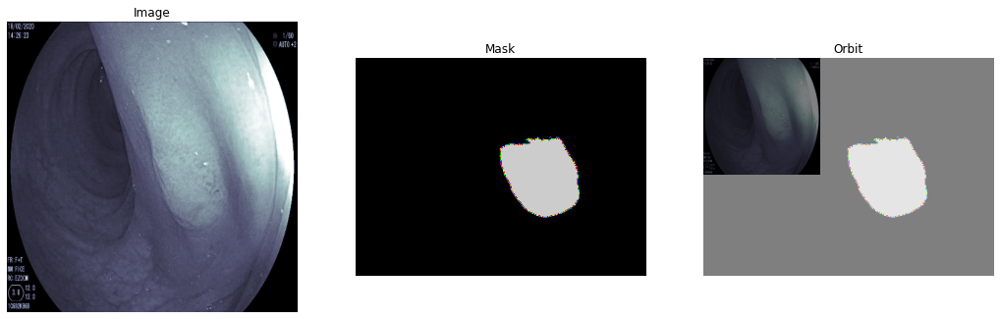

 24%|██████████                                | 48/200 [00:19<01:00,  2.53it/s]

1 0


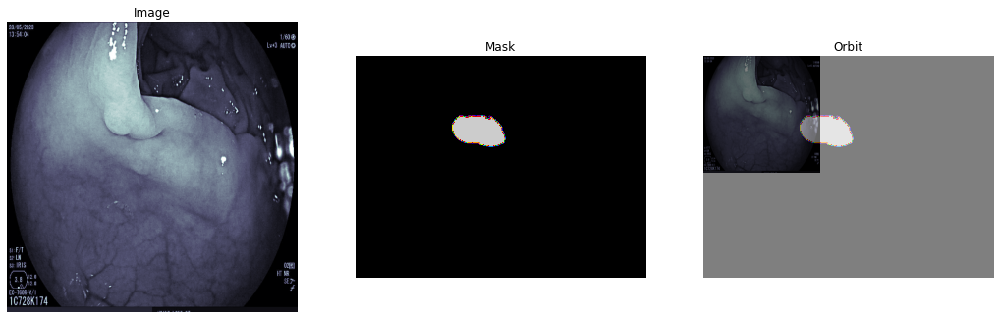

 24%|██████████▎                               | 49/200 [00:20<00:59,  2.53it/s]

2 0


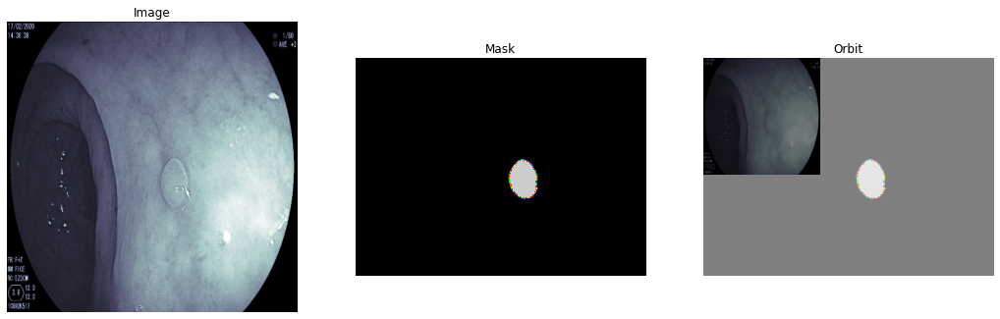

 25%|██████████▌                               | 50/200 [00:20<00:59,  2.54it/s]

2 0


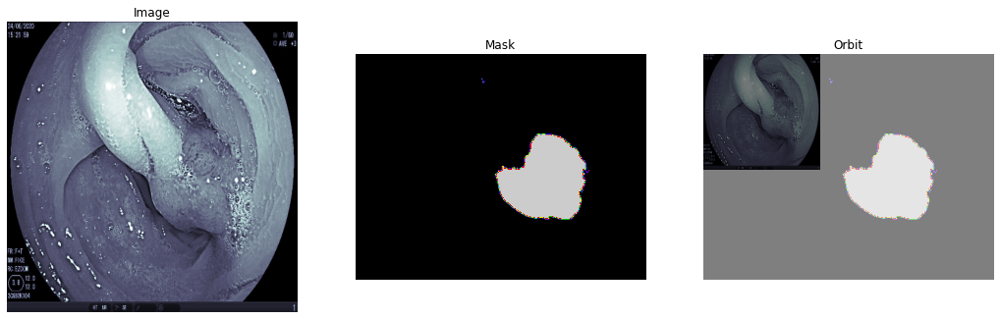

 26%|██████████▋                               | 51/200 [00:20<00:59,  2.51it/s]

1 0


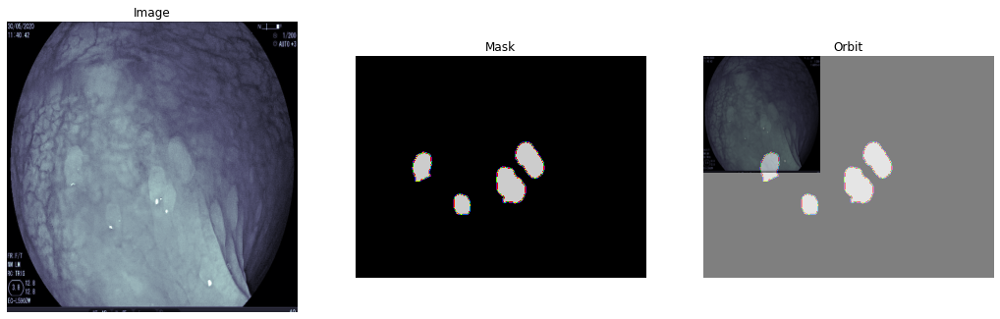

 26%|██████████▉                               | 52/200 [00:21<00:59,  2.50it/s]

2 0


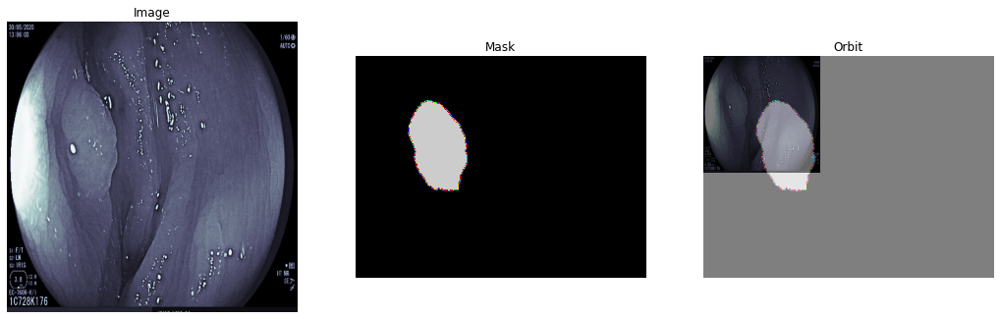

 26%|███████████▏                              | 53/200 [00:21<00:58,  2.51it/s]

1 0


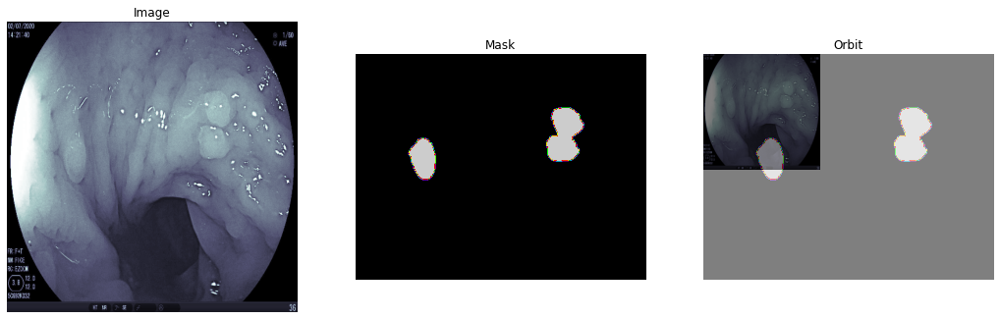

 27%|███████████▎                              | 54/200 [00:22<00:57,  2.52it/s]

2 0


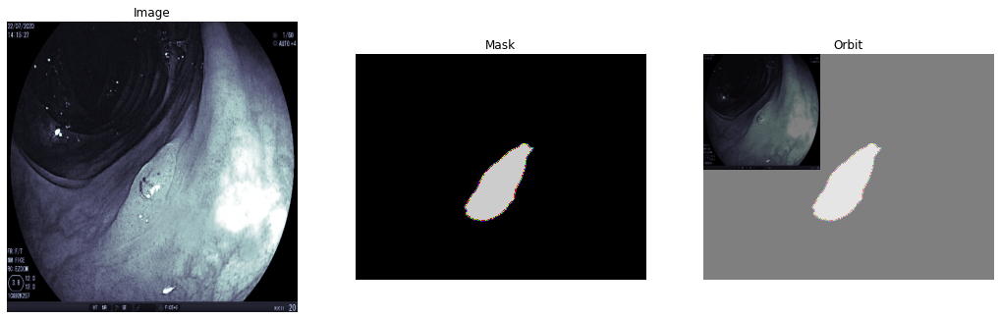

 28%|███████████▌                              | 55/200 [00:22<00:57,  2.52it/s]

2 0


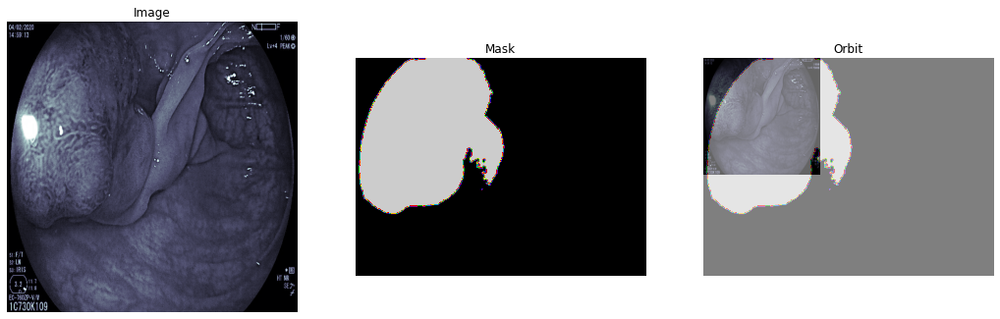

 28%|███████████▊                              | 56/200 [00:22<00:57,  2.50it/s]

2 0


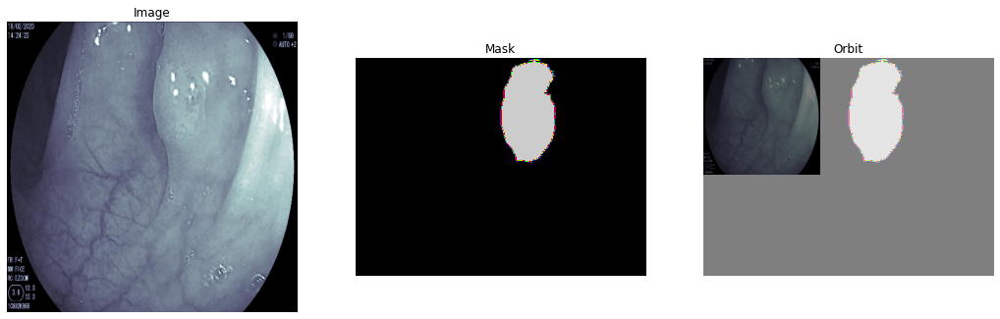

 28%|███████████▉                              | 57/200 [00:23<00:56,  2.51it/s]

2 0


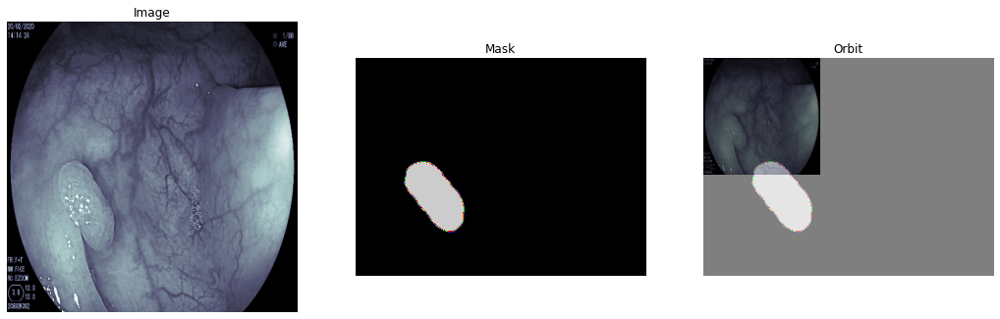

 29%|████████████▏                             | 58/200 [00:23<00:56,  2.52it/s]

2 0


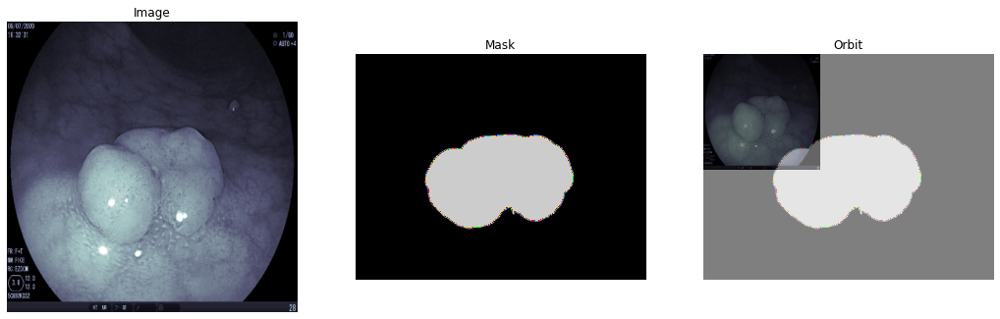

 30%|████████████▍                             | 59/200 [00:24<00:56,  2.51it/s]

2 0


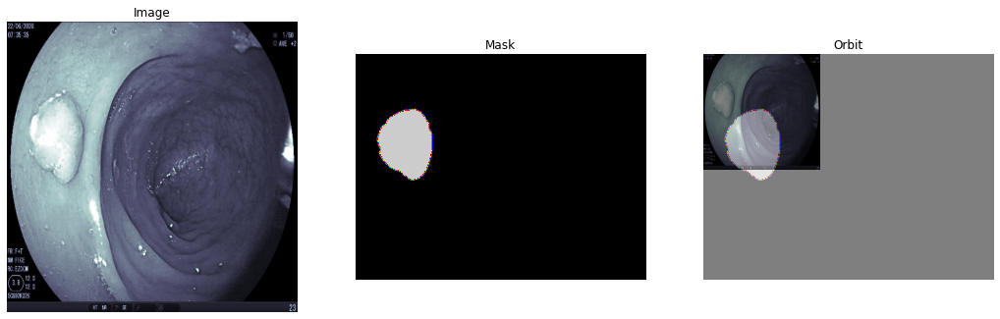

 30%|████████████▌                             | 60/200 [00:24<00:55,  2.51it/s]

2 0


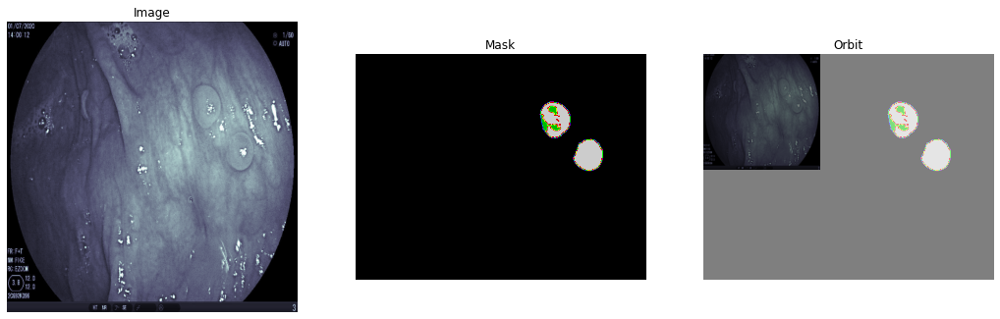

 30%|████████████▊                             | 61/200 [00:25<01:05,  2.12it/s]

2 0


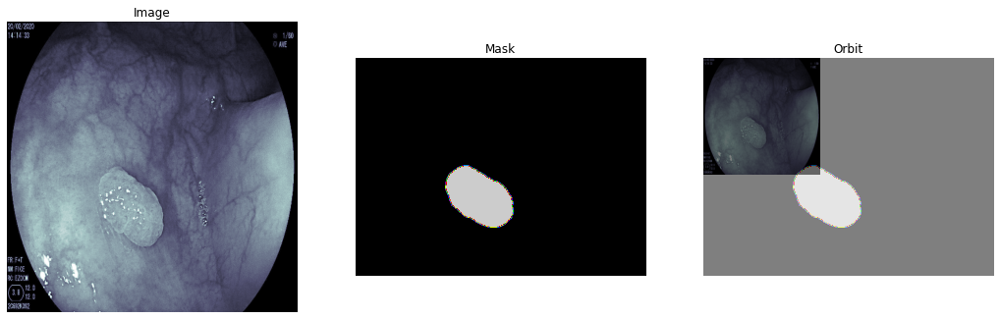

 31%|█████████████                             | 62/200 [00:25<01:01,  2.23it/s]

2 0


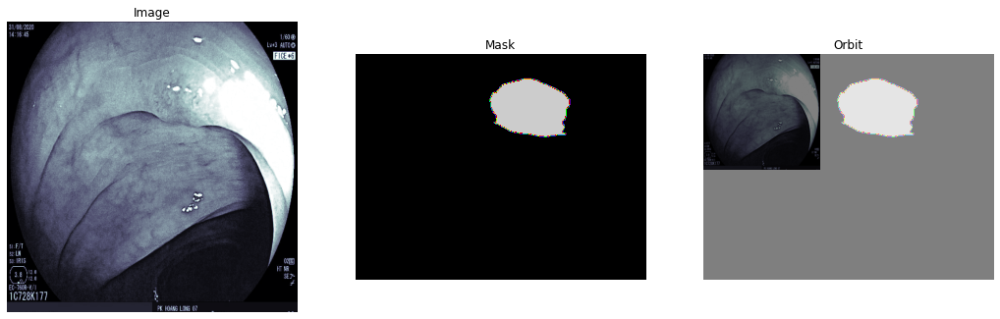

 32%|█████████████▏                            | 63/200 [00:25<00:59,  2.31it/s]

2 0


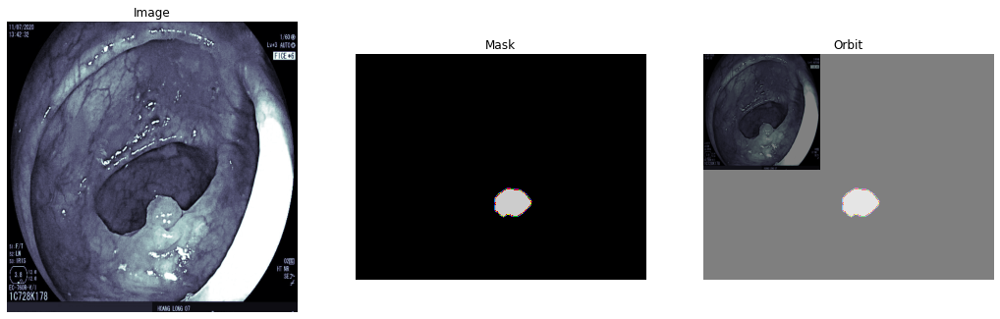

 32%|█████████████▍                            | 64/200 [00:26<00:57,  2.35it/s]

2 0


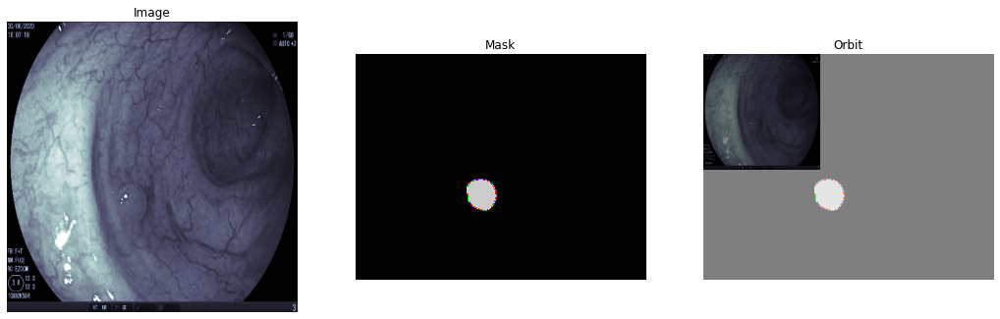

 32%|█████████████▋                            | 65/200 [00:26<00:56,  2.38it/s]

2 0


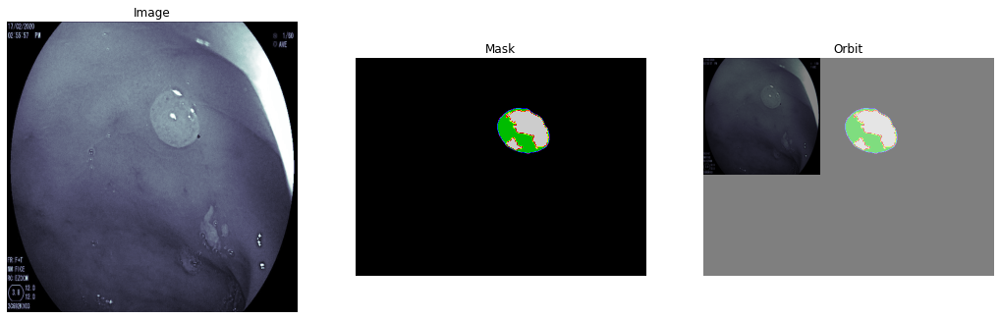

 33%|█████████████▊                            | 66/200 [00:27<00:55,  2.42it/s]

2 0


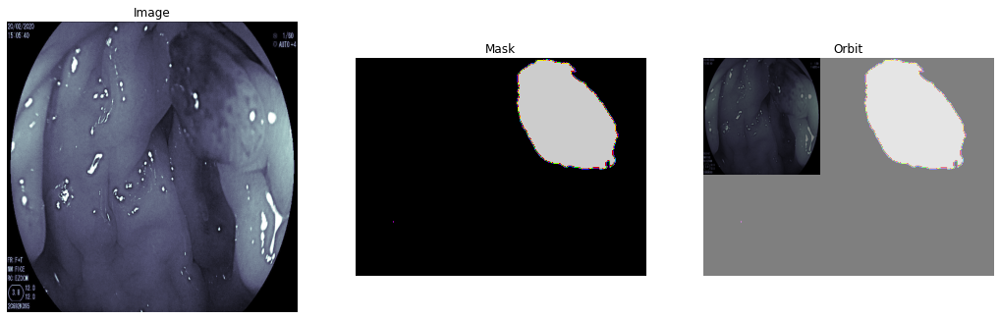

 34%|██████████████                            | 67/200 [00:27<00:54,  2.44it/s]

2 0


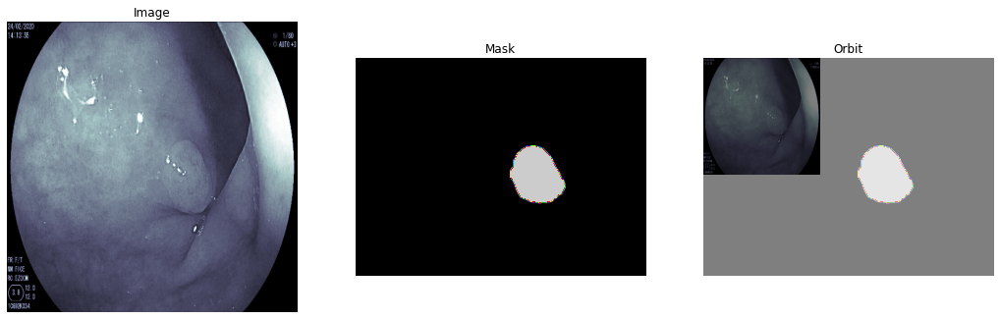

 34%|██████████████▎                           | 68/200 [00:27<00:53,  2.47it/s]

2 0


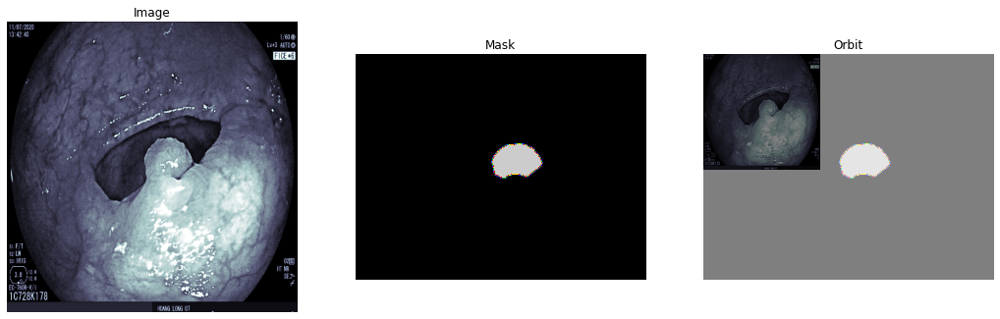

 34%|██████████████▍                           | 69/200 [00:28<00:52,  2.49it/s]

2 0


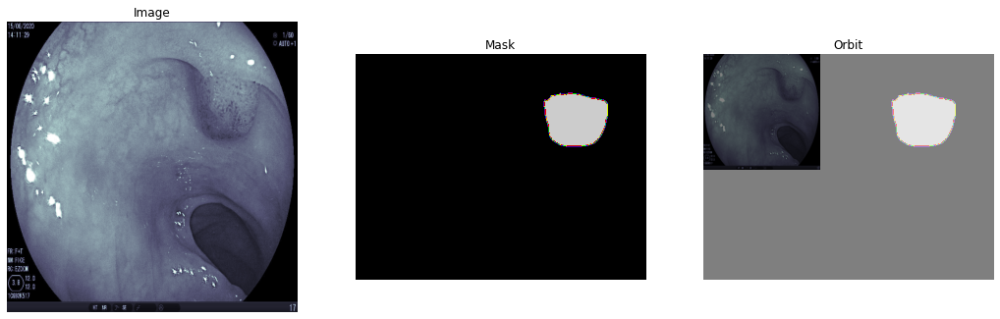

 35%|██████████████▋                           | 70/200 [00:28<00:52,  2.49it/s]

2 0


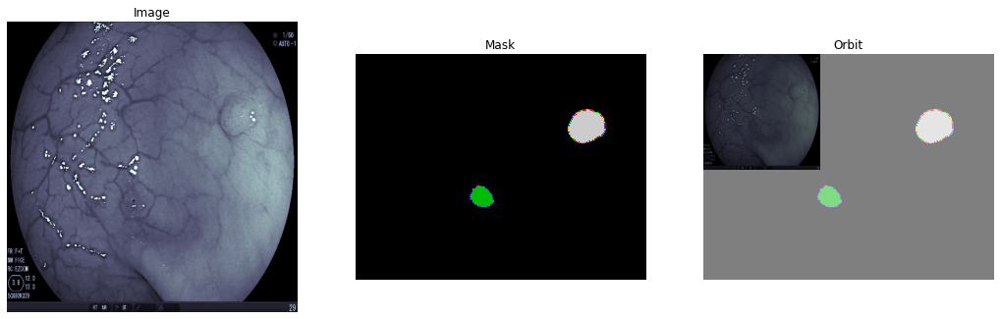

 36%|██████████████▉                           | 71/200 [00:29<00:52,  2.48it/s]

2 0


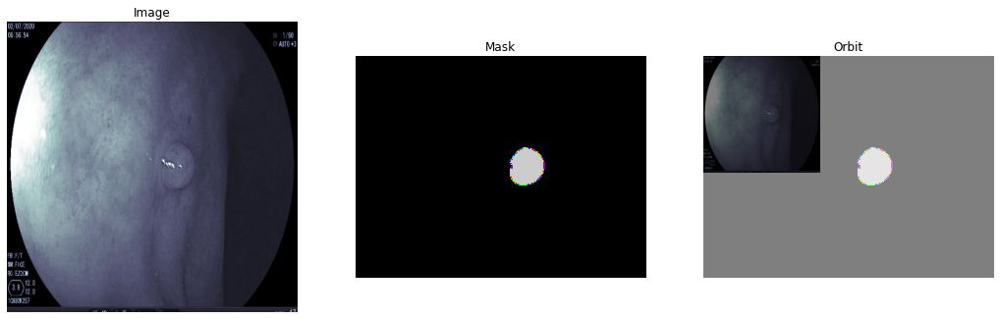

 36%|███████████████                           | 72/200 [00:29<00:51,  2.49it/s]

2 0


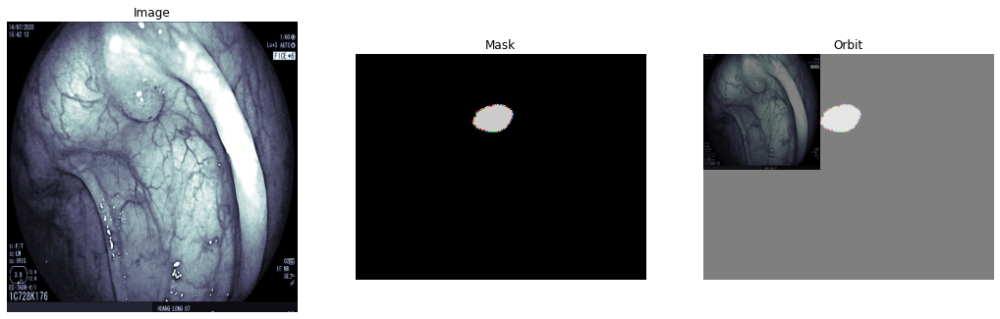

 36%|███████████████▎                          | 73/200 [00:29<00:50,  2.51it/s]

2 0


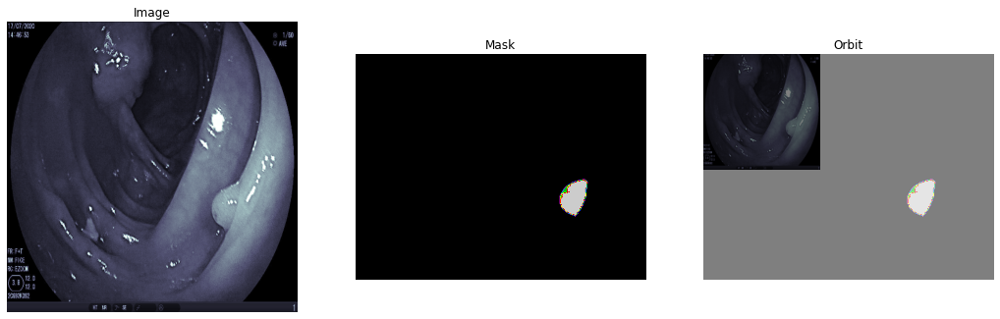

 37%|███████████████▌                          | 74/200 [00:30<00:50,  2.51it/s]

1 0


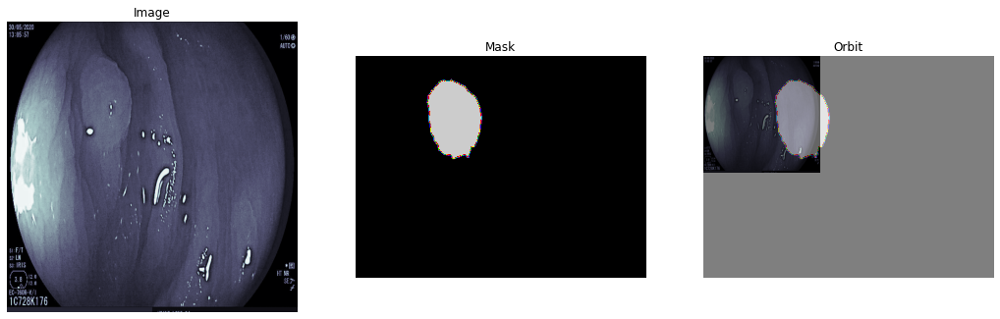

 38%|███████████████▊                          | 75/200 [00:30<00:49,  2.52it/s]

2 0


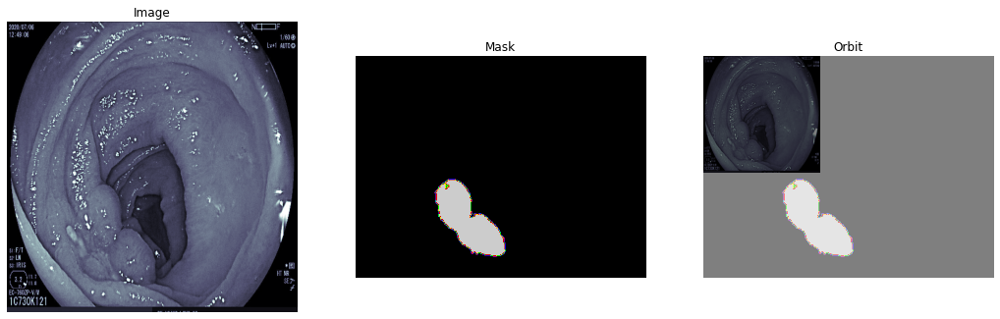

 38%|███████████████▉                          | 76/200 [00:31<00:48,  2.53it/s]

2 0


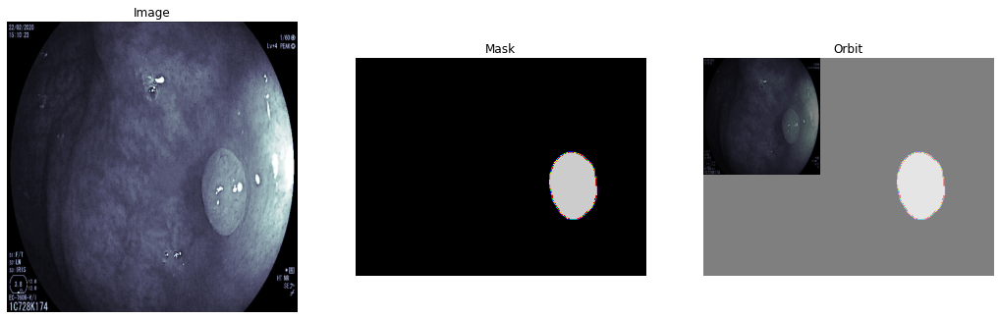

 38%|████████████████▏                         | 77/200 [00:31<00:48,  2.53it/s]

2 0


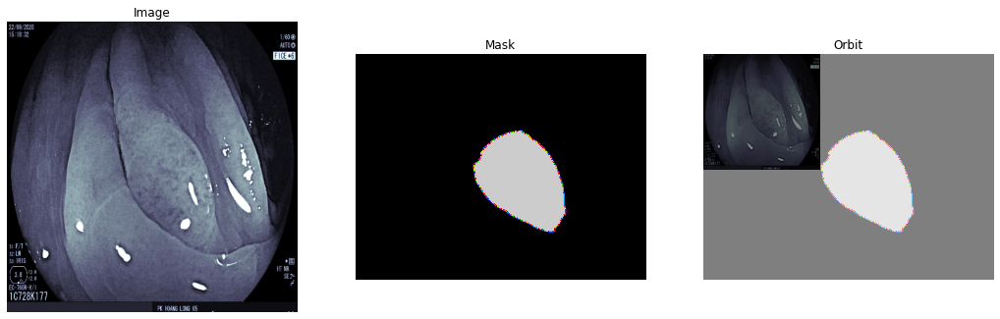

 39%|████████████████▍                         | 78/200 [00:31<00:48,  2.52it/s]

2 0


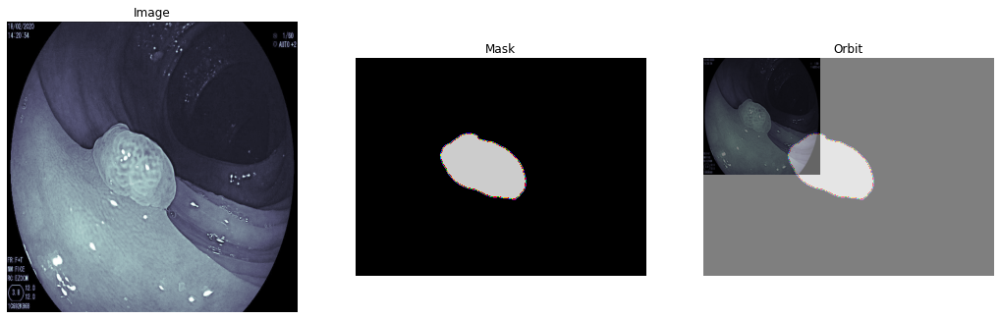

 40%|████████████████▌                         | 79/200 [00:32<00:47,  2.52it/s]

2 0


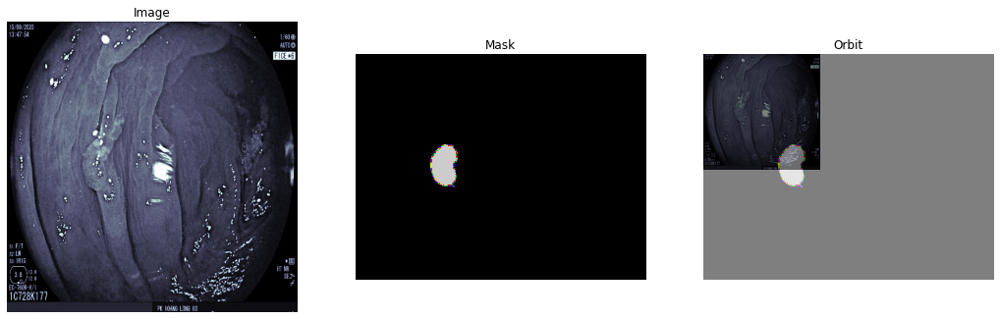

 40%|████████████████▊                         | 80/200 [00:32<00:47,  2.53it/s]

1 0


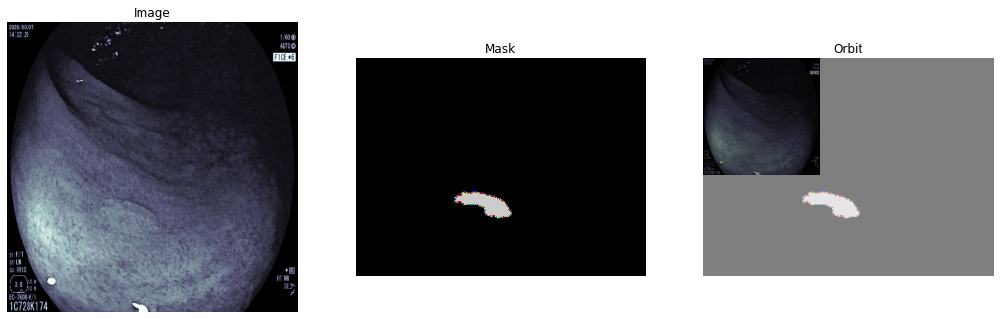

 40%|█████████████████                         | 81/200 [00:33<00:46,  2.54it/s]

2 0


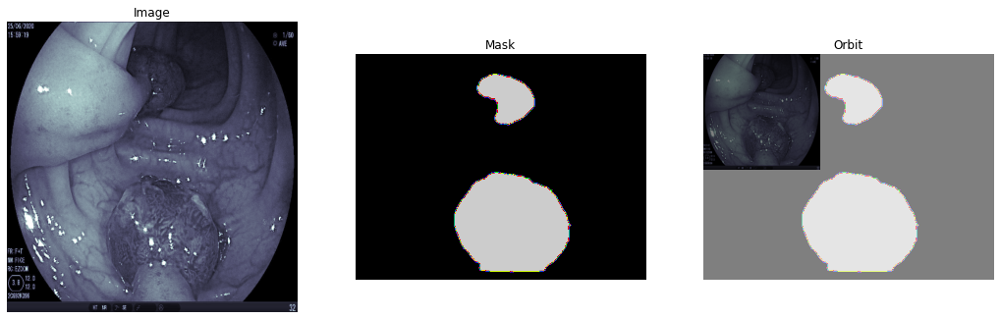

 41%|█████████████████▏                        | 82/200 [00:33<00:46,  2.54it/s]

2 0


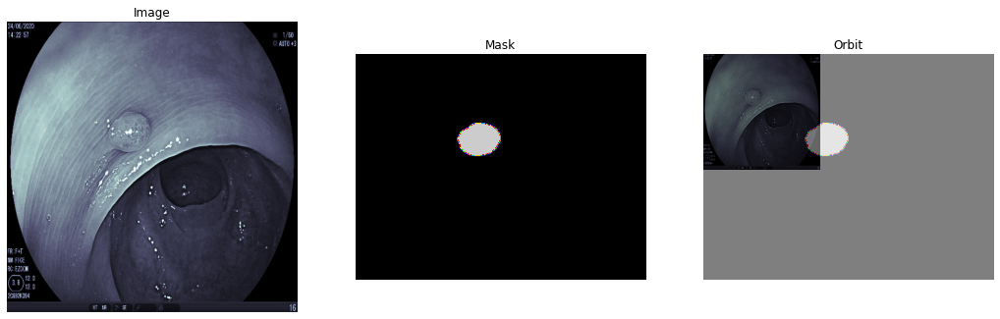

 42%|█████████████████▍                        | 83/200 [00:33<00:46,  2.54it/s]

2 0


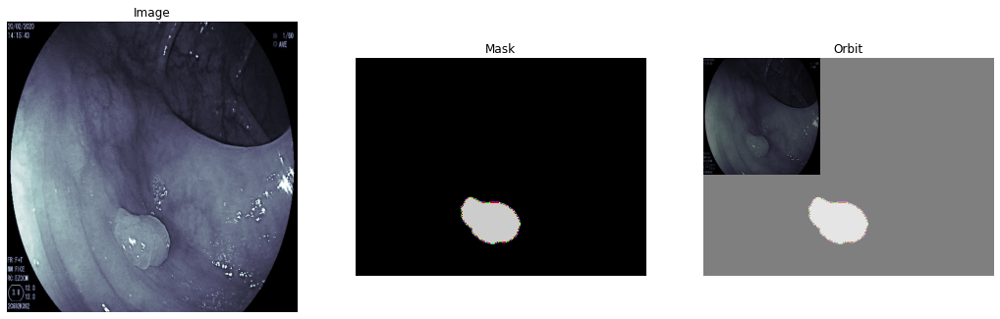

 42%|█████████████████▋                        | 84/200 [00:34<00:53,  2.15it/s]

2 0


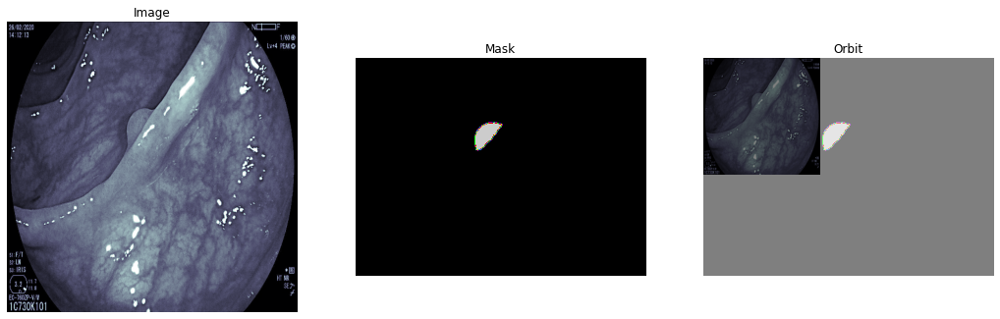

 42%|█████████████████▊                        | 85/200 [00:34<00:51,  2.24it/s]

2 0


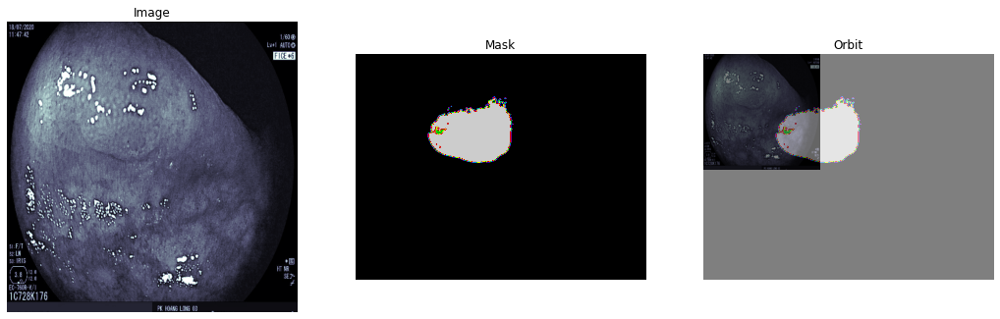

 43%|██████████████████                        | 86/200 [00:35<00:49,  2.31it/s]

1 0


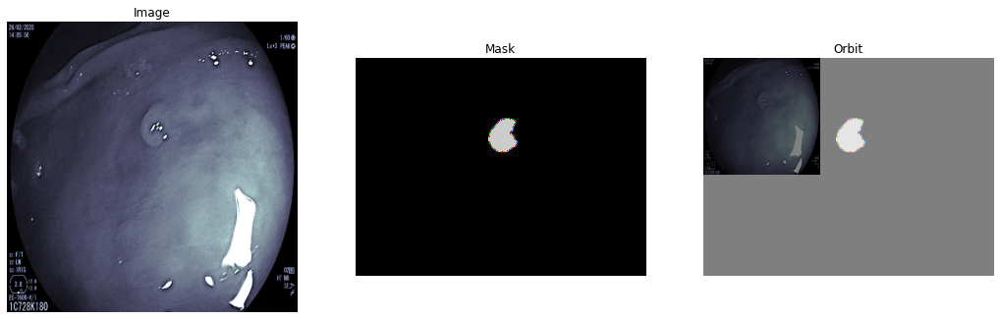

 44%|██████████████████▎                       | 87/200 [00:35<00:47,  2.38it/s]

2 0


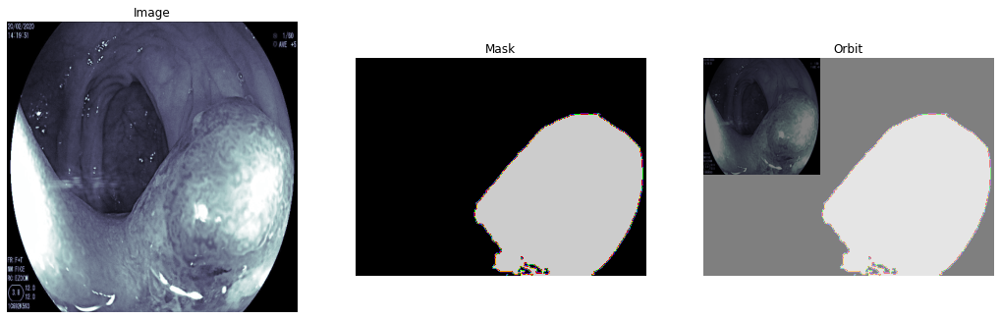

 44%|██████████████████▍                       | 88/200 [00:36<00:46,  2.43it/s]

2 0


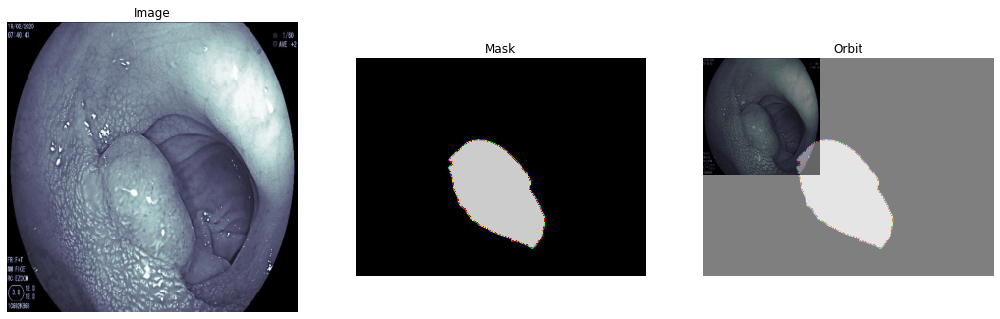

 44%|██████████████████▋                       | 89/200 [00:36<00:45,  2.46it/s]

2 0


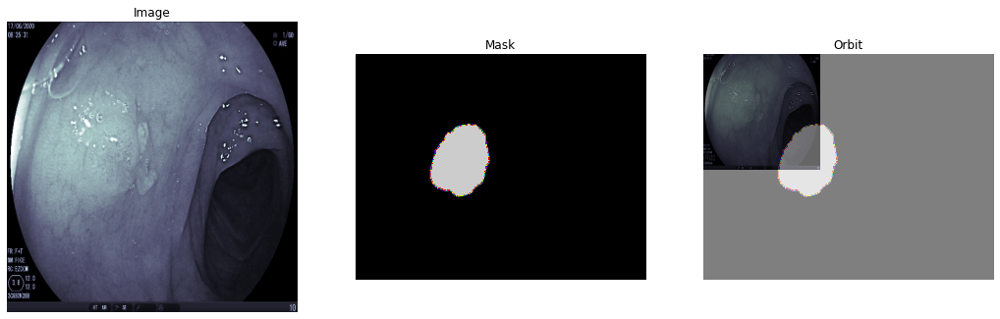

 45%|██████████████████▉                       | 90/200 [00:36<00:44,  2.47it/s]

2 0


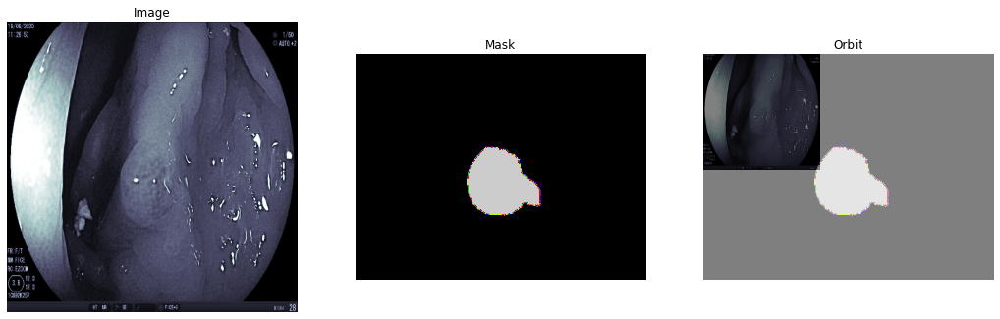

 46%|███████████████████                       | 91/200 [00:37<00:43,  2.49it/s]

2 0


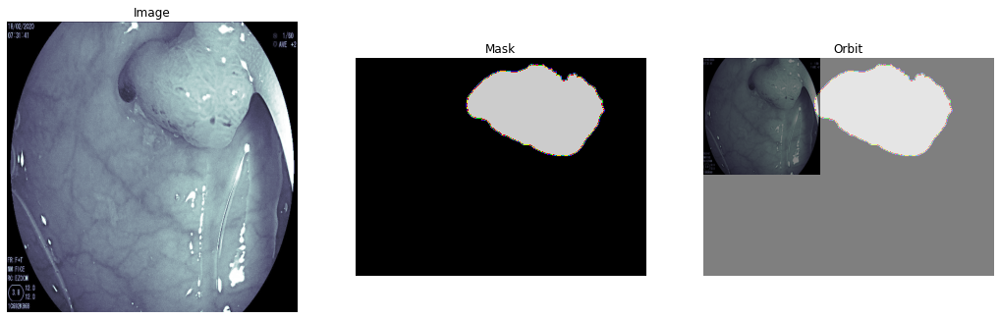

 46%|███████████████████▎                      | 92/200 [00:37<00:43,  2.51it/s]

2 0


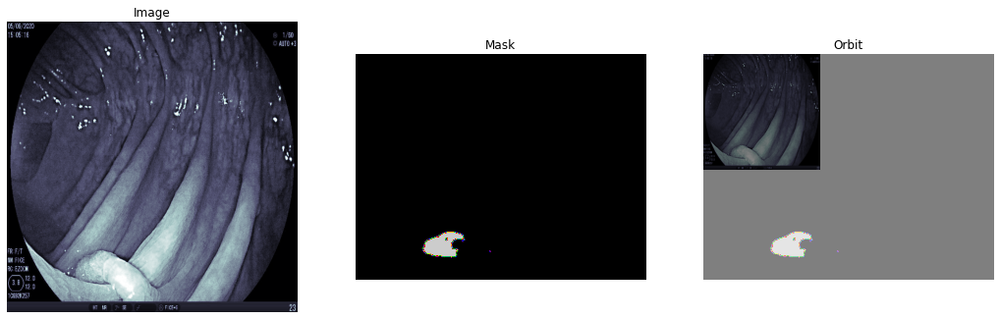

 46%|███████████████████▌                      | 93/200 [00:37<00:42,  2.52it/s]

2 0


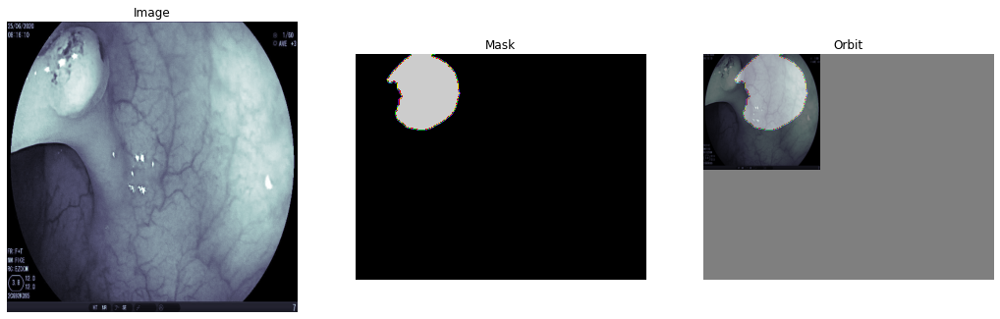

 47%|███████████████████▋                      | 94/200 [00:38<00:42,  2.51it/s]

1 0


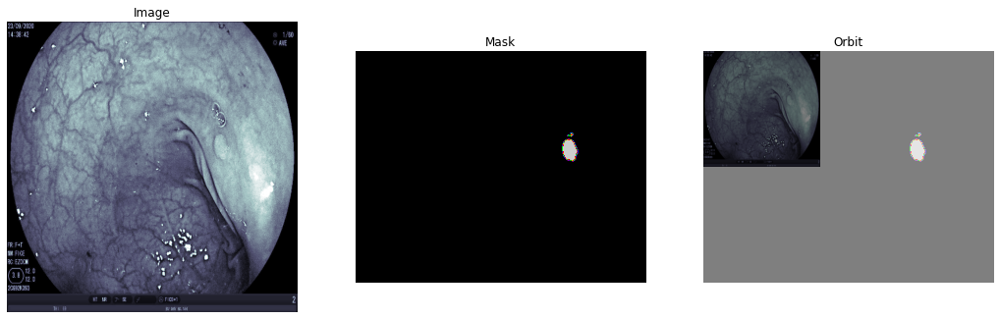

 48%|███████████████████▉                      | 95/200 [00:38<00:42,  2.50it/s]

1 0


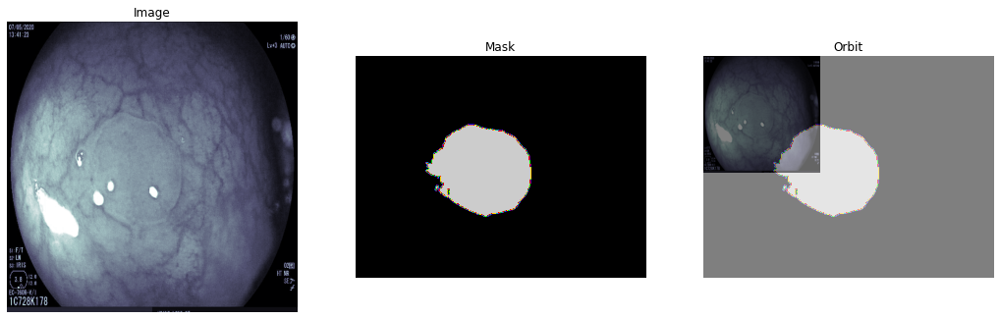

 48%|████████████████████▏                     | 96/200 [00:39<00:41,  2.48it/s]

1 0


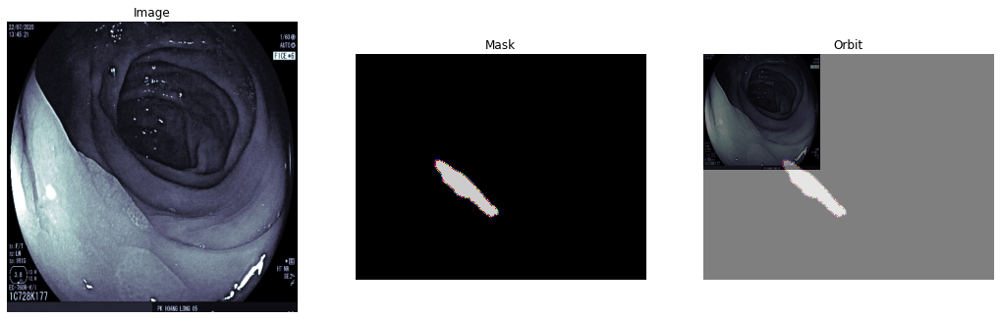

 48%|████████████████████▎                     | 97/200 [00:39<00:41,  2.46it/s]

2 0


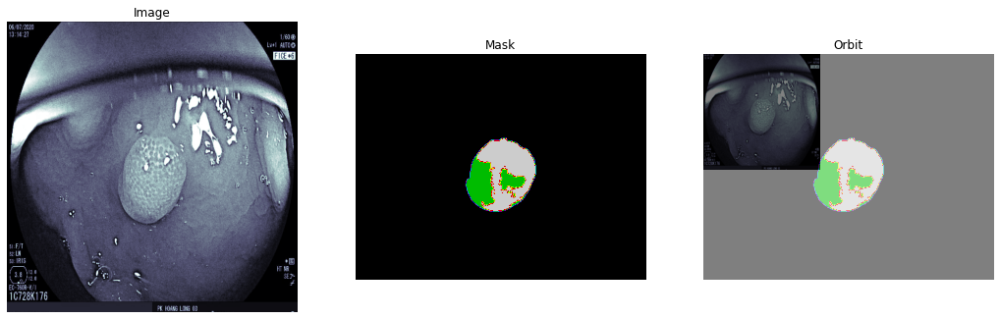

 49%|████████████████████▌                     | 98/200 [00:40<00:42,  2.39it/s]

2 0


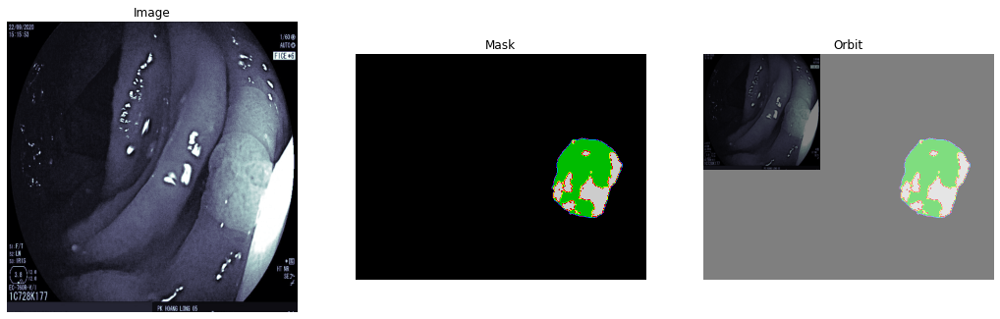

 50%|████████████████████▊                     | 99/200 [00:40<00:41,  2.42it/s]

2 0


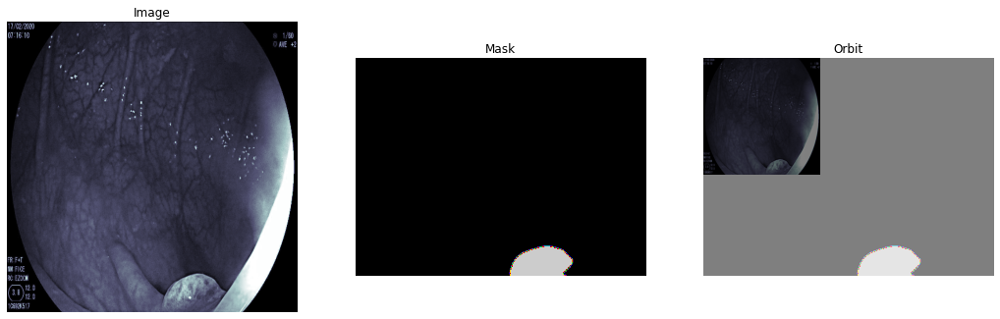

 50%|████████████████████▌                    | 100/200 [00:40<00:40,  2.46it/s]

2 0


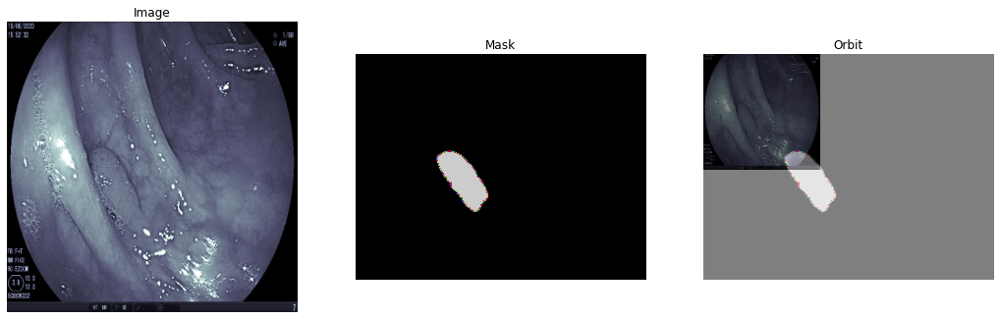

 50%|████████████████████▋                    | 101/200 [00:41<00:40,  2.46it/s]

2 0


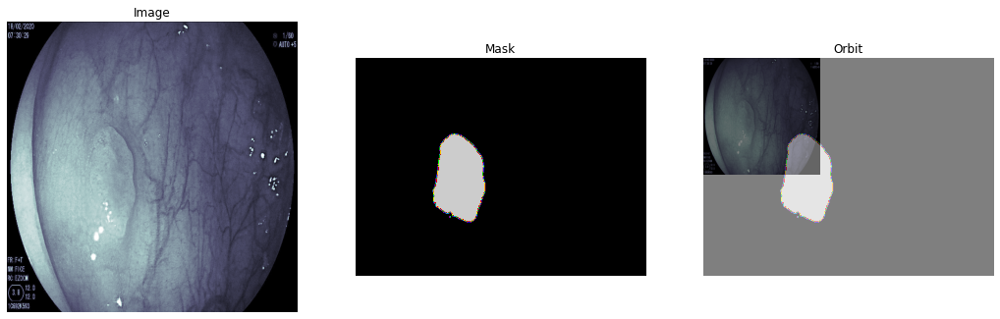

 51%|████████████████████▉                    | 102/200 [00:41<00:39,  2.48it/s]

2 0


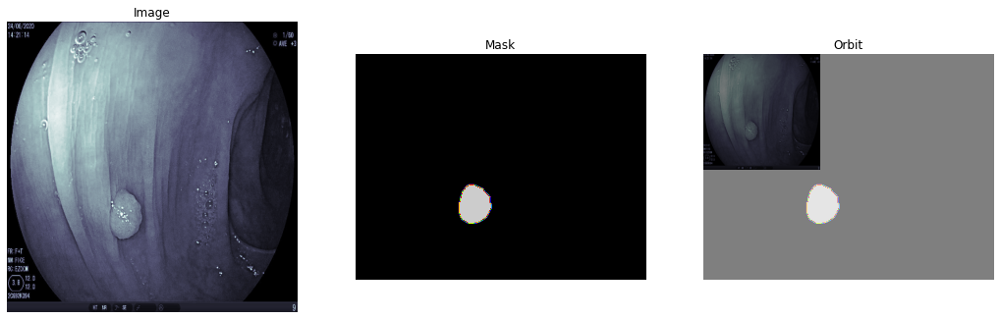

 52%|█████████████████████                    | 103/200 [00:42<00:38,  2.49it/s]

2 0


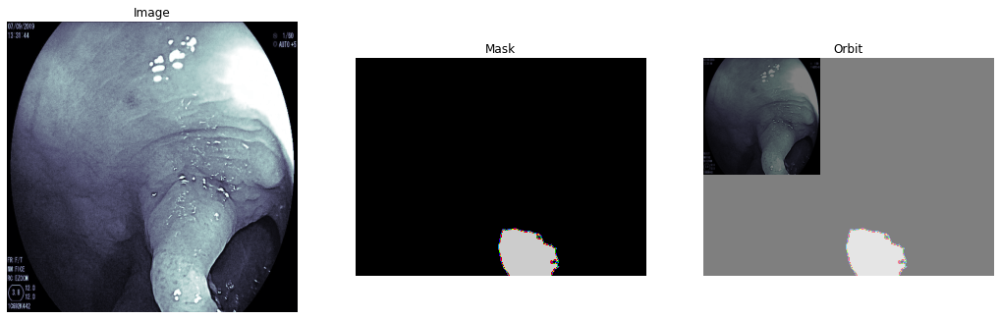

 52%|█████████████████████▎                   | 104/200 [00:42<00:38,  2.51it/s]

2 0


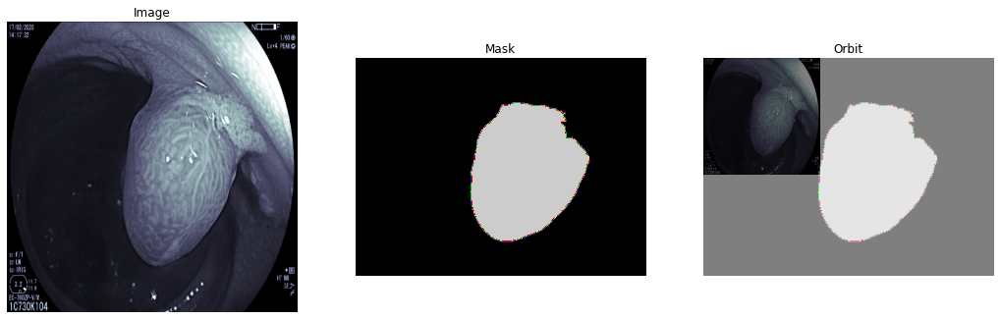

 52%|█████████████████████▌                   | 105/200 [00:42<00:37,  2.52it/s]

1 0


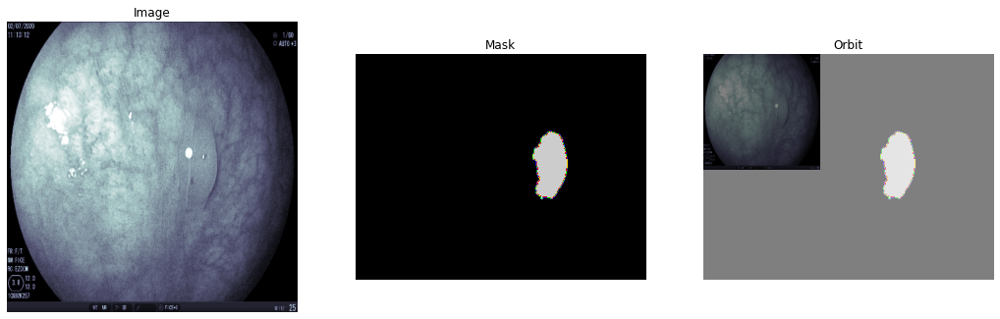

 53%|█████████████████████▋                   | 106/200 [00:43<00:37,  2.53it/s]

2 0


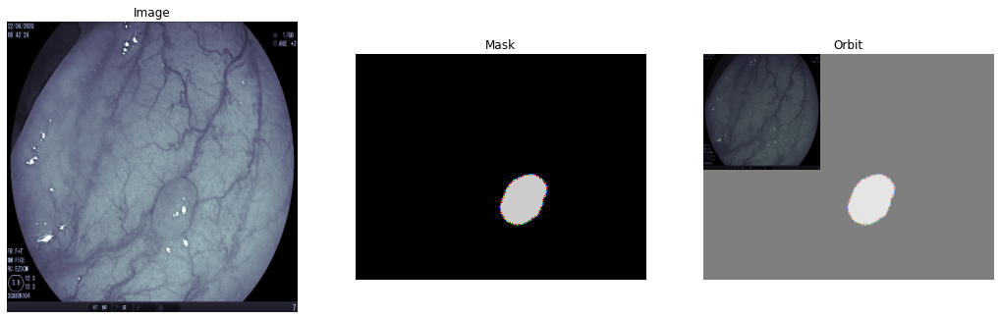

 54%|█████████████████████▉                   | 107/200 [00:43<00:42,  2.17it/s]

1 0


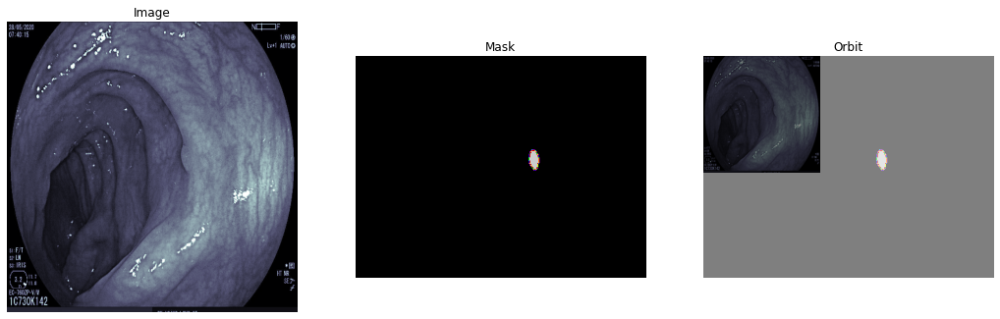

 54%|██████████████████████▏                  | 108/200 [00:44<00:40,  2.26it/s]

1 0


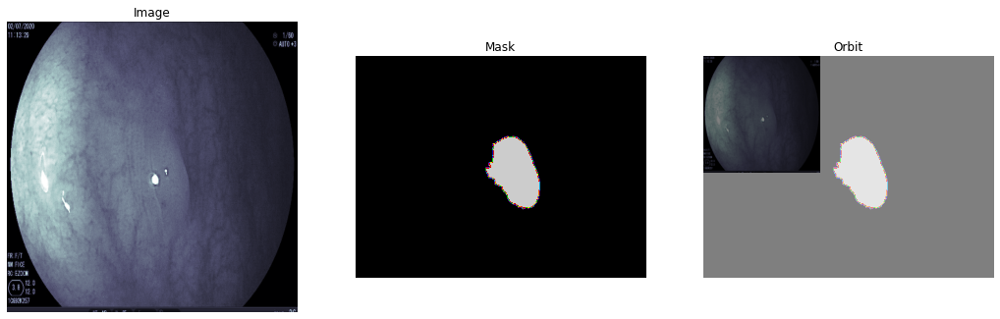

 55%|██████████████████████▎                  | 109/200 [00:44<00:38,  2.34it/s]

2 0


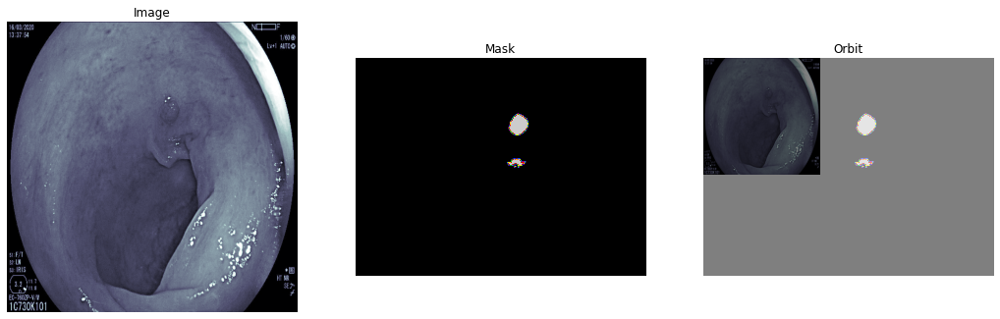

 55%|██████████████████████▌                  | 110/200 [00:45<00:37,  2.41it/s]

2 0


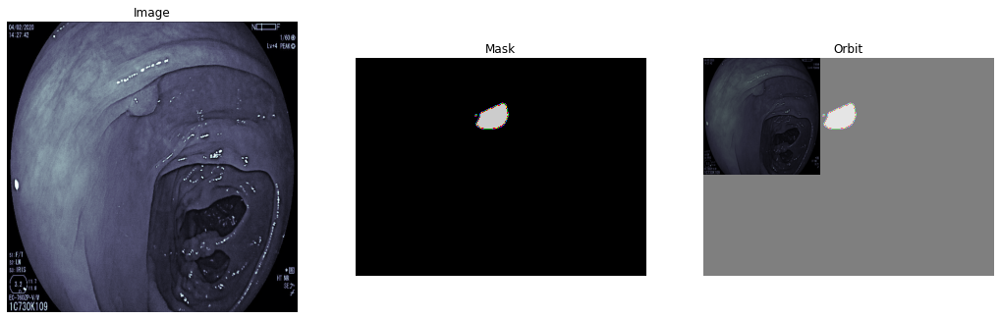

 56%|██████████████████████▊                  | 111/200 [00:45<00:36,  2.46it/s]

2 0


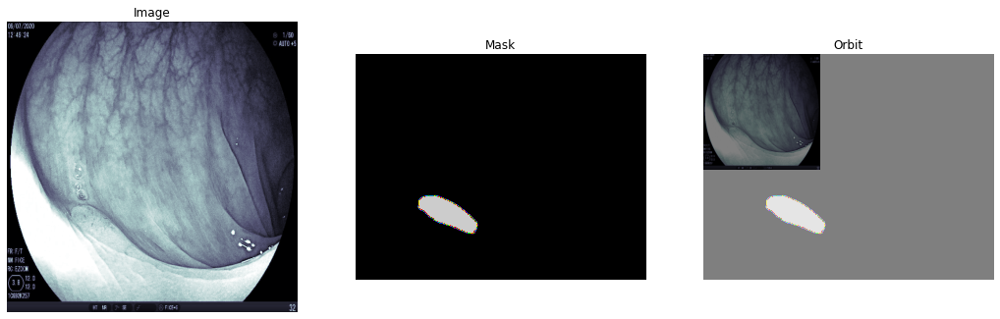

 56%|██████████████████████▉                  | 112/200 [00:45<00:35,  2.49it/s]

2 0


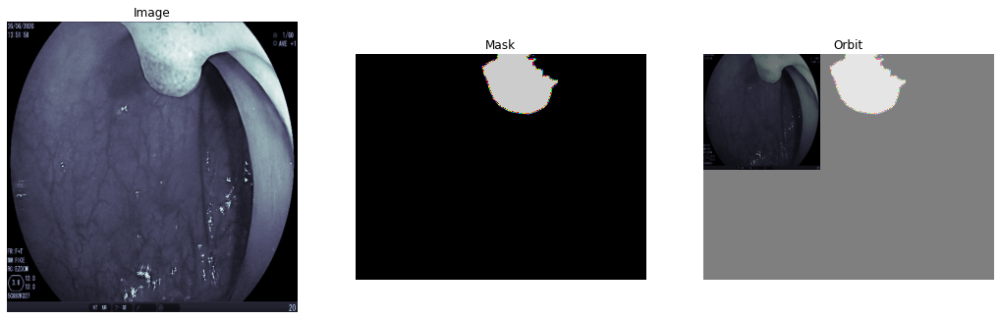

 56%|███████████████████████▏                 | 113/200 [00:46<00:34,  2.50it/s]

2 0


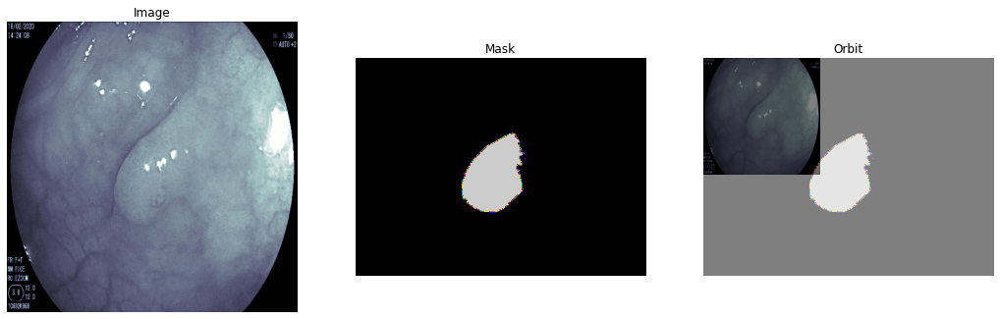

 57%|███████████████████████▎                 | 114/200 [00:46<00:34,  2.52it/s]

1 0


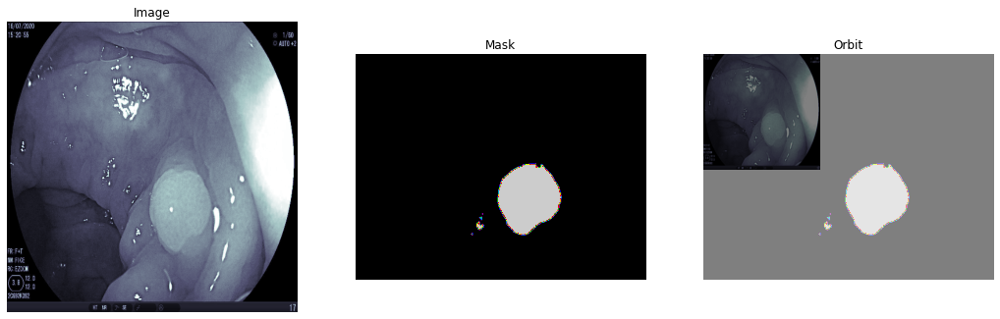

 57%|███████████████████████▌                 | 115/200 [00:46<00:33,  2.54it/s]

2 0


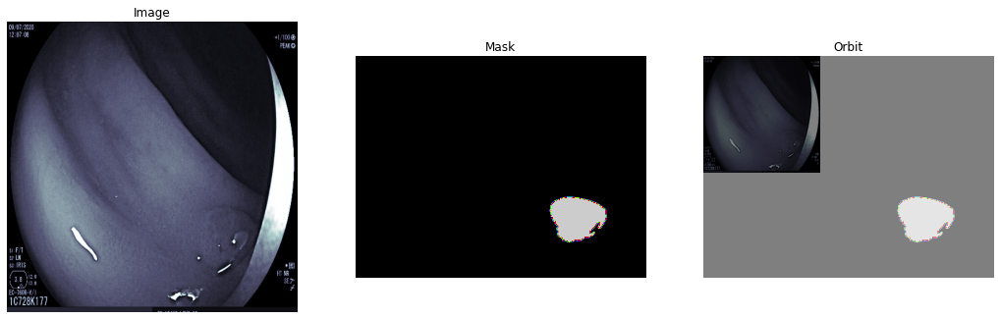

 58%|███████████████████████▊                 | 116/200 [00:47<00:32,  2.55it/s]

2 0


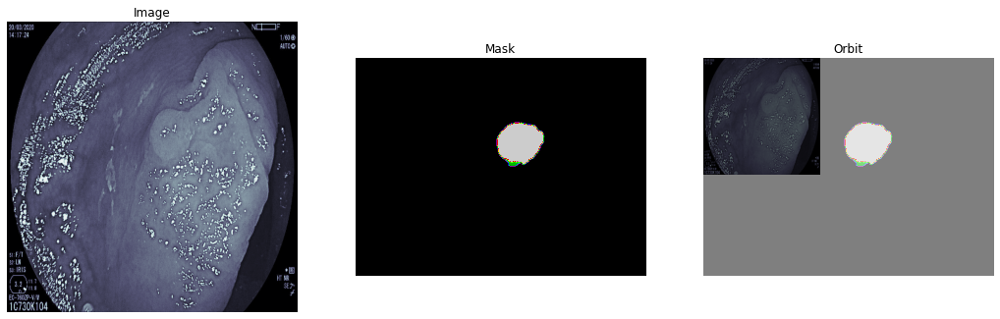

 58%|███████████████████████▉                 | 117/200 [00:47<00:32,  2.54it/s]

1 0


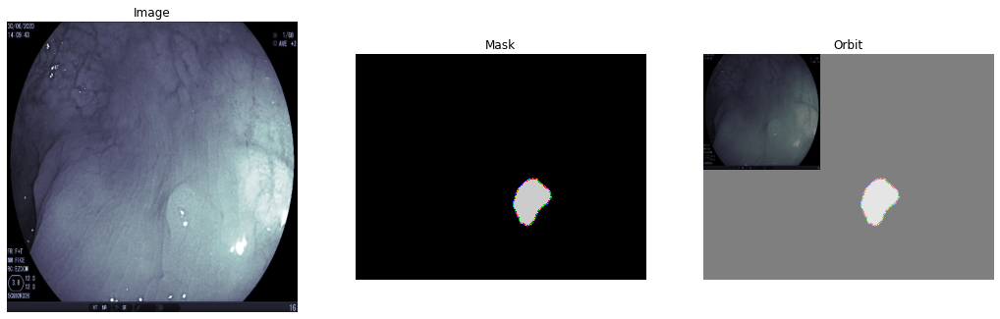

 59%|████████████████████████▏                | 118/200 [00:48<00:32,  2.54it/s]

2 0


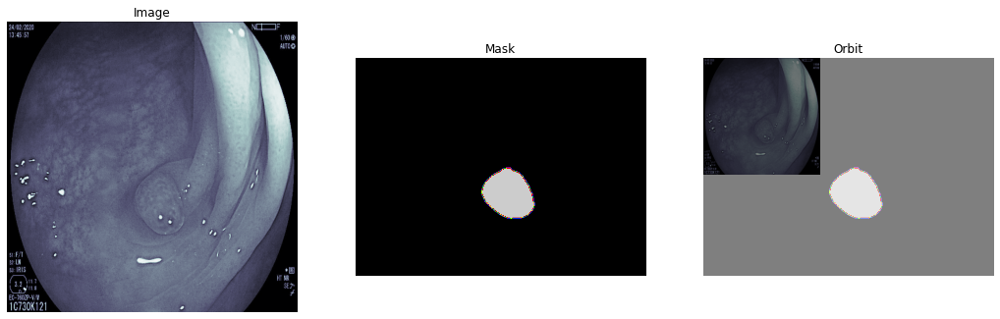

 60%|████████████████████████▍                | 119/200 [00:48<00:31,  2.55it/s]

2 0


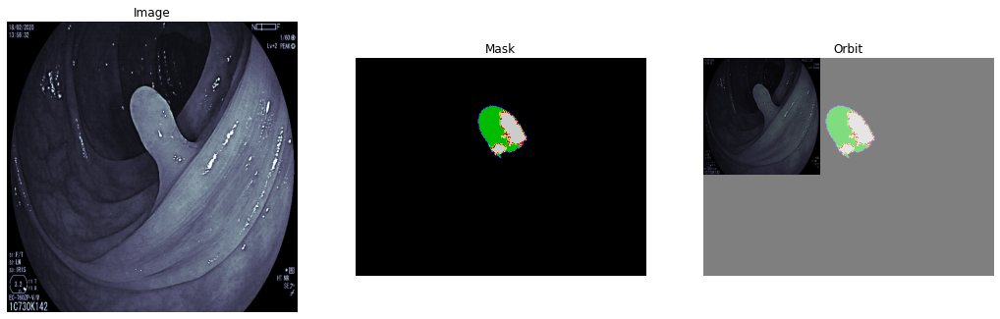

 60%|████████████████████████▌                | 120/200 [00:48<00:31,  2.56it/s]

2 0


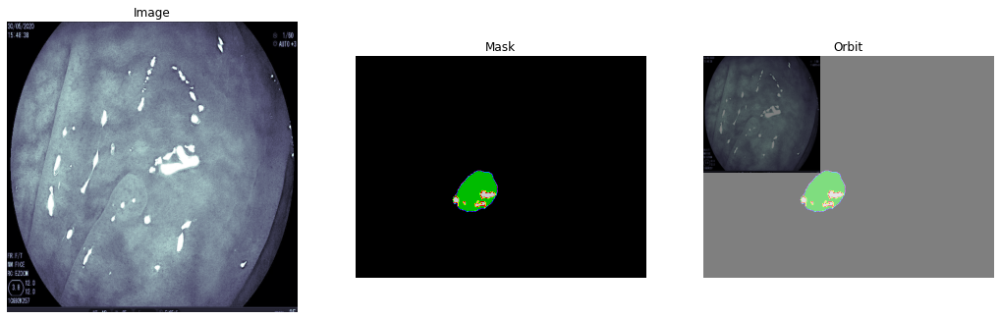

 60%|████████████████████████▊                | 121/200 [00:49<00:30,  2.57it/s]

1 0


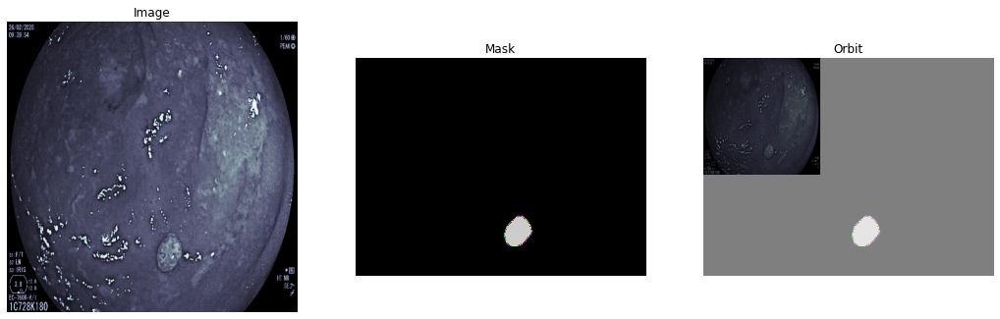

 61%|█████████████████████████                | 122/200 [00:49<00:30,  2.57it/s]

2 0


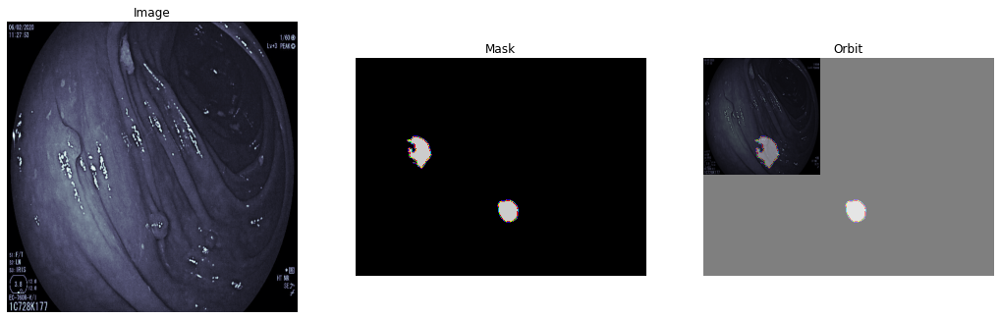

 62%|█████████████████████████▏               | 123/200 [00:50<00:30,  2.56it/s]

2 0


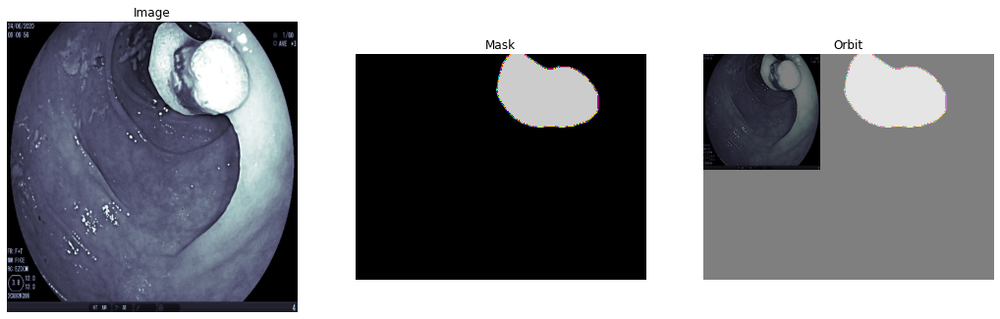

 62%|█████████████████████████▍               | 124/200 [00:50<00:29,  2.55it/s]

1 0


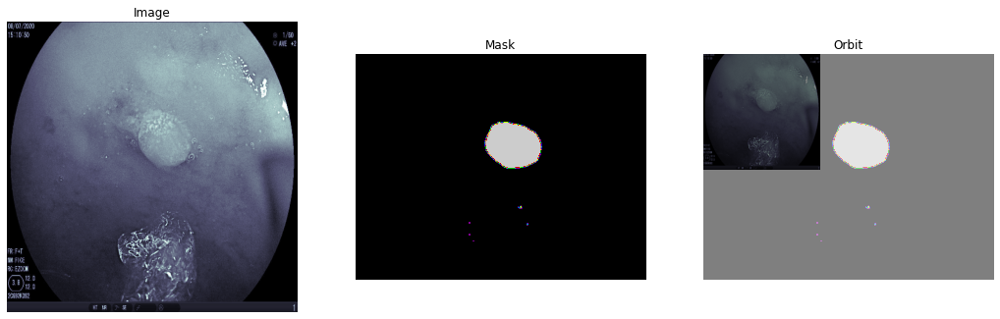

 62%|█████████████████████████▋               | 125/200 [00:50<00:29,  2.52it/s]

2 0


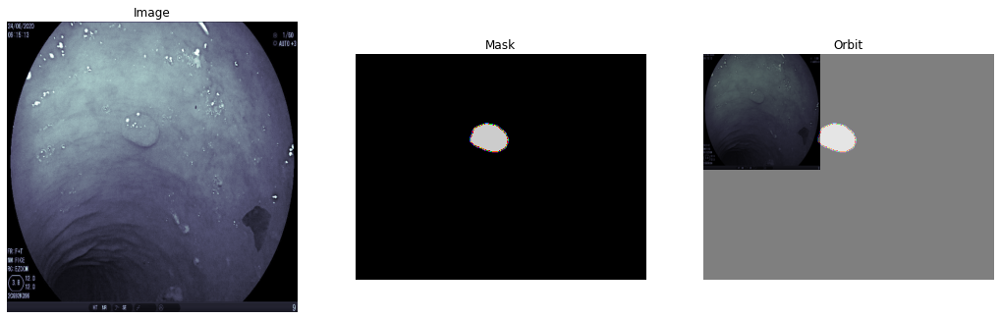

 63%|█████████████████████████▊               | 126/200 [00:51<00:29,  2.53it/s]

1 0


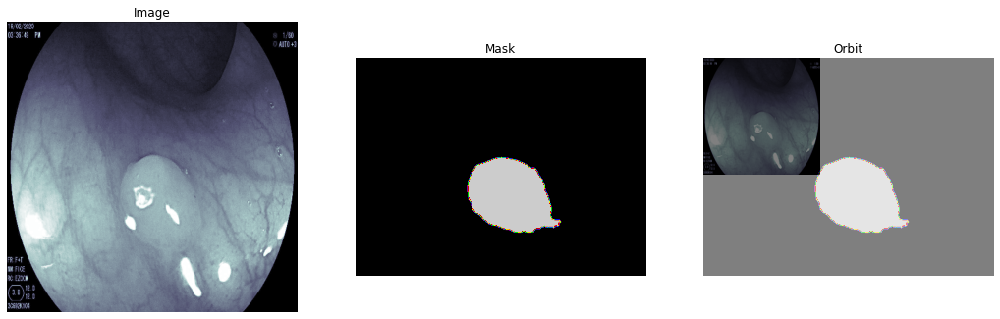

 64%|██████████████████████████               | 127/200 [00:51<00:28,  2.53it/s]

2 0


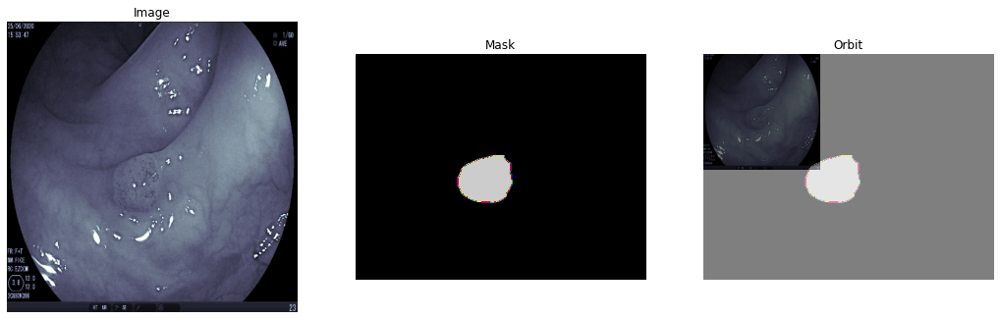

 64%|██████████████████████████▏              | 128/200 [00:52<00:28,  2.51it/s]

2 0


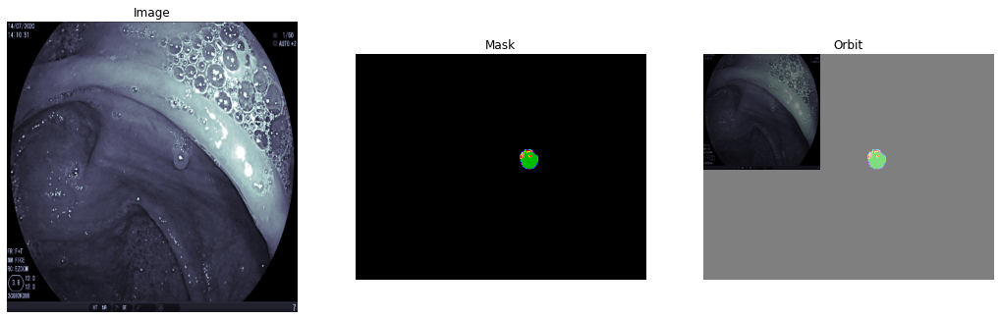

 64%|██████████████████████████▍              | 129/200 [00:52<00:28,  2.52it/s]

2 0


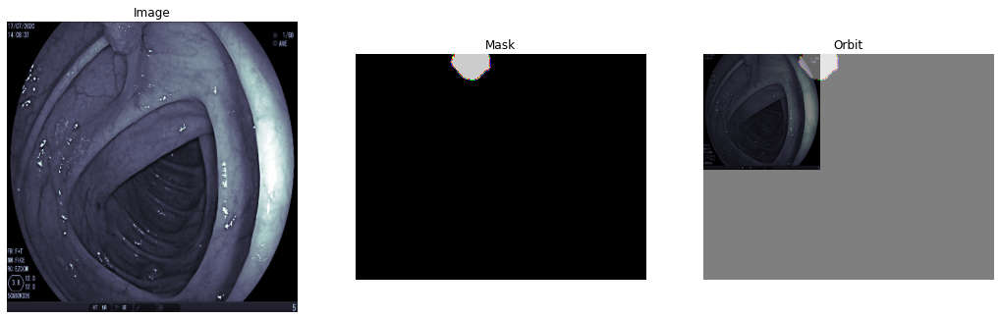

 65%|██████████████████████████▋              | 130/200 [00:53<00:33,  2.11it/s]

2 0


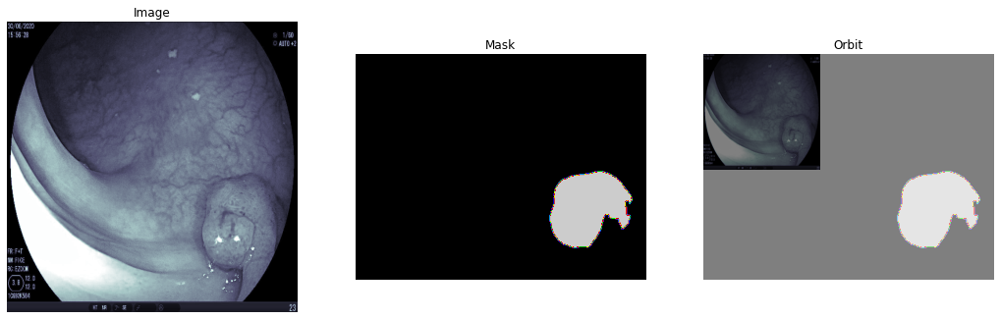

 66%|██████████████████████████▊              | 131/200 [00:53<00:31,  2.22it/s]

2 0


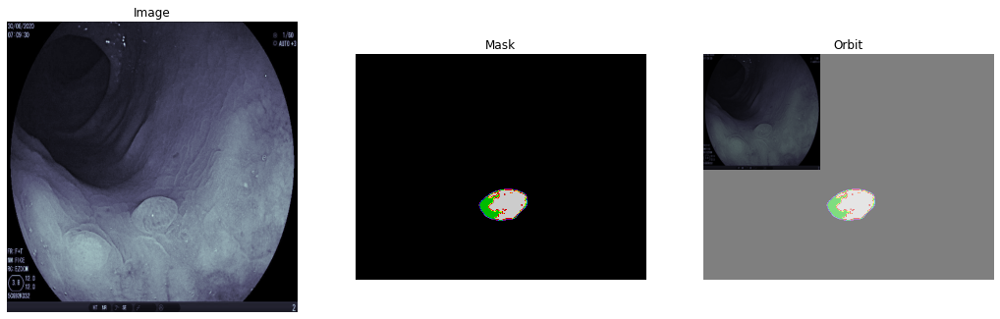

 66%|███████████████████████████              | 132/200 [00:53<00:29,  2.28it/s]

1 0


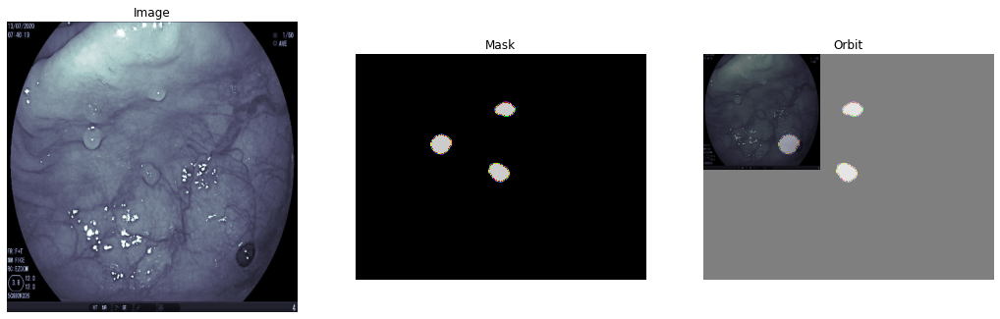

 66%|███████████████████████████▎             | 133/200 [00:54<00:28,  2.33it/s]

2 0


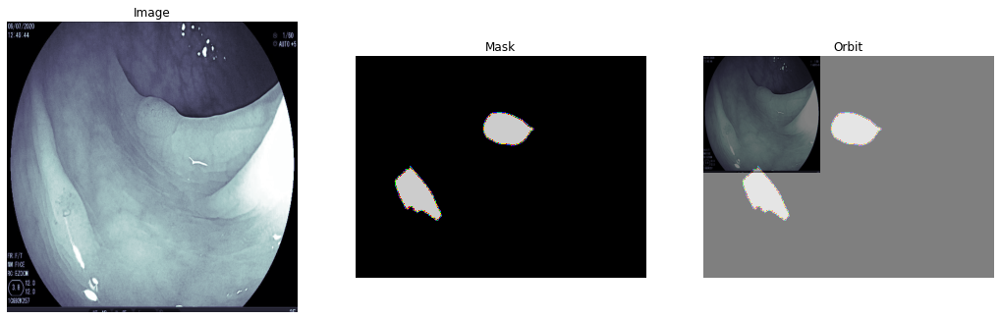

 67%|███████████████████████████▍             | 134/200 [00:54<00:27,  2.38it/s]

2 0


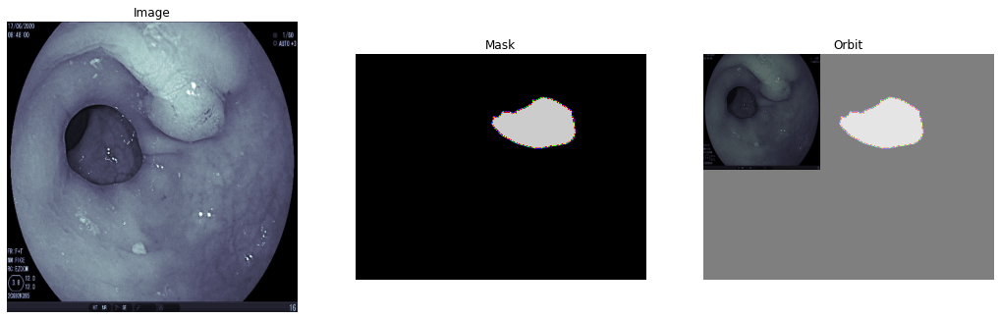

 68%|███████████████████████████▋             | 135/200 [00:55<00:26,  2.41it/s]

1 0


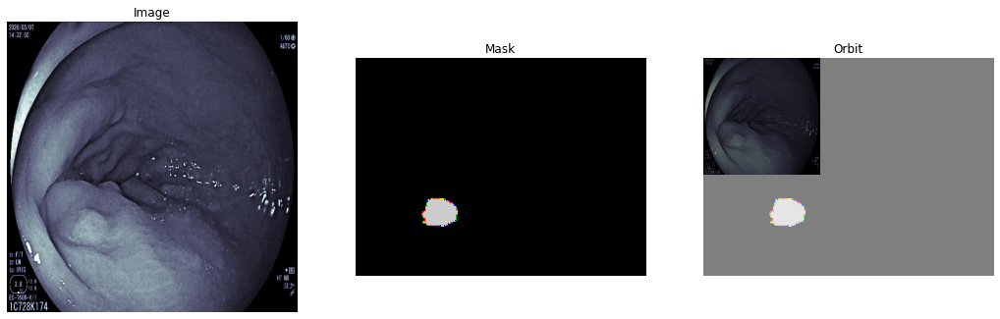

 68%|███████████████████████████▉             | 136/200 [00:55<00:26,  2.45it/s]

1 0


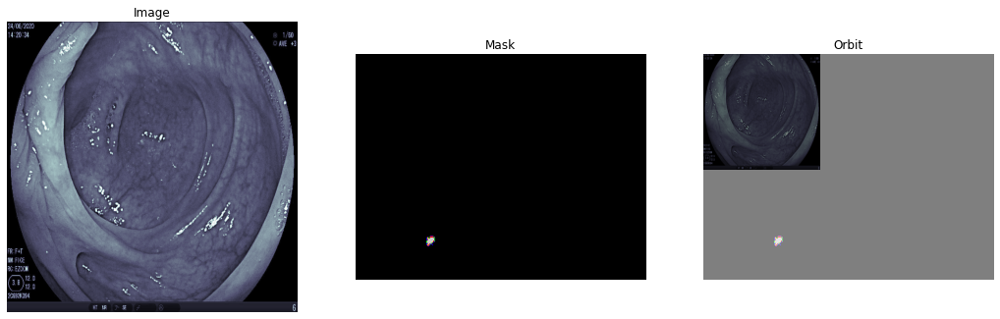

 68%|████████████████████████████             | 137/200 [00:55<00:25,  2.45it/s]

2 0


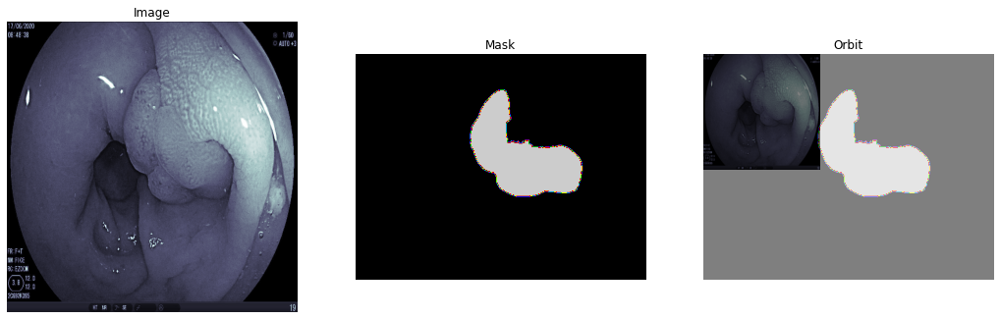

 69%|████████████████████████████▎            | 138/200 [00:56<00:25,  2.44it/s]

1 0


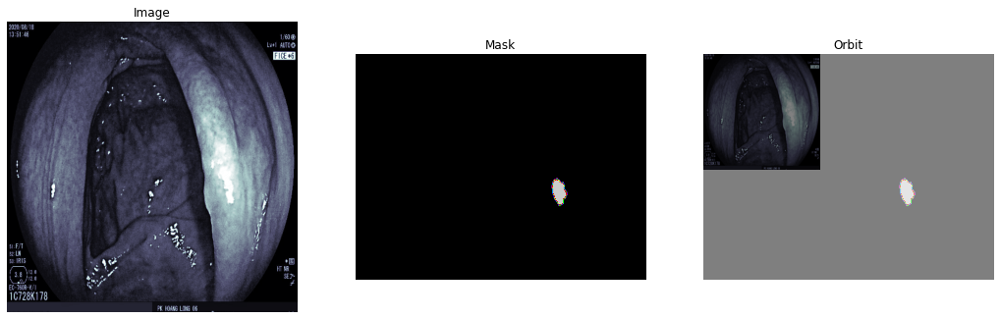

 70%|████████████████████████████▍            | 139/200 [00:56<00:25,  2.41it/s]

2 0


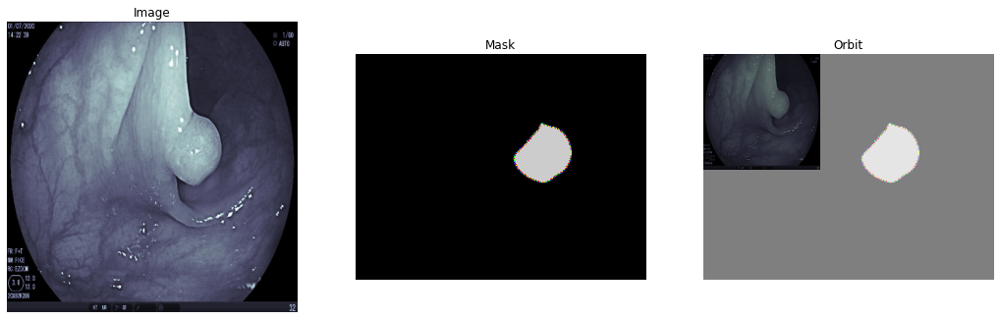

 70%|████████████████████████████▋            | 140/200 [00:57<00:24,  2.42it/s]

2 0


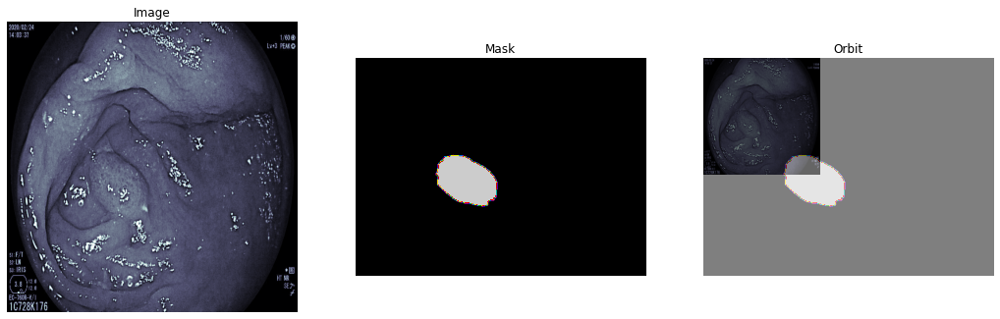

 70%|████████████████████████████▉            | 141/200 [00:57<00:23,  2.46it/s]

2 0


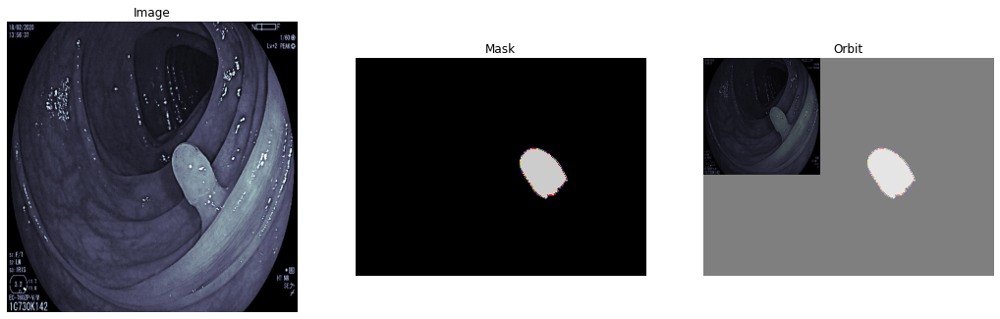

 71%|█████████████████████████████            | 142/200 [00:57<00:23,  2.50it/s]

2 0


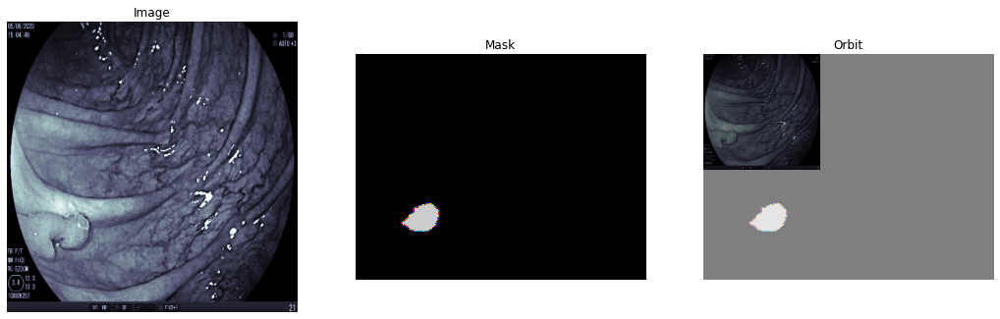

 72%|█████████████████████████████▎           | 143/200 [00:58<00:23,  2.47it/s]

2 0


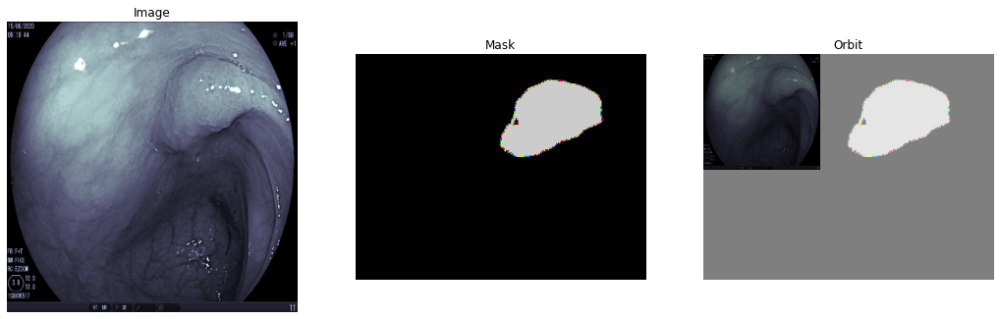

 72%|█████████████████████████████▌           | 144/200 [00:58<00:22,  2.49it/s]

1 0


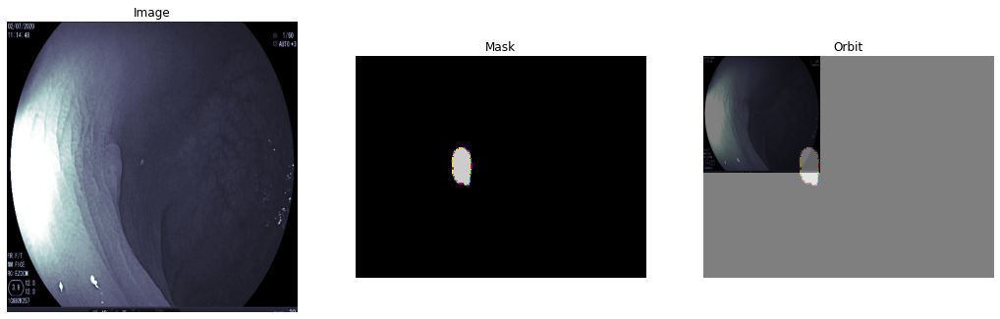

 72%|█████████████████████████████▋           | 145/200 [00:59<00:21,  2.51it/s]

2 0


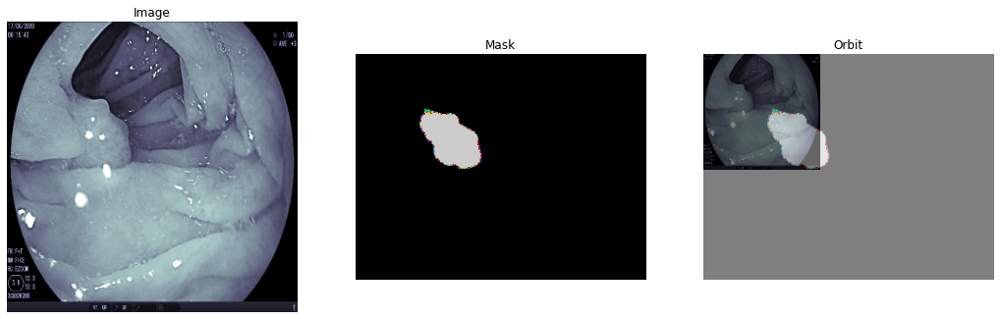

 73%|█████████████████████████████▉           | 146/200 [00:59<00:21,  2.47it/s]

2 0


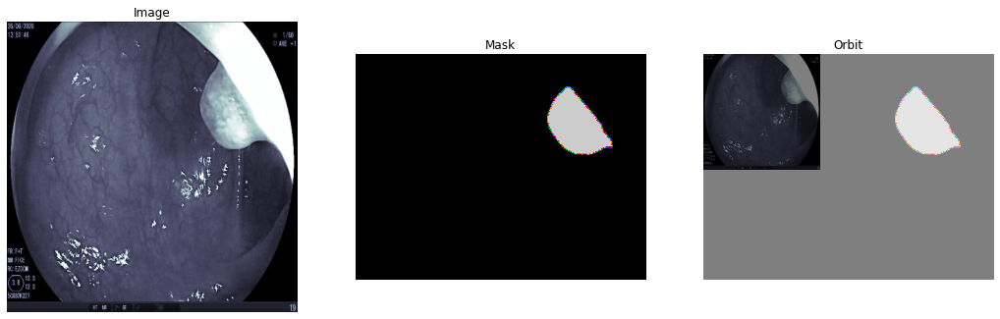

 74%|██████████████████████████████▏          | 147/200 [00:59<00:21,  2.50it/s]

2 0


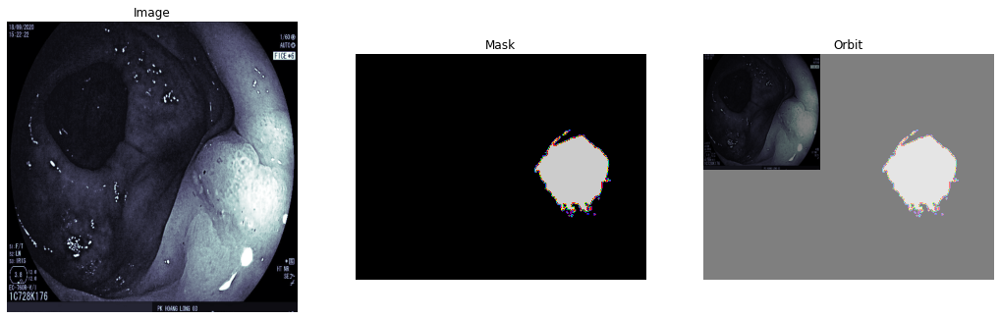

 74%|██████████████████████████████▎          | 148/200 [01:00<00:20,  2.52it/s]

2 0


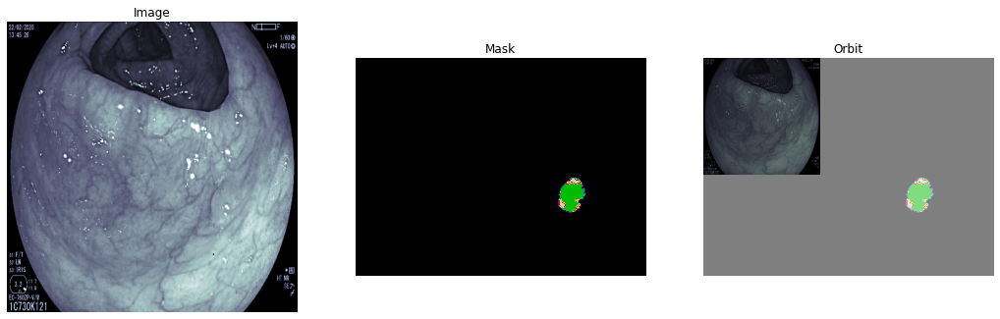

 74%|██████████████████████████████▌          | 149/200 [01:00<00:20,  2.54it/s]

2 0


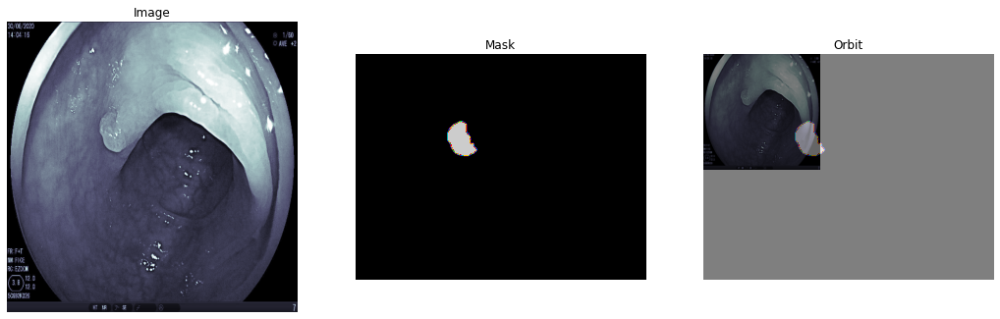

 75%|██████████████████████████████▊          | 150/200 [01:01<00:19,  2.55it/s]

2 0


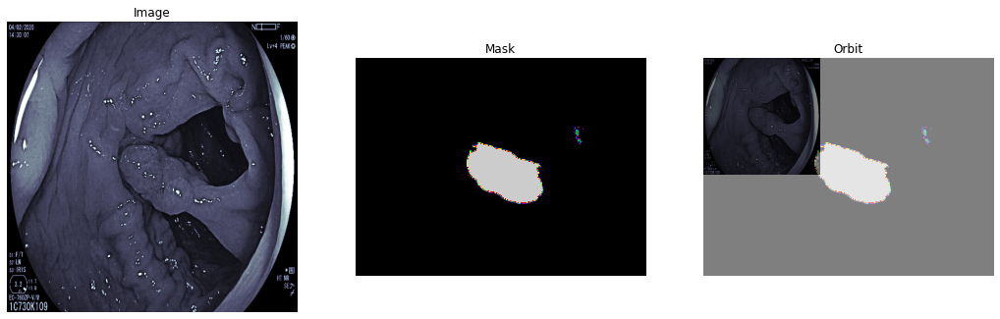

 76%|██████████████████████████████▉          | 151/200 [01:01<00:19,  2.55it/s]

2 0


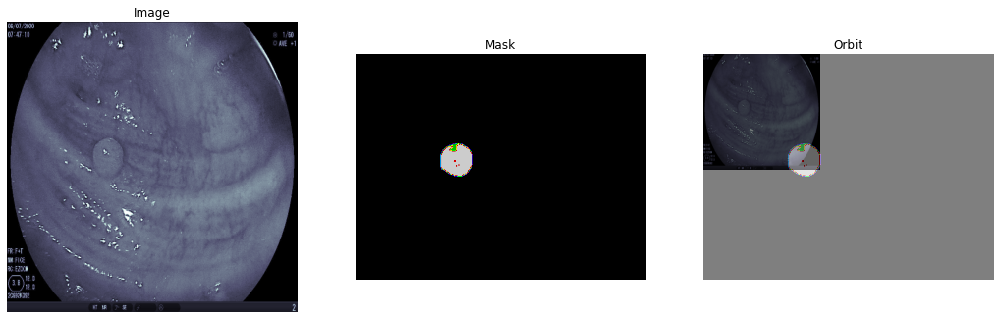

 76%|███████████████████████████████▏         | 152/200 [01:01<00:18,  2.55it/s]

2 0


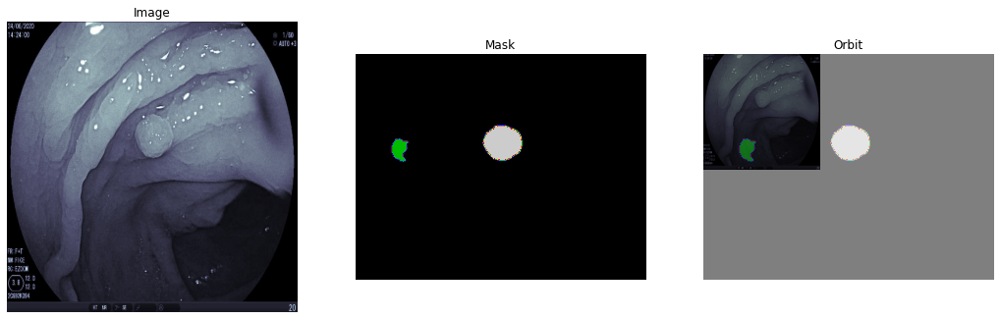

 76%|███████████████████████████████▎         | 153/200 [01:02<00:21,  2.16it/s]

2 0


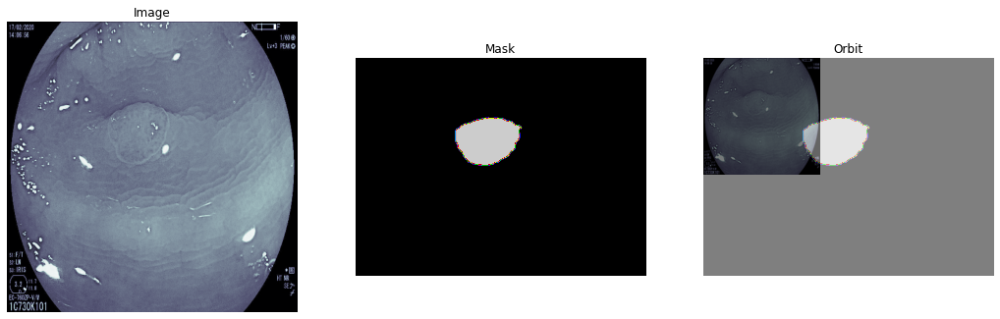

 77%|███████████████████████████████▌         | 154/200 [01:02<00:20,  2.27it/s]

2 0


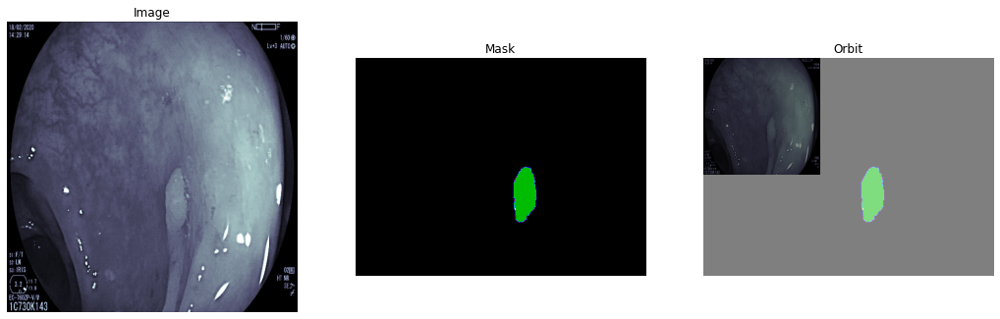

 78%|███████████████████████████████▊         | 155/200 [01:03<00:19,  2.35it/s]

2 0


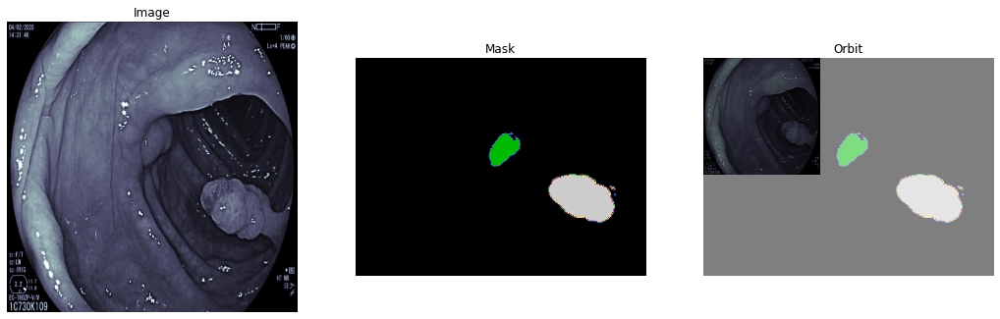

 78%|███████████████████████████████▉         | 156/200 [01:03<00:18,  2.41it/s]

2 0


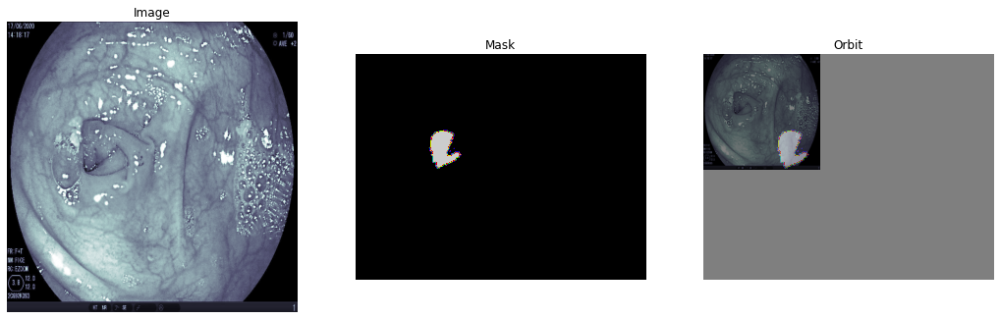

 78%|████████████████████████████████▏        | 157/200 [01:04<00:17,  2.44it/s]

2 0


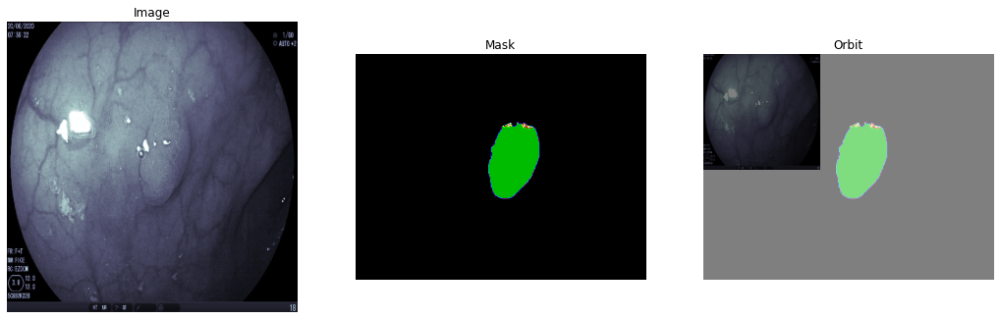

 79%|████████████████████████████████▍        | 158/200 [01:04<00:17,  2.46it/s]

2 0


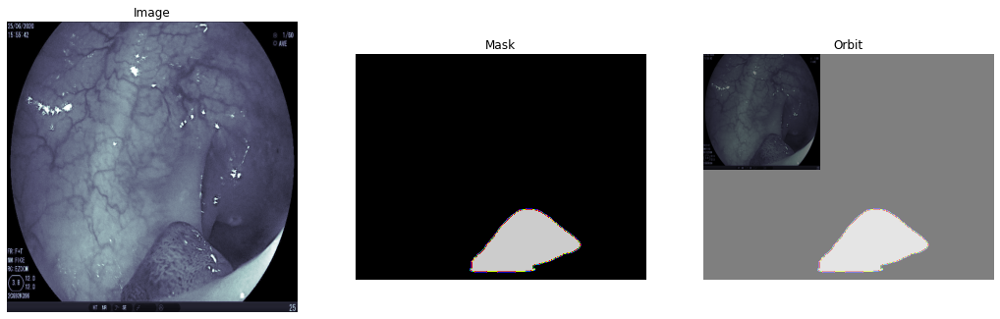

 80%|████████████████████████████████▌        | 159/200 [01:04<00:16,  2.47it/s]

1 0


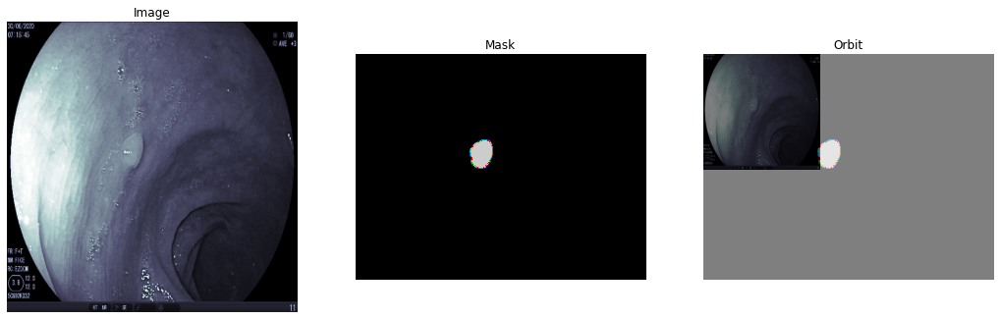

 80%|████████████████████████████████▊        | 160/200 [01:05<00:16,  2.50it/s]

2 0


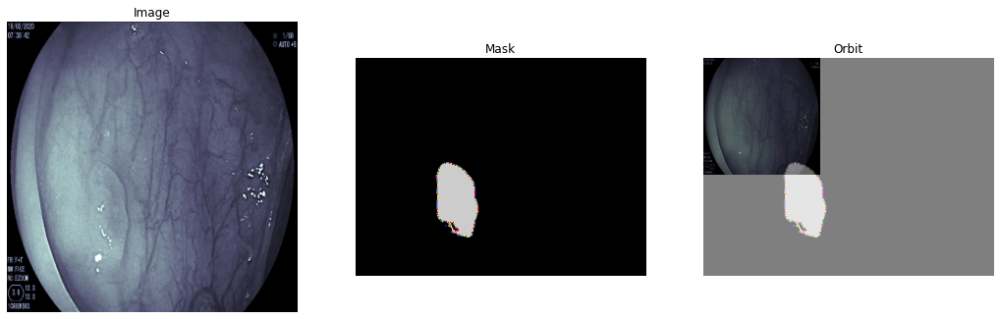

 80%|█████████████████████████████████        | 161/200 [01:05<00:15,  2.52it/s]

2 0


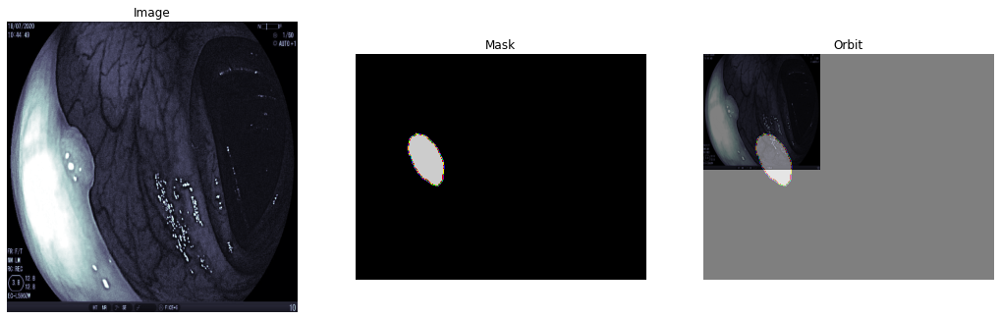

 81%|█████████████████████████████████▏       | 162/200 [01:06<00:15,  2.53it/s]

2 0


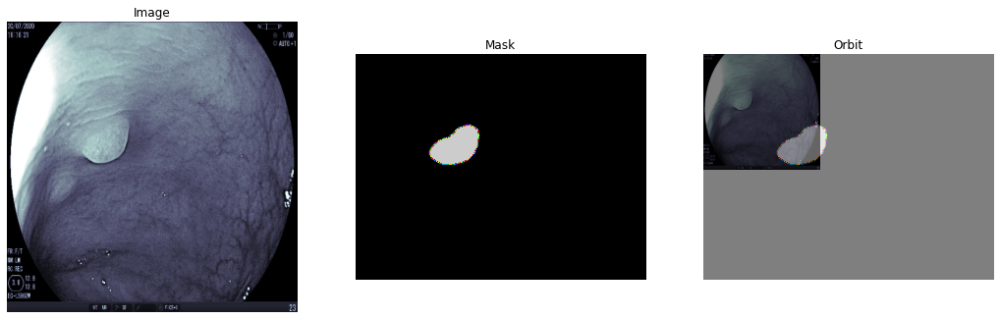

 82%|█████████████████████████████████▍       | 163/200 [01:06<00:14,  2.54it/s]

2 0


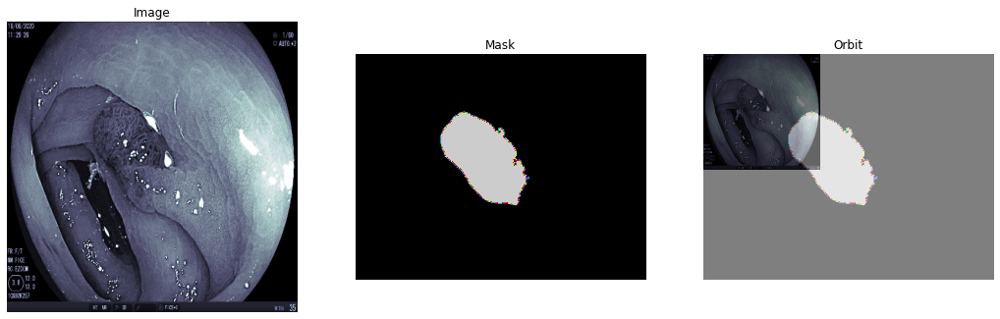

 82%|█████████████████████████████████▌       | 164/200 [01:06<00:14,  2.51it/s]

2 0


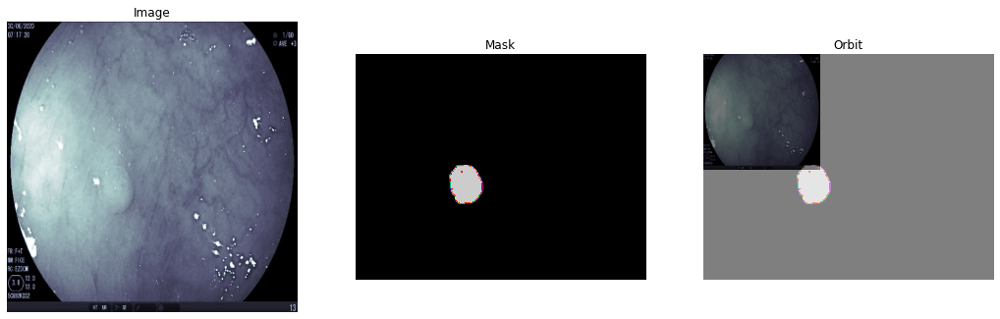

 82%|█████████████████████████████████▊       | 165/200 [01:07<00:13,  2.52it/s]

1 0


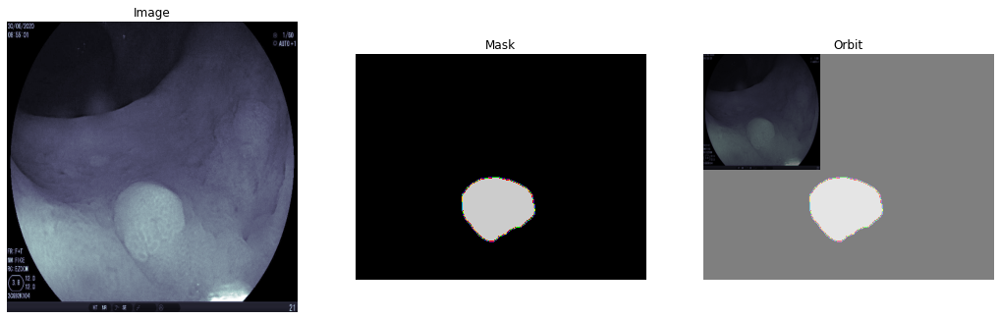

 83%|██████████████████████████████████       | 166/200 [01:07<00:13,  2.52it/s]

2 0


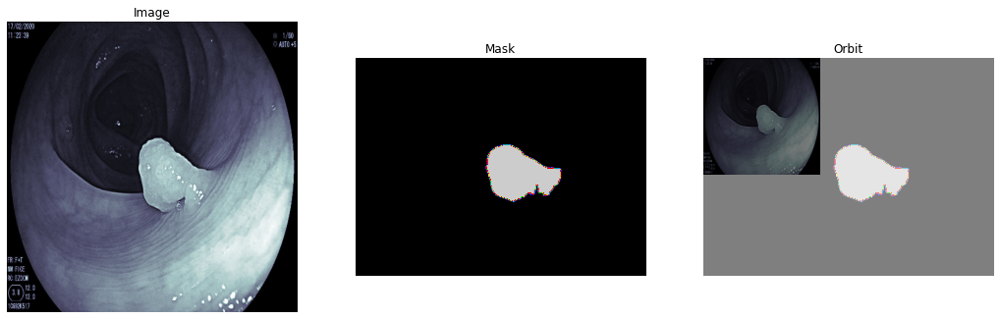

 84%|██████████████████████████████████▏      | 167/200 [01:08<00:13,  2.52it/s]

1 0


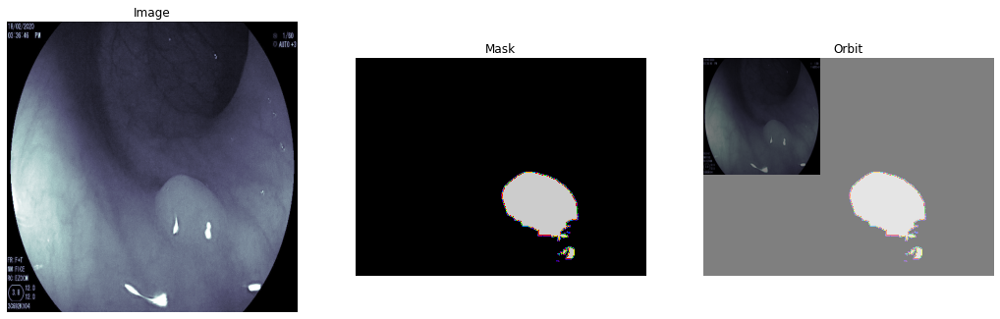

 84%|██████████████████████████████████▍      | 168/200 [01:08<00:12,  2.53it/s]

1 0


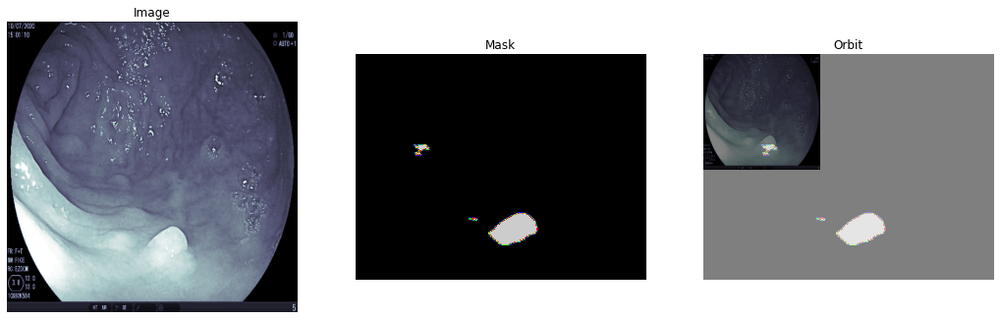

 84%|██████████████████████████████████▋      | 169/200 [01:08<00:12,  2.53it/s]

2 0


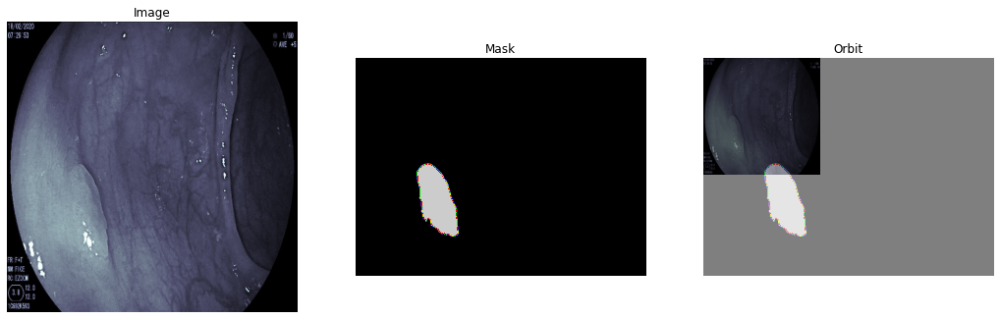

 85%|██████████████████████████████████▊      | 170/200 [01:09<00:11,  2.54it/s]

2 0


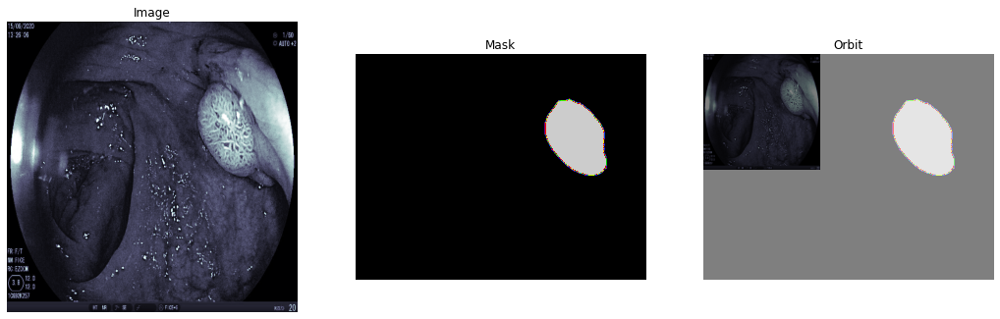

 86%|███████████████████████████████████      | 171/200 [01:09<00:11,  2.55it/s]

2 0


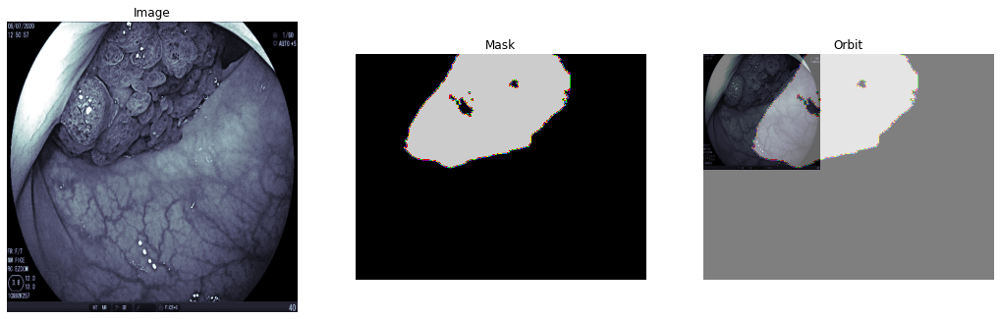

 86%|███████████████████████████████████▎     | 172/200 [01:10<00:11,  2.52it/s]

2 0


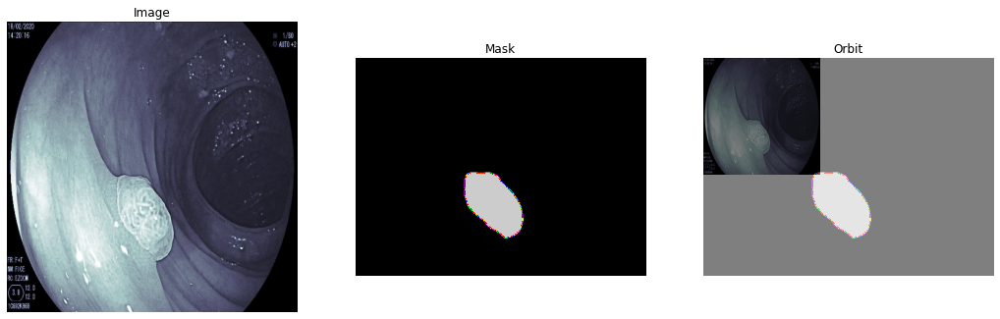

 86%|███████████████████████████████████▍     | 173/200 [01:10<00:10,  2.54it/s]

2 0


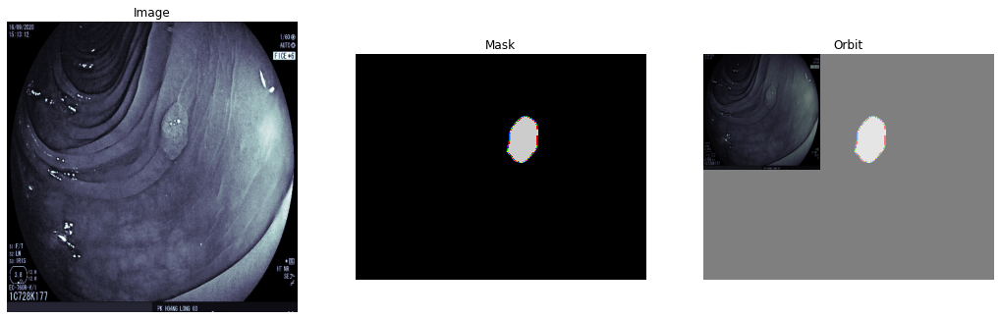

 87%|███████████████████████████████████▋     | 174/200 [01:10<00:10,  2.55it/s]

1 0


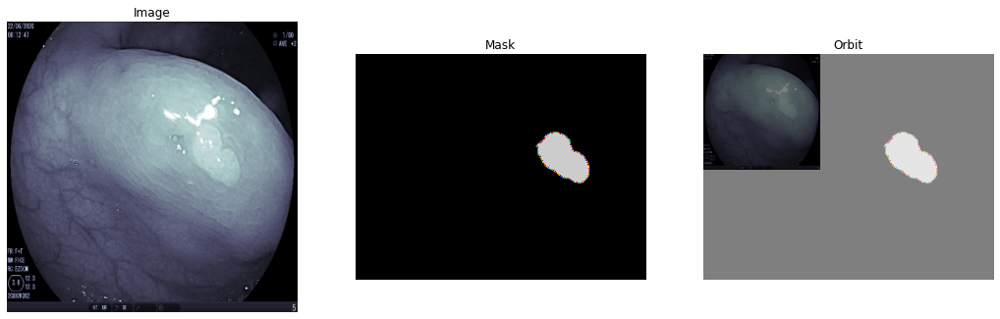

 88%|███████████████████████████████████▉     | 175/200 [01:11<00:09,  2.54it/s]

2 0


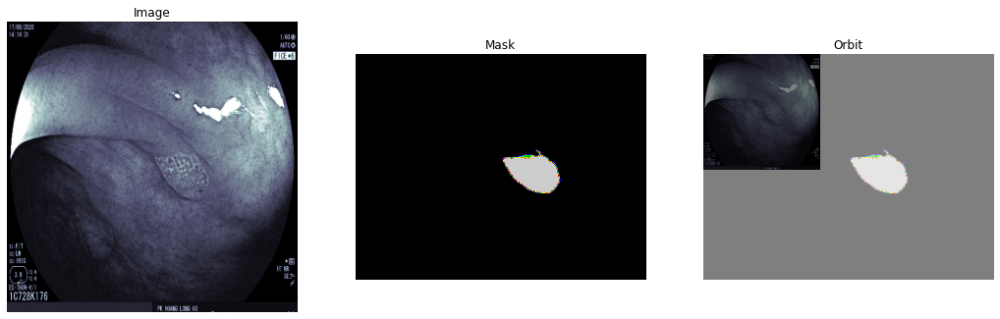

 88%|████████████████████████████████████     | 176/200 [01:11<00:11,  2.16it/s]

2 0


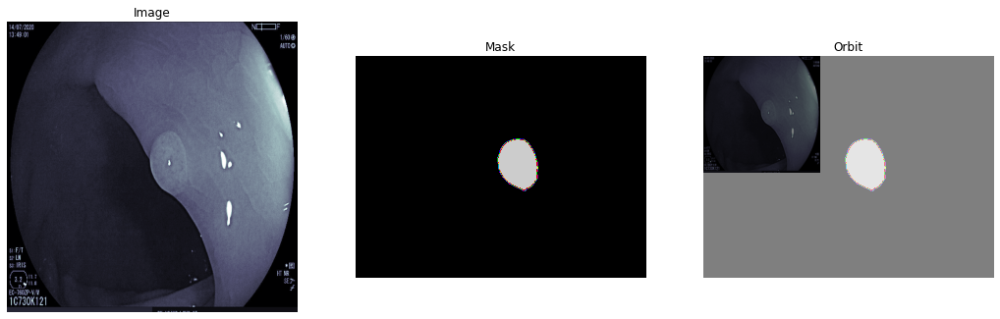

 88%|████████████████████████████████████▎    | 177/200 [01:12<00:10,  2.24it/s]

2 0


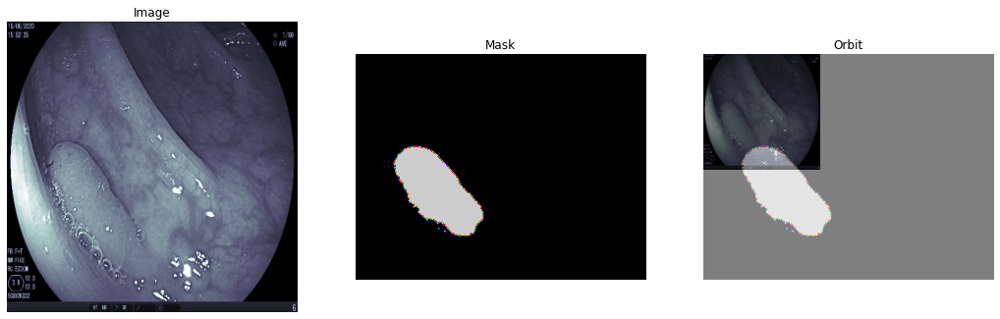

 89%|████████████████████████████████████▍    | 178/200 [01:12<00:09,  2.32it/s]

2 0


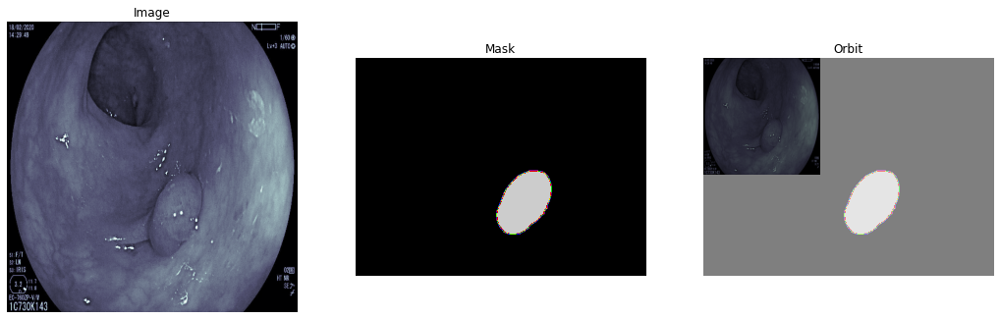

 90%|████████████████████████████████████▋    | 179/200 [01:13<00:08,  2.38it/s]

1 0


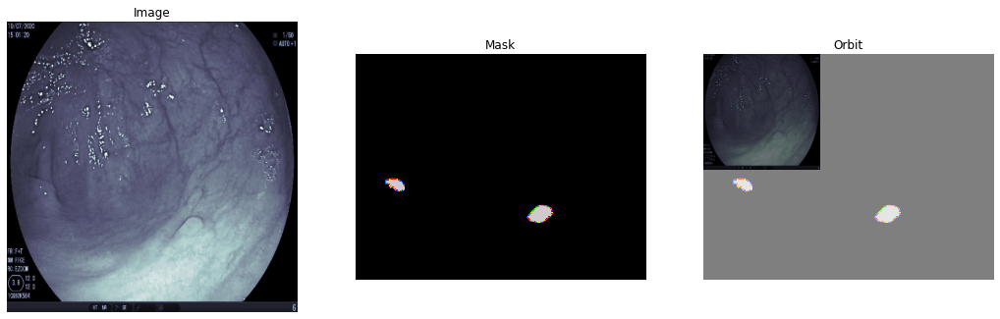

 90%|████████████████████████████████████▉    | 180/200 [01:13<00:08,  2.39it/s]

2 0


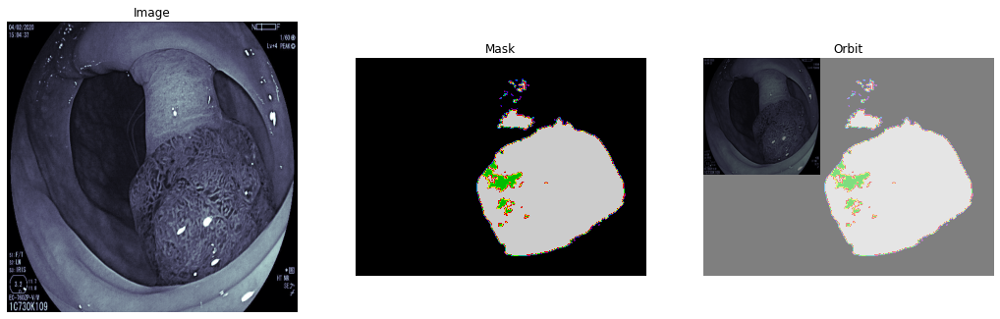

 90%|█████████████████████████████████████    | 181/200 [01:13<00:07,  2.43it/s]

1 0


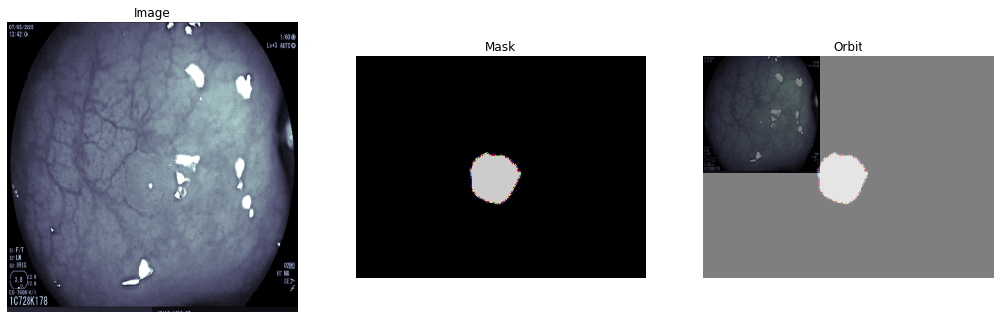

 91%|█████████████████████████████████████▎   | 182/200 [01:14<00:07,  2.46it/s]

2 0


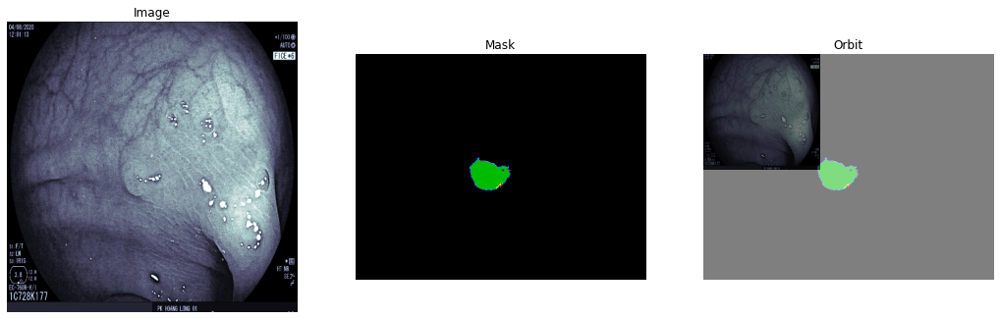

 92%|█████████████████████████████████████▌   | 183/200 [01:14<00:06,  2.48it/s]

2 0


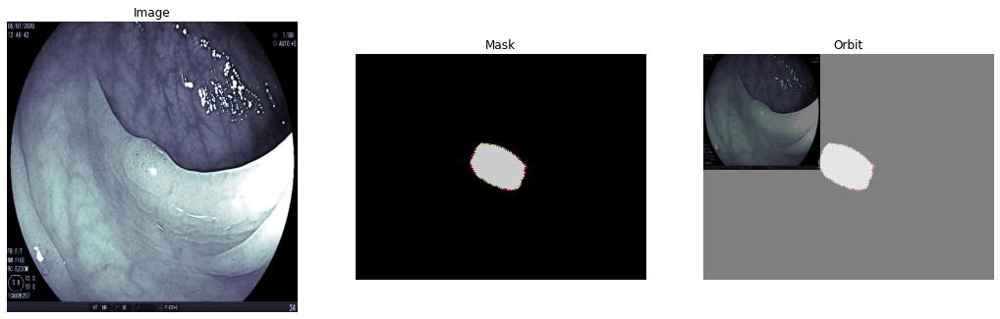

 92%|█████████████████████████████████████▋   | 184/200 [01:15<00:06,  2.50it/s]

2 0


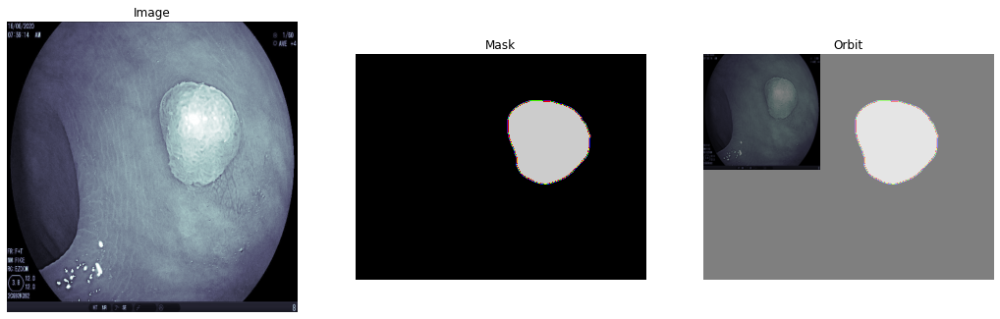

 92%|█████████████████████████████████████▉   | 185/200 [01:15<00:05,  2.51it/s]

2 0


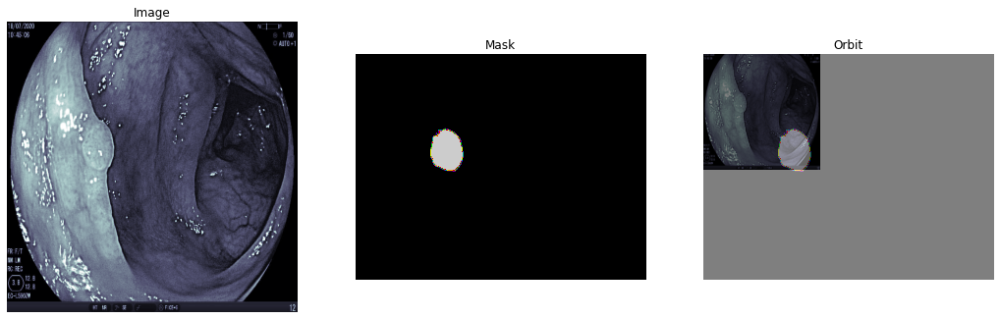

 93%|██████████████████████████████████████▏  | 186/200 [01:15<00:05,  2.52it/s]

2 0


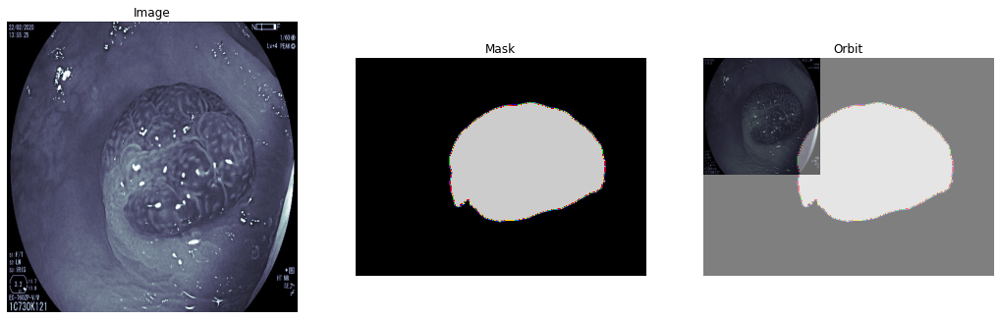

 94%|██████████████████████████████████████▎  | 187/200 [01:16<00:05,  2.53it/s]

2 0


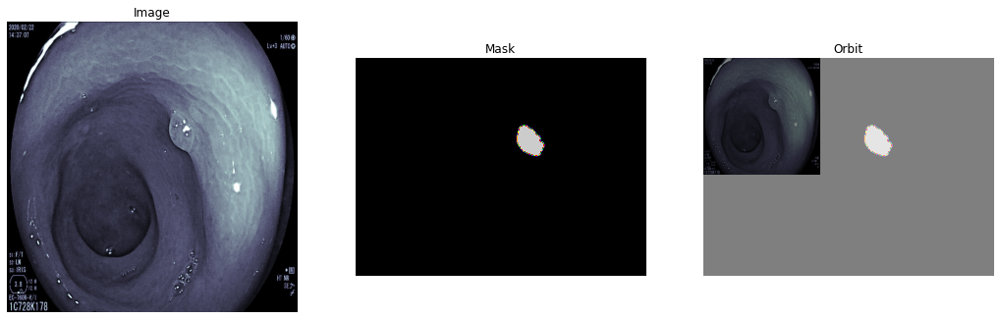

 94%|██████████████████████████████████████▌  | 188/200 [01:16<00:04,  2.54it/s]

2 0


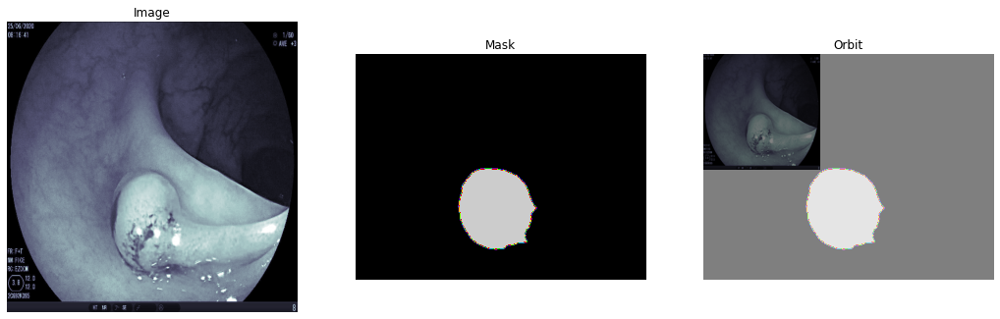

 94%|██████████████████████████████████████▋  | 189/200 [01:17<00:04,  2.52it/s]

2 0


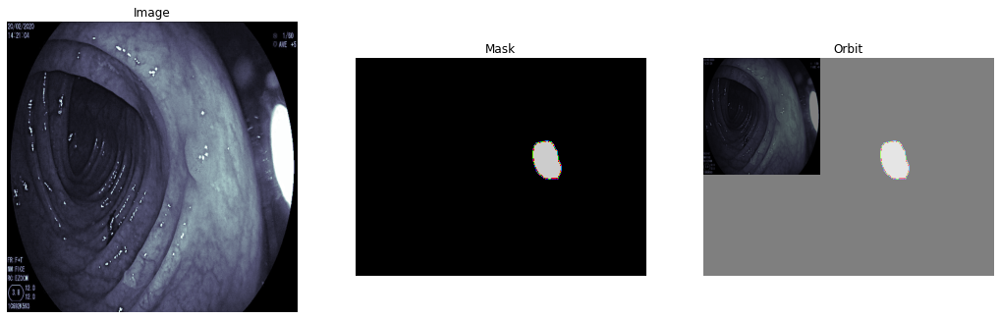

 95%|██████████████████████████████████████▉  | 190/200 [01:17<00:03,  2.54it/s]

2 0


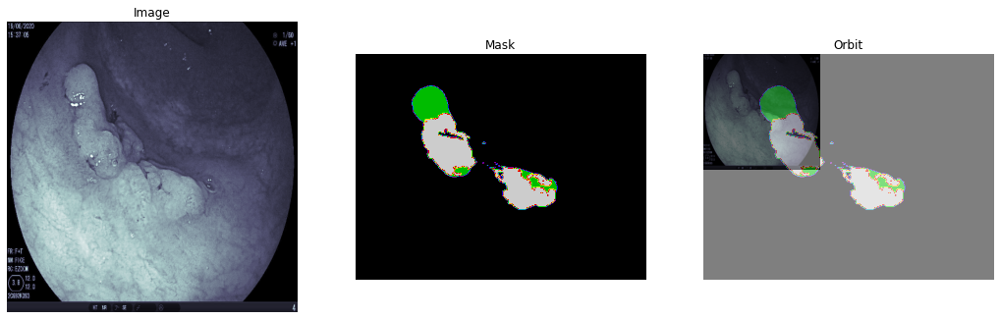

 96%|███████████████████████████████████████▏ | 191/200 [01:17<00:03,  2.54it/s]

2 0


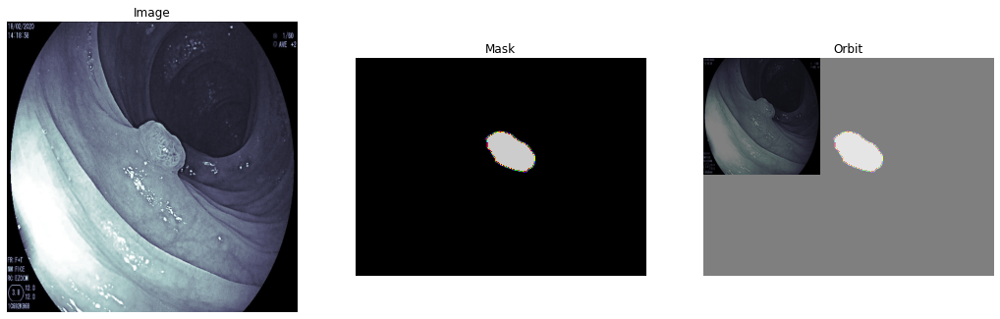

 96%|███████████████████████████████████████▎ | 192/200 [01:18<00:03,  2.55it/s]

2 0


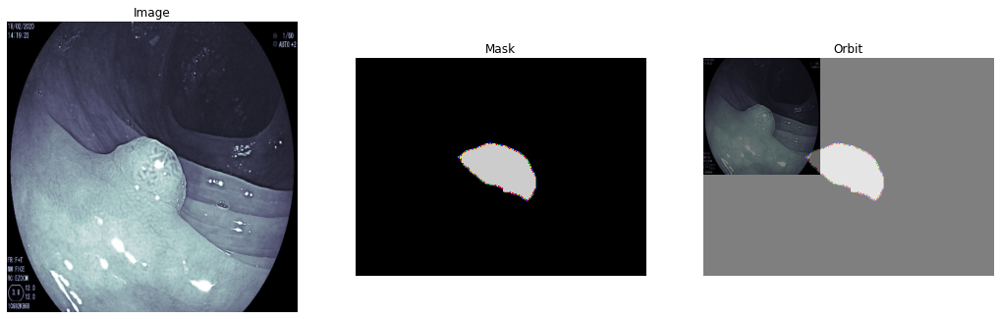

 96%|███████████████████████████████████████▌ | 193/200 [01:18<00:02,  2.55it/s]

2 0


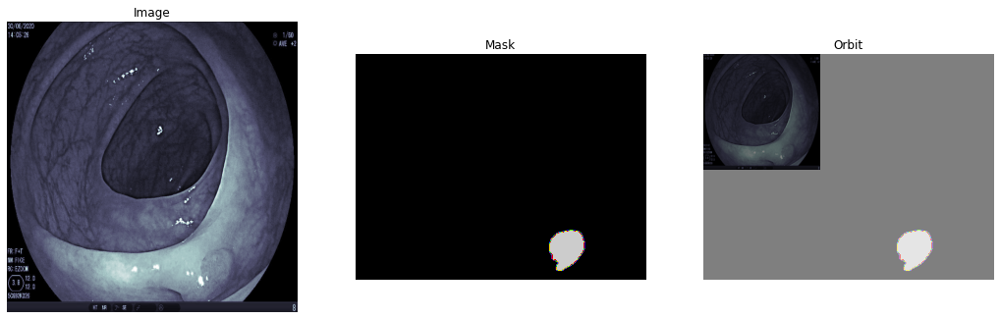

 97%|███████████████████████████████████████▊ | 194/200 [01:18<00:02,  2.54it/s]

1 0


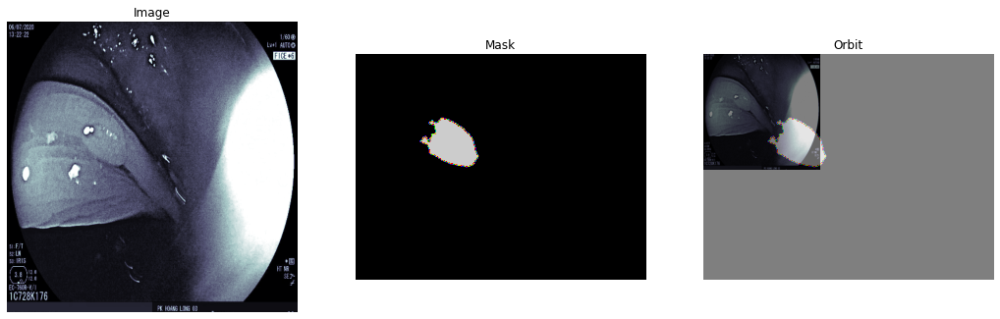

 98%|███████████████████████████████████████▉ | 195/200 [01:19<00:01,  2.54it/s]

2 0


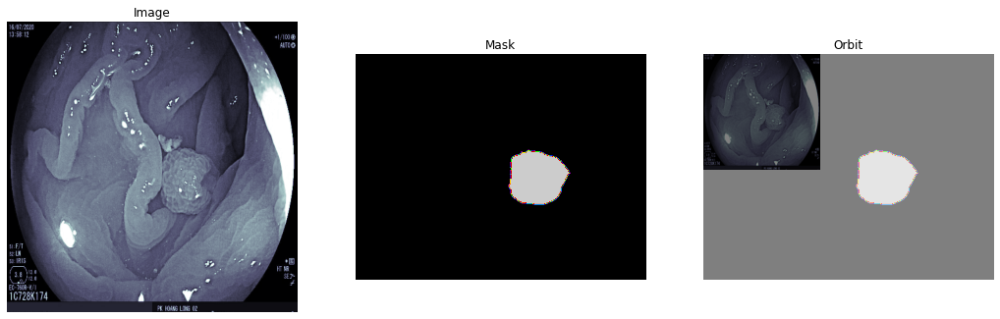

 98%|████████████████████████████████████████▏| 196/200 [01:19<00:01,  2.53it/s]

1 0


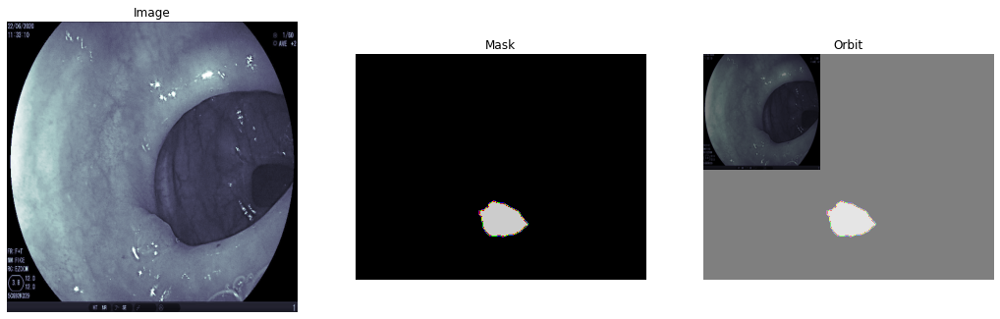

 98%|████████████████████████████████████████▍| 197/200 [01:20<00:01,  2.53it/s]

2 0


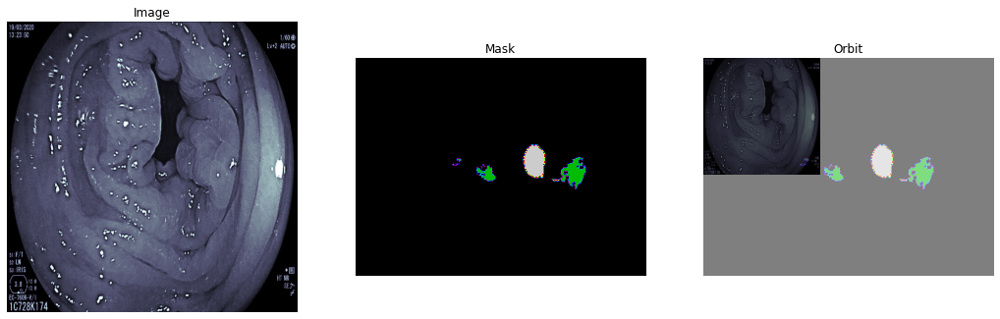

 99%|████████████████████████████████████████▌| 198/200 [01:20<00:00,  2.52it/s]

2 0


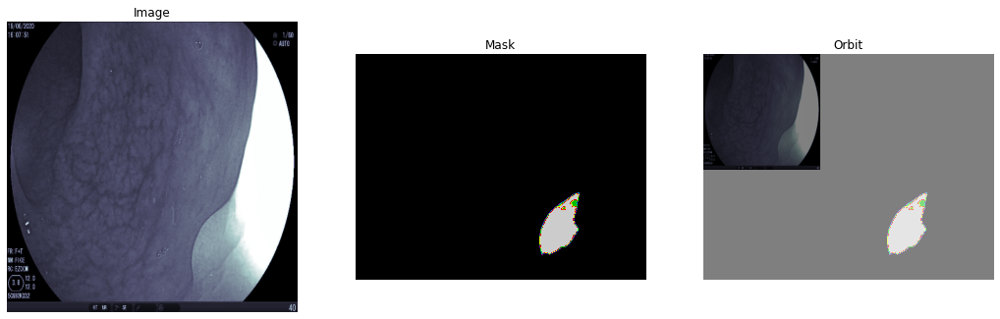

100%|████████████████████████████████████████▊| 199/200 [01:21<00:00,  2.15it/s]

2 0


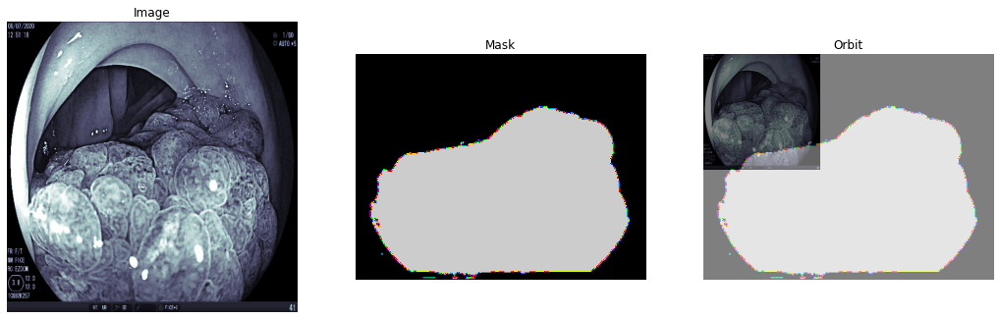

100%|█████████████████████████████████████████| 200/200 [01:21<00:00,  2.45it/s]


In [63]:
from tqdm import tqdm
test_images = [os.path.join('test/test/', f'{x}') for x in os.listdir(
'test/test')]
for image in tqdm(test_images):
    x = read_image(image)
    p = mobilenetv2_unet.predict(np.expand_dims(x, axis=0))[0]
    p = np.argmax(p, axis=-1)
    p = cv2.imread("result/"+image.split("/")[-1].split(".")[0]+".png")
    p = np.argmax(p, axis=-1)
    print(np.max(p),np.min(p))
    show_example(x, p)